<a href="https://colab.research.google.com/github/vishwaraghava009/Stock-Data-Analysis/blob/main/Stock_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Stock Data Analysis

>This notebook is an attempt to analyze the stock data using the yfinance library.

The workflow we are gonna be following is:


1. Installing and Importing the required Libraries and Directories.
2. Fetch the stocks data.
3. Data Preprocessing.
4. Creating additional features from the existing data.
5. Data Analysis.
6. Modeling.
7. Predictions.
8. Evaluation.
9. Summary.



All right! Lot to analyze! Without any delay let's install and import the `yfinance` library along with other required libraries. It's not pre-installed in Colab because it's basically, a library designed for the language `R`.

## 1. Importing Libraries.

In [ ]:
!pip install yfinance
!pip install ta
!pip install tfcausalimpact

In [2]:
import yfinance as yf
import ta
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from causalimpact import CausalImpact
from prophet import Prophet
from sklearn.metrics import mean_squared_error, mean_absolute_error
from prophet.diagnostics import cross_validation
from prophet.plot import plot_cross_validation_metric
from sklearn.model_selection import ParameterGrid

## 2. Fetch Data.

We are gonna download the following stocks belonging to the respective sectors,
> Technology Stocks:
* Apple Inc. (AAPL)
* Microsoft Corporation (MSFT)
* Amazon.com, Inc. (AMZN)
* Alphabet Inc. (GOOGL)
* META, Inc. (META)
* NVIDIA Corporation (NVDA)
* Netflix, Inc. (NFLX)

> Finance Stocks:
* JPMorgan Chase & Co. (JPM)
* Bank of America Corporation (BAC)
* Wells Fargo & Company (WFC)
* Goldman Sachs Group, Inc. (GS)
* Morgan Stanley (MS)
* American Express Company (AXP)
* Mastercard Incorporated (MA)

> Retail Stocks:
* Amazon.com, Inc. (AMZN)
* Walmart Inc. (WMT)
* Lowe's Companies, Inc. (LOW)
* Nike, Inc. (NKE)
* McDonald's Corporation (MCD)
* Starbucks Corporation (SBUX)

> Healthcare Stocks:
* Johnson & Johnson (JNJ)
* Pfizer Inc. (PFE)
* Merck & Co., Inc. (MRK)
* Amgen Inc. (AMGN)
* Gilead Sciences, Inc. (GILD)
* Bristol-Myers Squibb Company (BMY)
* Eli Lilly and Company (LLY)

> Automobile Stocks:
* Tesla, Inc. (TSLA)
* Ford Motor Company (F)
* Toyota Motor Corporation (TM)
* Honda Motor Co., Ltd. (HMC)
* BMW AG (BMWYY)
* Volkswagen AG (VWAGY)
* Hyundai Motor Company (HYMTF)


But before downloading let's decide about the timeframe for downloading the data. As we are going to analyse a lot of things, having a long timeframe is an ideal thing to do. So, let's download the data from `2015-01-01` to `2023-01-01`.

In [3]:
start_stock = "2015-01-01"
end_stock = "2023-01-01"

And download!

In [4]:
#sector wise stock tickers
tech_tickers = ['AAPL', 'MSFT', 'AMZN', 'GOOGL', 'META', 'NVDA', 'NFLX']
fin_tickers = ['JPM', 'BAC', 'WFC', 'GS', 'MS', 'AXP', 'MA']
retail_tickers = ['WMT', 'LOW', 'NKE', 'MCD', 'SBUX']
health_tickers = ['JNJ', 'PFE', 'MRK', 'AMGN', 'GILD', 'BMY', 'LLY']
autom_tickers = ['TSLA', 'F','TM', 'HMC', 'BMWYY', 'VWAGY', 'HYMTF']

let's first download stock data of one ticker to just see what get's downloaded.

In [5]:
X = yf.download(tickers = 'AAPL',
                start = start_stock,
                end = end_stock,
                interval = "1d")
X.head()

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2015-01-02,27.847500,27.860001,26.837500,27.332500,24.531769,212818400
2015-01-05,27.072500,27.162500,26.352501,26.562500,23.840666,257142000
2015-01-06,26.635000,26.857500,26.157499,26.565001,23.842909,263188400
2015-01-07,26.799999,27.049999,26.674999,26.937500,24.177238,160423600
2015-01-08,27.307501,28.037500,27.174999,27.972500,25.106190,237458000


Cool! we can see quite a few KPI's out of which we consider only the `Adj Close` KPI. It's more reasonable to analyze `Adj. Close` than `Close` because `Adj Close` is the closing price after adjustments for all applicable splits and dividend distributions.

So, let's only get the data for `Adj  Close`.

In [6]:
def download_data(tickers):
  """
  this function takes list of tickers to download and store it in a dataframe
  """
  #dataframe to store the stock data for a ticker list
  df = pd.DataFrame()

  # Iterate over each ticker
  for ticker in tickers:
      data = yf.download(ticker,
                         start=start_stock,
                         end=end_stock,
                         interval="1d")

      adj_close = data['Adj Close']

      # Add the Adj column to the corresponding ticker column
      ticker_df = pd.DataFrame({ticker: adj_close})
      ticker_df.columns = pd.MultiIndex.from_product([[ticker], ['Adj Close']])
      df = pd.concat([df, ticker_df], axis=1)

  # Reset the index of the dataframe
  df.reset_index(inplace=True)

  return df


In [7]:
tech_df = download_data(tech_tickers)
fin_df = download_data(fin_tickers)
retail_df = download_data(retail_tickers)
health_df = download_data(health_tickers)
autom_df = download_data(autom_tickers);

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

All ready! Data has been downloaded! Now, let's visualize a DataFrame.

In [8]:
tech_df.set_index("Date", inplace=True)
fin_df.set_index("Date", inplace=True)
retail_df.set_index("Date", inplace=True)
health_df.set_index("Date", inplace=True)
autom_df.set_index("Date", inplace=True)

In [9]:
autom_df.head()

,TSLA,F,TM,HMC,BMWYY,VWAGY,HYMTF
,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close
Date,,,,,,,
2015-01-02,14.620667,10.062555,118.139427,24.785105,22.876278,16.460857,56.750000
2015-01-05,14.006000,9.669488,115.977249,24.274157,21.949038,15.838782,56.500000
2015-01-06,14.085333,9.577771,114.783348,24.140139,21.987944,16.012119,55.270000
2015-01-07,14.063333,9.852919,117.669388,24.383049,22.201923,16.096861,56.200001
2015-01-08,14.041333,10.101863,119.934975,24.692963,22.759562,16.505154,57.250000


Well! we are done with the data fecthing step, Now, let's move to the next step of preprocessing the data.

## 3. Data Pre-processing

For processing we'll look for,
* Missing values and update them by using `forward fill`.
* Consistent data formats across the columns.

First, the missing values!

In [10]:
tech_df = tech_df.fillna(method='ffill')
fin_df = fin_df.fillna(method='ffill')
retail_df = retail_df.fillna(method='ffill')
health_df = health_df.fillna(method='ffill')
autom_df = autom_df.fillna(method='ffill')

In [11]:
tech_df.head()

,AAPL,MSFT,AMZN,GOOGL,META,NVDA,NFLX
,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close
Date,,,,,,,
2015-01-02,24.531765,40.620659,15.4260,26.477501,78.449997,4.833627,49.848572
2015-01-05,23.840666,40.247135,15.1095,25.973000,77.190002,4.751987,47.311428
2015-01-06,23.842911,39.656403,14.7645,25.332001,76.150002,4.607913,46.501431
2015-01-07,24.177242,40.160248,14.9210,25.257500,76.150002,4.595908,46.742859
2015-01-08,25.106182,41.341702,15.0230,25.345501,78.180000,4.768796,47.779999


Okay! Now, making sure that the data format is consistent.

In [12]:
dataframes = [tech_df, fin_df, retail_df, health_df, autom_df]

#iterate over the dataframes
for df in dataframes:
  # date format
  df.index = pd.to_datetime(df.index)

  # Iterate over the columns except 'Date'
  for column in df.columns[1:]:
      df[column] = df[column].astype(float)

In [13]:
fin_df.head()

,JPM,BAC,WFC,GS,MS,AXP,MA
,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close
Date,,,,,,,
2015-01-02,49.547649,15.146551,42.824726,166.146393,31.255281,81.897903,81.266785
2015-01-05,48.009445,14.706537,41.650383,160.958862,30.278303,79.732033,78.980904
2015-01-06,46.764610,14.266529,40.781353,157.702744,29.406288,78.032799,78.810181
2015-01-07,46.835968,14.334219,41.024055,160.052994,29.826149,79.737038,80.036110
2015-01-08,47.882591,14.630383,41.932232,162.608292,30.270220,80.867317,81.280991


Alright! Let's look for additional features from the existing data.

## 4. Feature Engineering

### Lagged Returns.

To observe the historical dependencies, let's add the lagged Adj Close values for ecah ticker.

In [14]:
#dictionary for all sector dfs
all_dfs = {
    'tech': tech_df,
    'finance': fin_df,
    'retail': retail_df,
    'health': health_df,
    'autom': autom_df
}

In [15]:
# 1 represents that we are considering just the previous day stock values
lag_periods = 1

for sector, df in all_dfs.items():
  for ticker in df.columns.get_level_values(0):

    adj_close = df.xs(("Adj Close"), axis=1, level=1, drop_level=False)[ticker]

    # lagged values of each adj close value
    lagged_returns = adj_close.pct_change(periods=lag_periods)

    # Adding the Lagged_Returns column to each dataframe
    insert_index = df.columns.get_loc((ticker, 'Adj Close')) + 1
    df.insert(insert_index, (ticker, 'Lagged_Returns'), lagged_returns)

    #empty values of day 1
    df.iloc[0, insert_index] = 0

The `pct_change()` method calculates the percentage change between the current and lagged values of `Adj Close`.

In [16]:
retail_df.head()

WMT                       LOW                       NKE  \
            Adj Close Lagged_Returns  Adj Close Lagged_Returns  Adj Close   
Date                                                                        
2015-01-02  71.685661       0.000000  58.294888       0.000000  43.370159   
2015-01-05  71.477043      -0.002910  56.899944      -0.023929  42.671879   
2015-01-06  72.027809       0.007705  57.029110       0.002270  42.420883   
2015-01-07  73.938889       0.026533  58.725418       0.029745  43.297138   
2015-01-08  75.499443       0.021106  59.965378       0.021115  44.296619   

                                 MCD                      SBUX                 
           Lagged_Returns  Adj Close Lagged_Returns  Adj Close Lagged_Returns  
Date                                                                           
2015-01-02       0.000000  74.915817       0.000000  34.774391       0.000000  
2015-01-05      -0.016100  74.088440      -0.011044  34.108280      -0.019155  
2015-01-06      -0.005882  74.224998       0.001843  33.830730      -0.008137  
2015-01-07       0.020656  75.518303       0.017424  34.663357       0.024612  
2015-01-08       0.023084  75.799438       0.003723  35.222733       0.016137

The Lagged_Returns values are `0` for the day 1 because there is no previous day stock values available.

Okay! Now we've got our data ready in dataFrames for ecah sector. But we might need a dataframe which has all the data. So, let's create dataframe which holds all the data.

In [17]:
combined_df = pd.concat([tech_df, fin_df, retail_df, health_df, autom_df], axis=1)
combined_df.head()

AAPL                      MSFT                     AMZN  \
            Adj Close Lagged_Returns  Adj Close Lagged_Returns Adj Close   
Date                                                                       
2015-01-02  24.531765       0.000000  40.620659       0.000000   15.4260   
2015-01-05  23.840666      -0.028172  40.247135      -0.009195   15.1095   
2015-01-06  23.842911       0.000094  39.656403      -0.014678   14.7645   
2015-01-07  24.177242       0.014022  40.160248       0.012705   14.9210   
2015-01-08  25.106182       0.038422  41.341702       0.029418   15.0230   

                               GOOGL                      META                 \
           Lagged_Returns  Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date                                                                            
2015-01-02       0.000000  26.477501       0.000000  78.449997       0.000000   
2015-01-05      -0.020517  25.973000      -0.019054  77.190002      -0.016061   
2015-01-06      -0.022833  25.332001      -0.024679  76.150002      -0.013473   
2015-01-07       0.010600  25.257500      -0.002941  76.150002       0.000000   
2015-01-08       0.006836  25.345501       0.003484  78.180000       0.026658   

            ...          TM                       HMC                 \
            ...   Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date        ...                                                        
2015-01-02  ...  118.139427       0.000000  24.785105       0.000000   
2015-01-05  ...  115.977249      -0.018302  24.274157      -0.020615   
2015-01-06  ...  114.783348      -0.010294  24.140139      -0.005521   
2015-01-07  ...  117.669388       0.025143  24.383049       0.010063   
2015-01-08  ...  119.934975       0.019254  24.692963       0.012710   

                BMWYY                     VWAGY                     HYMTF  \
            Adj Close Lagged_Returns  Adj Close Lagged_Returns  Adj Close   
Date                                                                        
2015-01-02  22.876278       0.000000  16.460857       0.000000  56.750000   
2015-01-05  21.949038      -0.040533  15.838782      -0.037791  56.500000   
2015-01-06  21.987944       0.001773  16.012119       0.010944  55.270000   
2015-01-07  22.201923       0.009732  16.096861       0.005292  56.200001   
2015-01-08  22.759562       0.025117  16.505154       0.025365  57.250000   

                           
           Lagged_Returns  
Date                       
2015-01-02       0.000000  
2015-01-05      -0.004405  
2015-01-06      -0.021770  
2015-01-07       0.016826  
2015-01-08       0.018683  

[5 rows x 66 columns]

### Technial Indicators (RSI, MACD, Bollinger Bands)

* **Relative Strength Index, RSI,** measures the speed and change of price up and downs. So,  basically we can onserve the overbought or oversold conditions.

* **Moving Average Convergence Divergence, MACD,** shows the relationship between two moving averges.

* **Bollinger Bands** represents avergare price over a specified period through SMA and standard deviatuions from SMA by two lines. Basically, we acn identify the periods of low voilatility and breakouts.

Oh! Wait! we have to import the `ta` library.

In [18]:
#empty DataFrame to store the attribute values
attribute_df = pd.DataFrame()

for sector, df in all_dfs.items():

  tickers = df.columns.get_level_values(0).unique()

  for ticker in tickers:
    adj_close = df[(ticker, 'Adj Close')]

    #RSI indicator
    rsi = ta.momentum.RSIIndicator(adj_close).rsi()

    #MACD indicator
    macd = ta.trend.MACD(adj_close)
    macd_line = macd.macd()
    macd_signal_line = macd.macd_signal()
    macd_histogram = macd.macd_diff()

    #Bollinger Bands
    bollinger_bands = ta.volatility.BollingerBands(adj_close)
    sma = bollinger_bands.bollinger_mavg()
    upper_band = bollinger_bands.bollinger_hband()
    lower_band = bollinger_bands.bollinger_lband()

    # DataFrame to store the attribute values of each the ticker
    ticker_df = pd.DataFrame({
        'RSI': rsi,
        'MACD_Line': macd_line,
        'MACD_Signal': macd_signal_line,
        'MACD_Histogram': macd_histogram,
        'SMA': sma,
        'Upper_Band': upper_band,
        'Lower_Band': lower_band})

    #MultiIndex DataFrame with ticker and sectors
    ticker_df.columns = pd.MultiIndex.from_product([[ticker], ticker_df.columns])

    # Concatenate to the attribute DataFrame
    attribute_df = pd.concat([attribute_df, ticker_df], axis=1)

In [19]:
attribute_df.head()

AAPL                                                      \
            RSI MACD_Line MACD_Signal MACD_Histogram SMA Upper_Band   
Date                                                                  
2015-01-02  NaN       NaN         NaN            NaN NaN        NaN   
2015-01-05  NaN       NaN         NaN            NaN NaN        NaN   
2015-01-06  NaN       NaN         NaN            NaN NaN        NaN   
2015-01-07  NaN       NaN         NaN            NaN NaN        NaN   
2015-01-08  NaN       NaN         NaN            NaN NaN        NaN   

                      MSFT                        ... VWAGY             \
           Lower_Band  RSI MACD_Line MACD_Signal  ...   SMA Upper_Band   
Date                                              ...                    
2015-01-02        NaN  NaN       NaN         NaN  ...   NaN        NaN   
2015-01-05        NaN  NaN       NaN         NaN  ...   NaN        NaN   
2015-01-06        NaN  NaN       NaN         NaN  ...   NaN        NaN   
2015-01-07        NaN  NaN       NaN         NaN  ...   NaN        NaN   
2015-01-08        NaN  NaN       NaN         NaN  ...   NaN        NaN   

                      HYMTF                                           \
           Lower_Band   RSI MACD_Line MACD_Signal MACD_Histogram SMA   
Date                                                                   
2015-01-02        NaN   NaN       NaN         NaN            NaN NaN   
2015-01-05        NaN   NaN       NaN         NaN            NaN NaN   
2015-01-06        NaN   NaN       NaN         NaN            NaN NaN   
2015-01-07        NaN   NaN       NaN         NaN            NaN NaN   
2015-01-08        NaN   NaN       NaN         NaN            NaN NaN   

                                  
           Upper_Band Lower_Band  
Date                              
2015-01-02        NaN        NaN  
2015-01-05        NaN        NaN  
2015-01-06        NaN        NaN  
2015-01-07        NaN        NaN  
2015-01-08        NaN        NaN  

[5 rows x 231 columns]

We could see quite a lot attributes in here, we can see about them later in the data analysis section.

Here, we could see the starting few Values of RSI, MACD, Bollinger bands are `NaN`, because they require a sufficient number of preceding periods to calculate the indicators accurately, and the initial data points do not have enough information for the calculations.

## 5. Data Anaysis.

### Sectors Comaparision

Firstly, Let's see the average prices of each sector compared with each other.

The average stock price is the `Adj Close` mean value of all the stocks of a particular sector.

In [20]:
sector_avg = pd.DataFrame()

for sector, df in all_dfs.items():

  tickers = df.columns.get_level_values(0).unique()

  sector_data = df[tickers].mean(axis=1)   #axis=1 represents teh Adj Close column

  dates = df.index
  sector_avg[sector] = sector_data

# Adding 'Date' column to the sector_avg df
sector_avg.insert(0, 'Date', dates)

sector_avg.head()


,Date,tech,finance,retail,health,autom
Date,,,,,,
2015-01-02,2015-01-02,17.156294,33.434664,28.304092,32.142959,18.835349
2015-01-05,2015-01-05,16.733067,32.436564,27.917245,32.037783,18.429426
2015-01-06,2015-01-06,16.480868,31.829663,27.953133,31.919403,18.273426
2015-01-07,2015-01-07,16.574409,32.280381,28.626207,32.557293,18.611550
2015-01-08,2015-01-08,16.979272,32.828411,29.086878,33.003787,18.957906


Okay, so it's time to visualize the sector wise average stock prices.

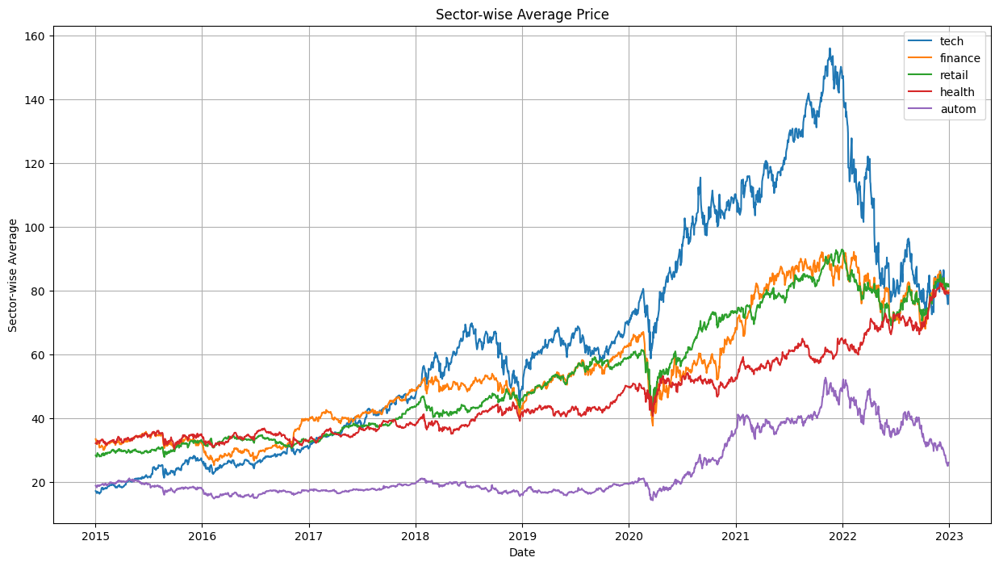

In [21]:
plt.figure(figsize=(15, 8))

for sector in sector_avg.columns[1:]:
  plt.plot(sector_avg.index, sector_avg[sector], label=sector)

plt.xlabel('Date')
plt.ylabel('Sector-wise Average')
plt.title('Sector-wise Average Price')
plt.legend()
plt.grid(True)
plt.show()


Alright! We got our sector-wise average price plot ready! Let's anlyse it.
* We could clearly see the dominance of tech sector over every other sector in the recent times (2018-2022). We could also see the prominance of tech secor has been increased since 2018. Before 2018 and around 2015 the tech sector was one of the least valued secotr.

* Finance and Retail are the next most valued sectors, in terms of stock prices. We could aslo see that these two sectors were always having a higher stock prices compared to other sectors from 2015 itself.

* Next comes the Health sector which used to have the highest value around the year 2015. And in the rece nt yars we could clearly see it's value is in the mediocre range.

* Then the Auto-mobile sector which is having considerbly low stock value from 2015 itself.

* Every sector has seen a sudden drop in the early Covid timeframe (~ mid 2020).

* We could also observe a good increase corresponding to every sector in the post-Covid timeframe.

* By analysing the plot, one thing which we can observe is that the growth or the fall of almoist every sector is in a similar trend with evry other sector. We can observe this in a more detailed model in the further anlysis by plotting correlation matrix between the sectors.

### Correlation Matrices

Okay! Now, let's look for any correlations between stocks of each sector.

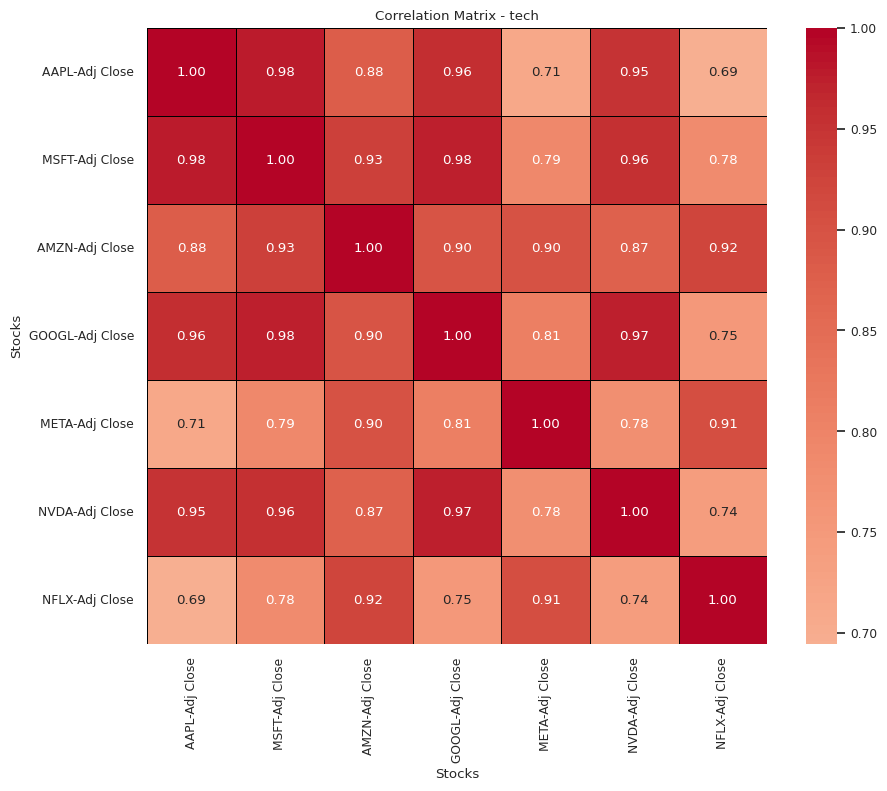

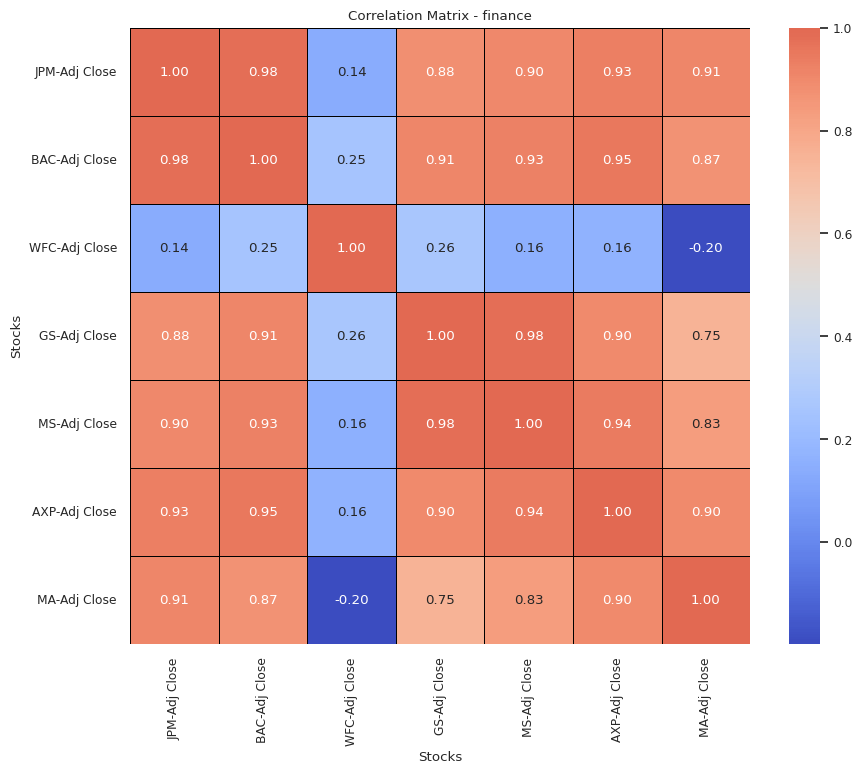

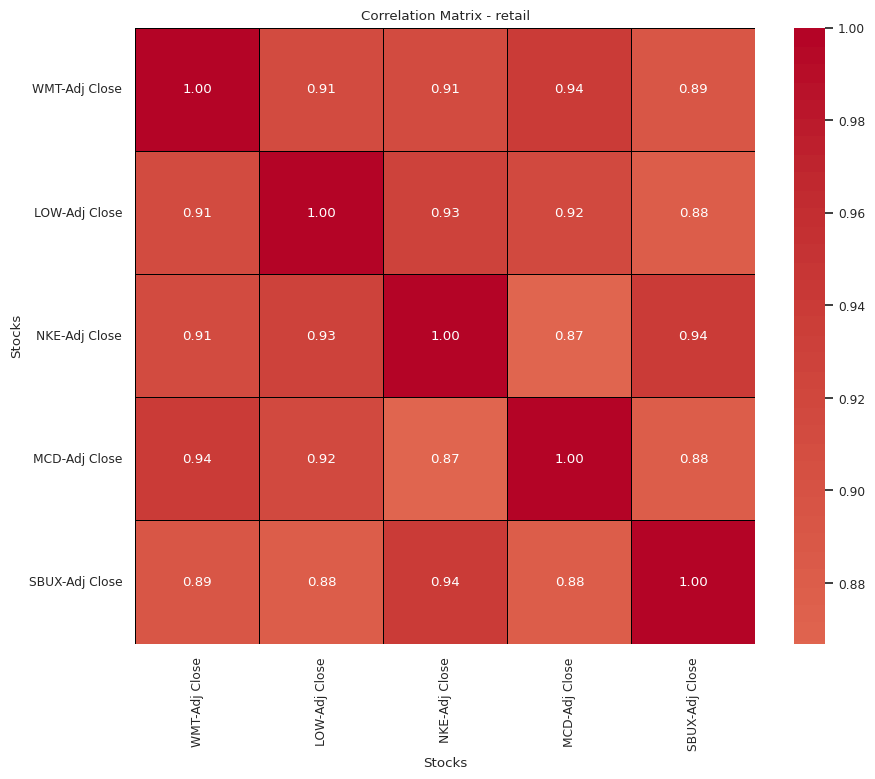

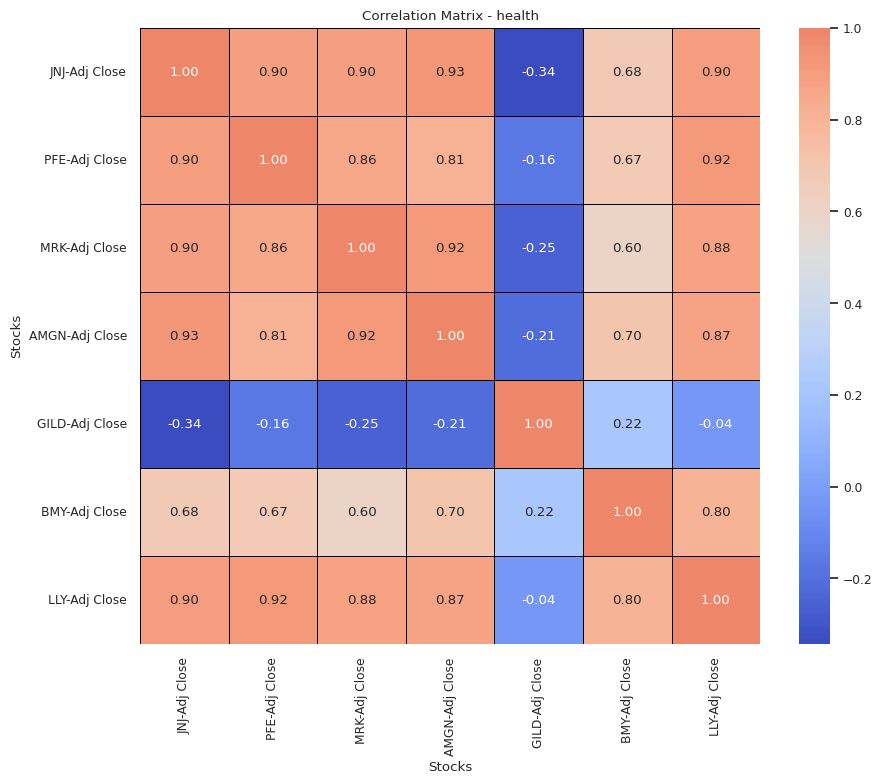

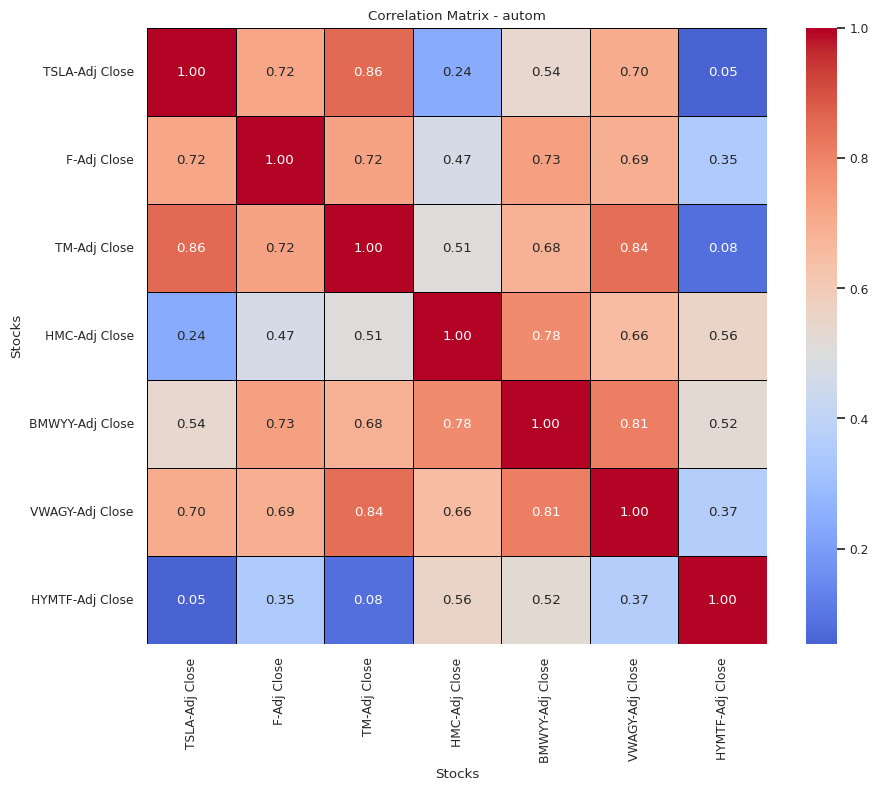

In [22]:
# to store correlation matrices of each sector, we may need them somewhere in the further analysis
sector_correlation_matrices = {}

for sector, df in all_dfs.items():
  #columns that include only 'Adj Close' values
  adj_close_columns = [(ticker, 'Adj Close') for ticker in df.columns.get_level_values(0).unique()]
  sector_df = df.loc[:, adj_close_columns]

  #correlation matrix
  correlation_matrix = sector_df.corr()
  sector_correlation_matrices[sector] = correlation_matrix

  #Plot the correlation matrix as a heatmap
  plt.figure(figsize=(10, 8))
  sns.set(font_scale=0.8)
  sns.heatmap(correlation_matrix,
              annot=True,
              fmt='.2f',
              center=0.5,
              cmap='coolwarm',
              linewidths=0.5,
              linecolor='black')
  plt.title(f'Correlation Matrix - {sector}')
  plt.xlabel('Stocks')
  plt.ylabel('Stocks')
  plt.xticks(rotation=90)
  plt.yticks(rotation=0)
  plt.show()


So, by observing the abve correlation matrices we can say that,

* Almost, each stock is highly and postively correlated with every other stock of the same sector. We can see how strongly the stocks from tech and retail sectors are correlated with the stocks from their respective sectors.

* In sectors like Finance, helath and automobile, we can see a few outliers which are weakly correlated or negatively correlated with other stocks like,
  - WFC from finance
  - GILD from health
  - HYMTF from automobile

* One thing that we can deduce is the stock values are possibly always correlated with the sector.

As said before, let;s looma t the correlation matrix of Sectror-wise average stock values.

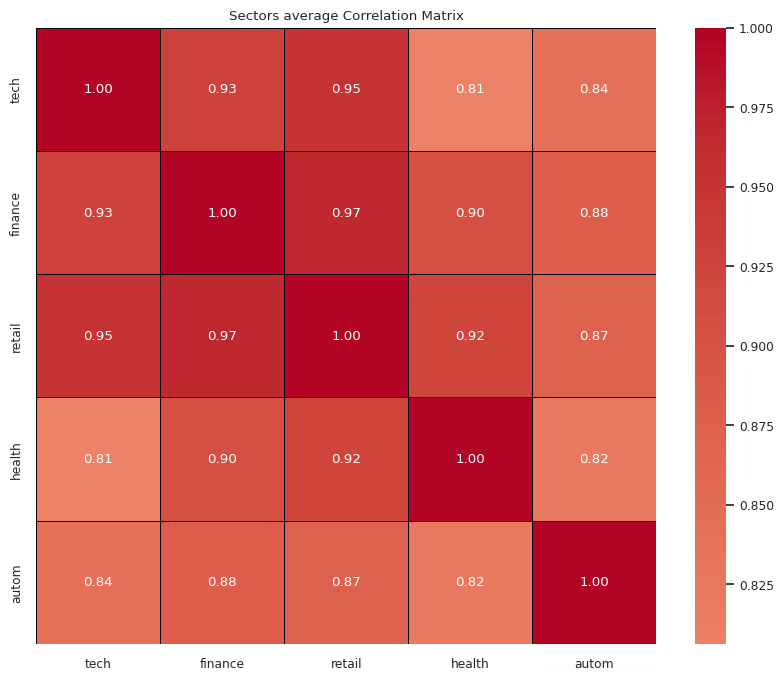

In [23]:
#correlation matrix
correlation_matrix = sector_avg.iloc[:, 1:].corr()

#correlation matrix as a heatmap
plt.figure(figsize=(10, 8))
sns.set(font_scale=0.8)
sns.heatmap(correlation_matrix,
            annot=True,
            fmt='.2f',
            center=0.5,
            cmap='coolwarm',
            linewidths=0.5,
            linecolor='black')
plt.title('Sectors average Correlation Matrix')
plt.show()


No Surprise! Because we've seen the plot of comparision between the average stock values of each sector. Where we have seen the same pattern for each sector, which eventually made the sectors correlated.

We have also seen that the automobile sector was, kind of, performing a bit different from ther sectors, which can also be reflected in here, the correlation matrix.

Finance and retail are stronly correlated than any other stocks which can be seen in the plot as well.

### Lagged_Returns

Okay, Now we have done some feature engineering like getting lagged returns of the Adj close values of each stock. We can plot the lagged_returns values over a time priod of 2015 to 2023 for each stock of each sector. So the following plots take time to get processed and also look a liitle overwhelming, as there are quite a few stocks we've considered.

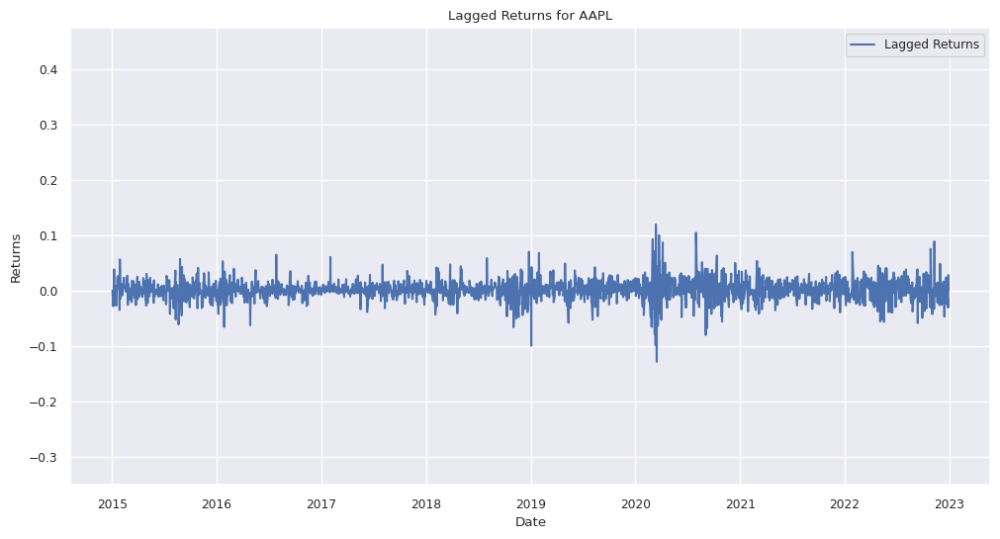

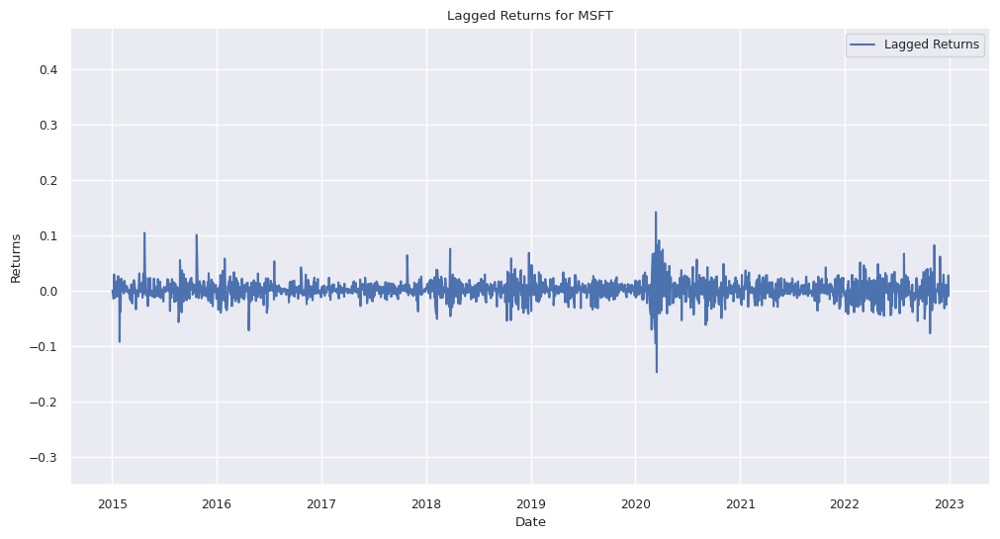

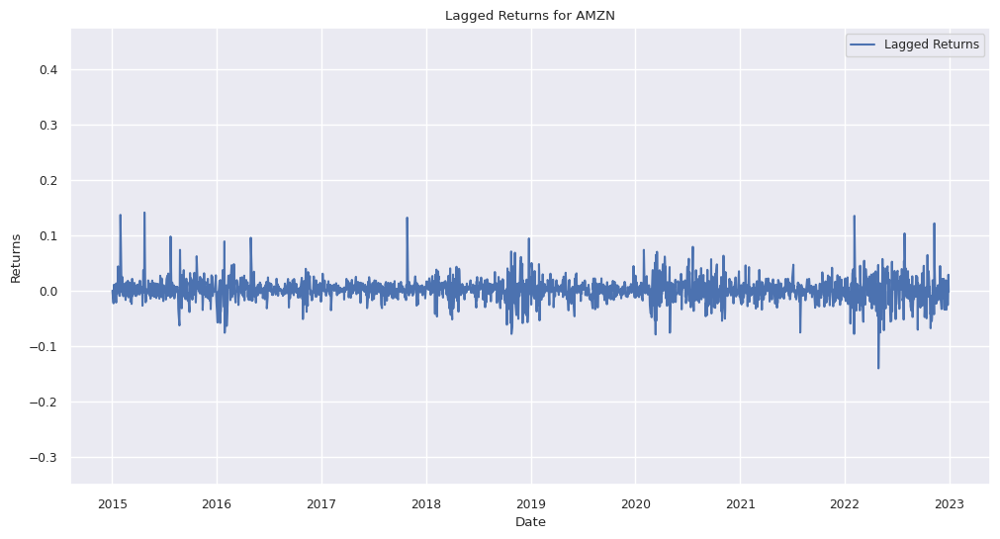

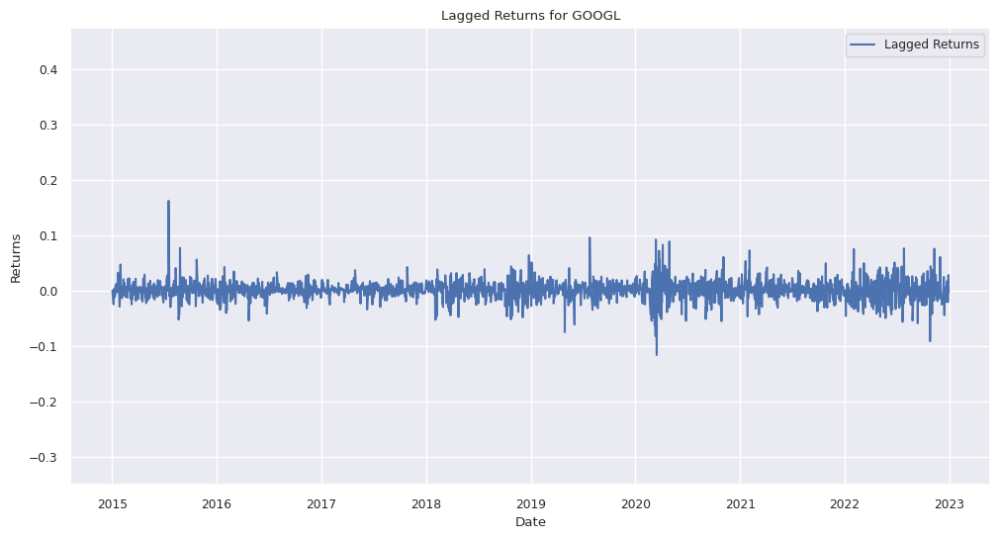

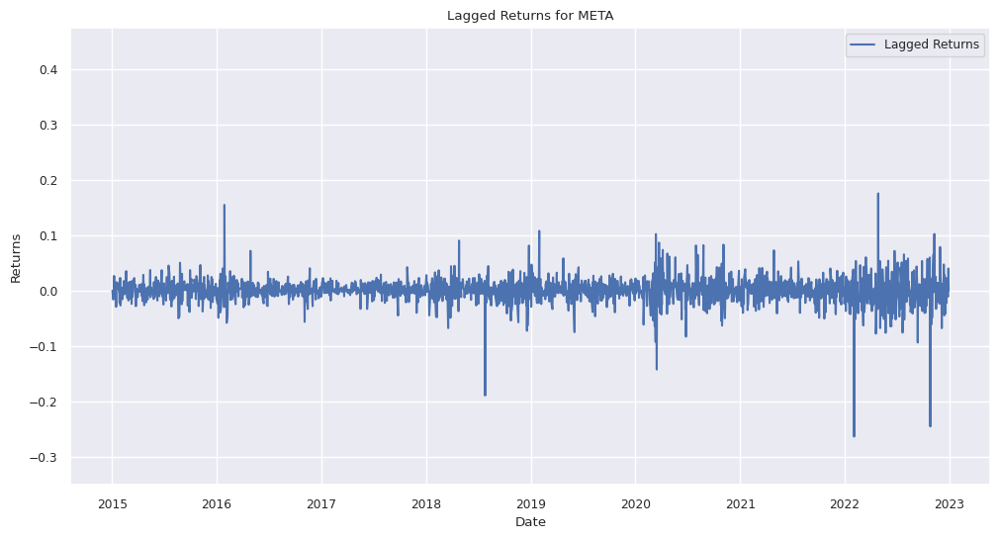

...

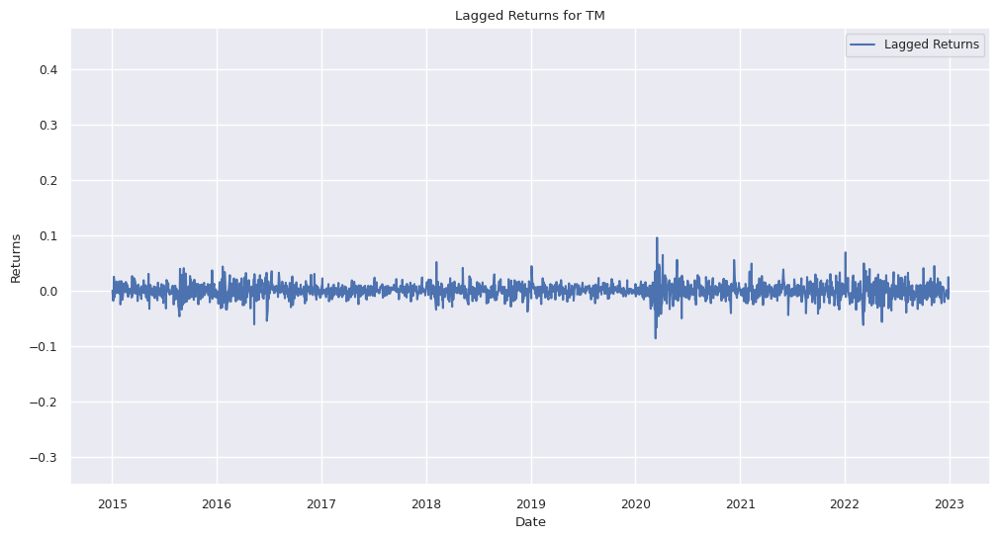

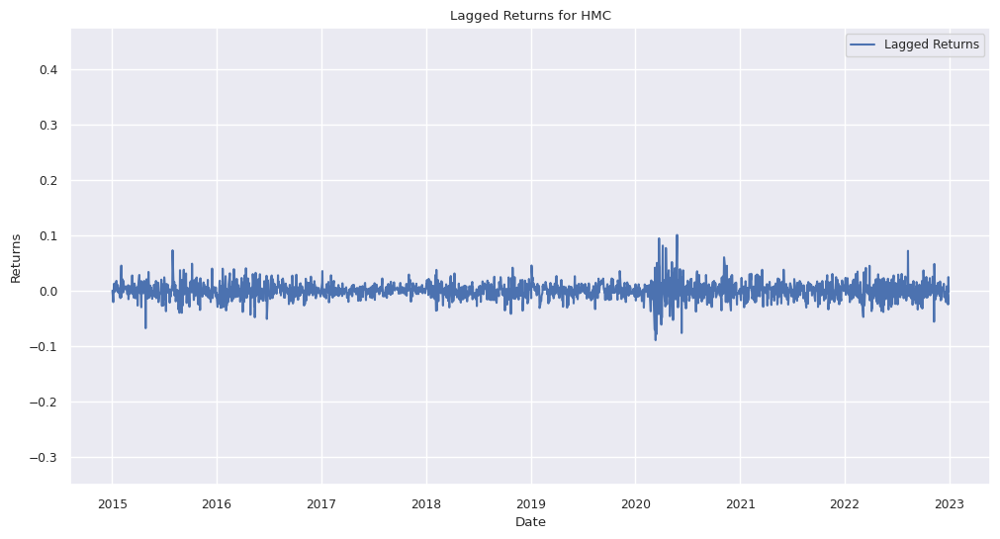

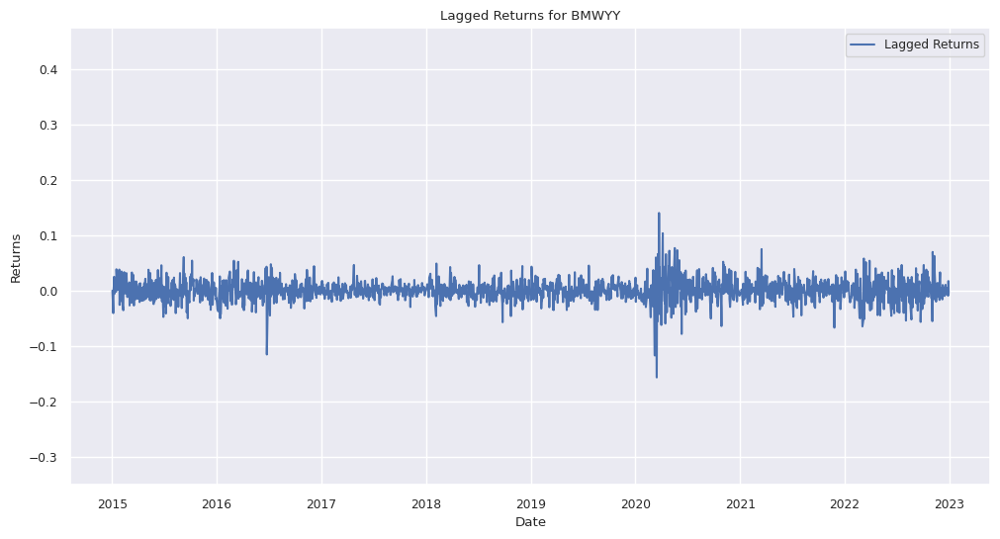

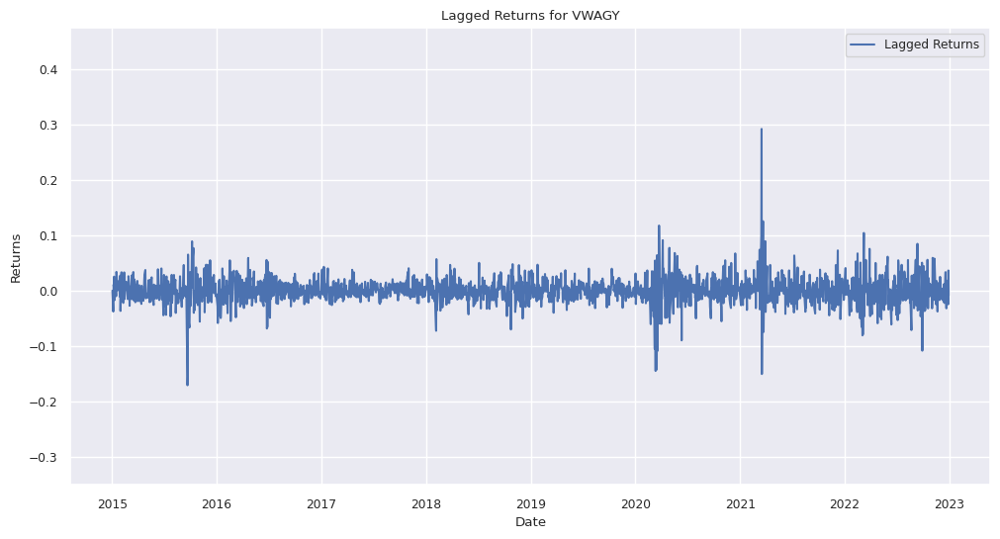

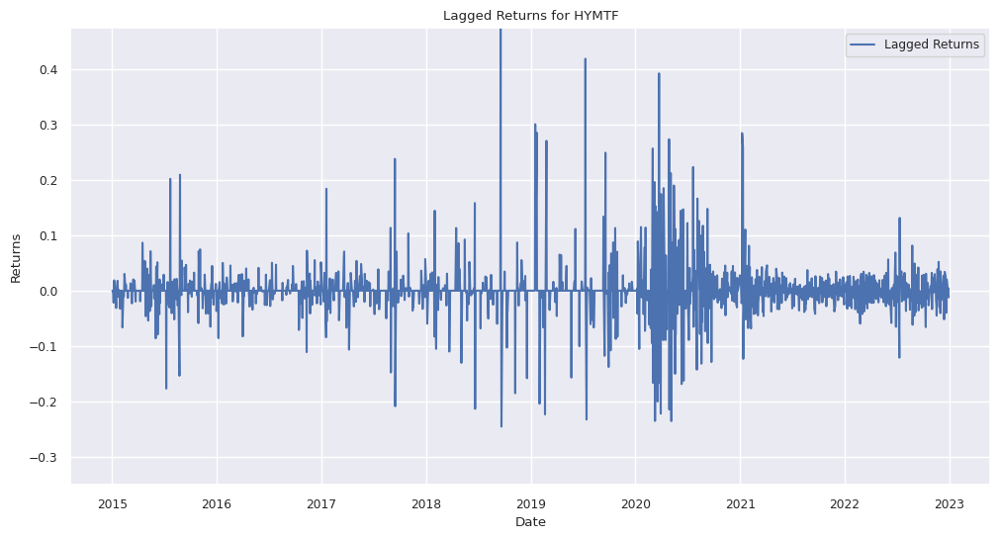

In [24]:
#storing the minimum and maximum lagged returns values to set y_lim
min_value = float('inf')
max_value = float('-inf')

for sector, df in all_dfs.items():
  for ticker in df.columns.get_level_values(0).unique():  #this time we have to iterate over ticker names to get plot for each ticker

      lagged_returns = df[(ticker, 'Lagged_Returns')]  #the lagged_returns values from the dataframe
      min_value = min(min_value, lagged_returns.min())
      max_value = max(max_value, lagged_returns.max())


y_range = (min_value, max_value)


for sector, df in all_dfs.items():
  for ticker in df.columns.get_level_values(0).unique():

      lagged_returns = df[(ticker, 'Lagged_Returns')]

      # Plot the Lagged Returns
      plt.figure(figsize=(12, 6))
      plt.plot(df.index, lagged_returns, label='Lagged Returns')
      plt.title(f'Lagged Returns for {ticker}')
      plt.xlabel('Date')
      plt.ylabel('Returns')
      plt.ylim(y_range)
      plt.legend()
      plt.grid(True)
      plt.show()


Yeah! Here we go! We can just plot these for few stocks or for a few sectors also.

> I've tried to create a plot for every stock, so that, I can go through every stock and  get a quick overview about the sector.
I've done the same in the futher analysis related to various other faetures.

Okay! Coming to anlysis part,

* First, Lagged_returns represents the historical performance of a stock. It, basically, represents the percentage change in the Adj Close values.

* Postive lagged return (postive part of the plot) represents the upwards trend in the stock value, which means the the stock has seen increase in its value compared to the previous day (because we've considered the lag period to be 1 day). Simillarly, Negative lagged return implies the downward trend.
  - We can see great postive lagged returns in case of NVDA and NFLX stock values during the 2015-2018 timeframe. But NFLX can be seen having downward trend during the year 2022.
  - The BMY, JNJ stocks have seen greater negative trend than the upward trend.

* By observing several plots, we could see that almost every stock has a regular upward and downwrds trend which implies that having such comsistent pattern results in sustained trend.

* Again, we could see a high lagged returns in the covid timeframe. There are very high postive and negative returns, i.e. fluctuations,  which implies the volatility of the stock in that particular timeframe. And also, having immediate high negative and positive returns can be tremed as Mean reversion, which means the stock tends to revert to its mean value after seeing immediate rise or fall in its value.
  - HYMMTF is a good example for hig voltility.

* Again, great upward trend and mean reversion can be seen sinificatly in case of tech sector. This can bee seen, kind of, related to the overall average sector performance.

How about lookin at the correlation between stocks off each sector based on the lagged returns. Yeah! let's do that.

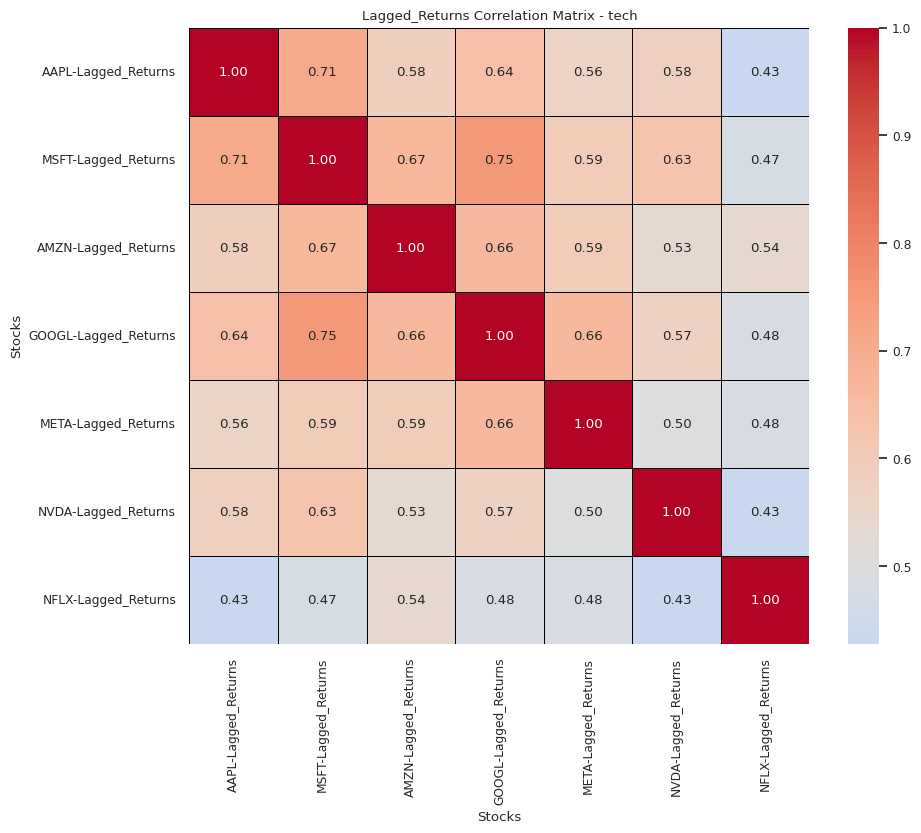

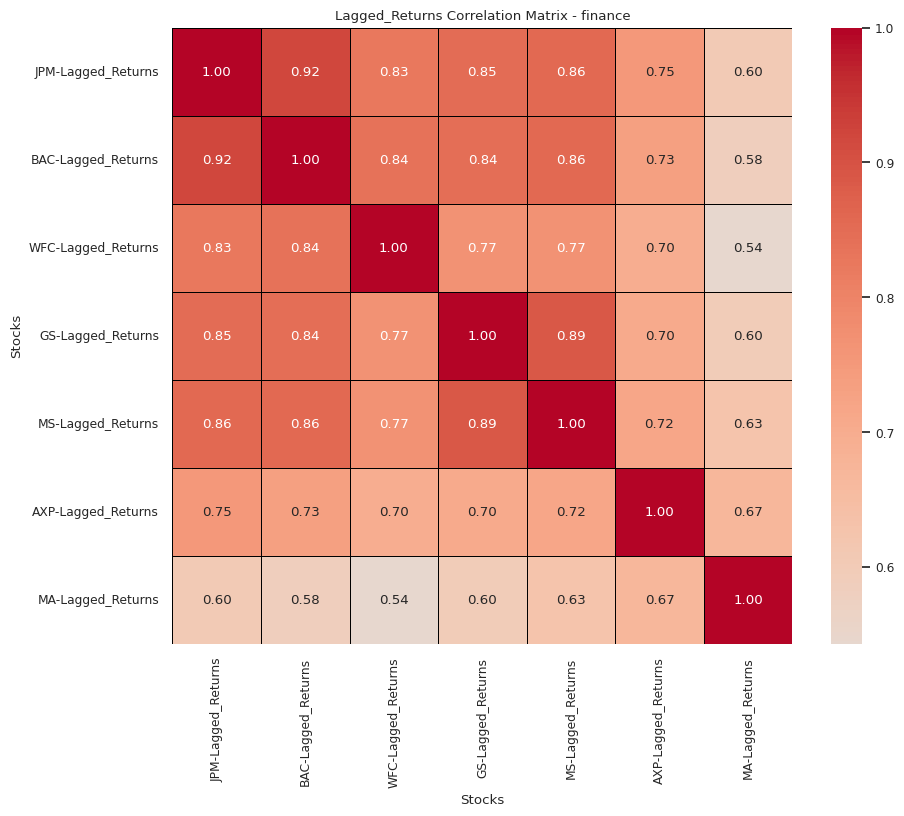

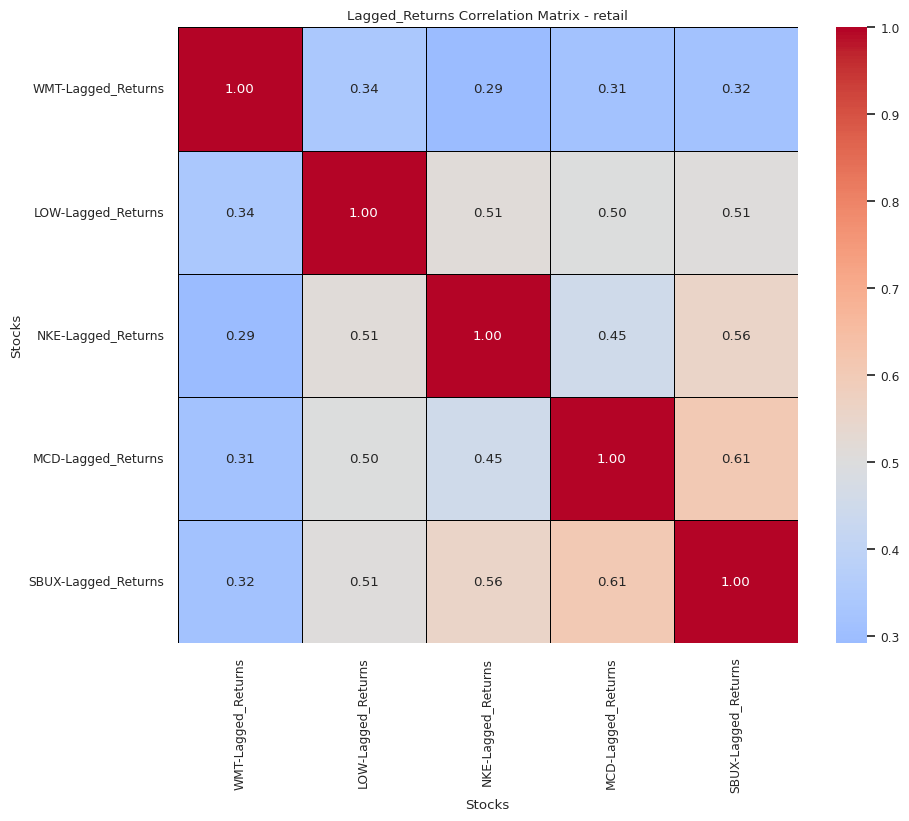

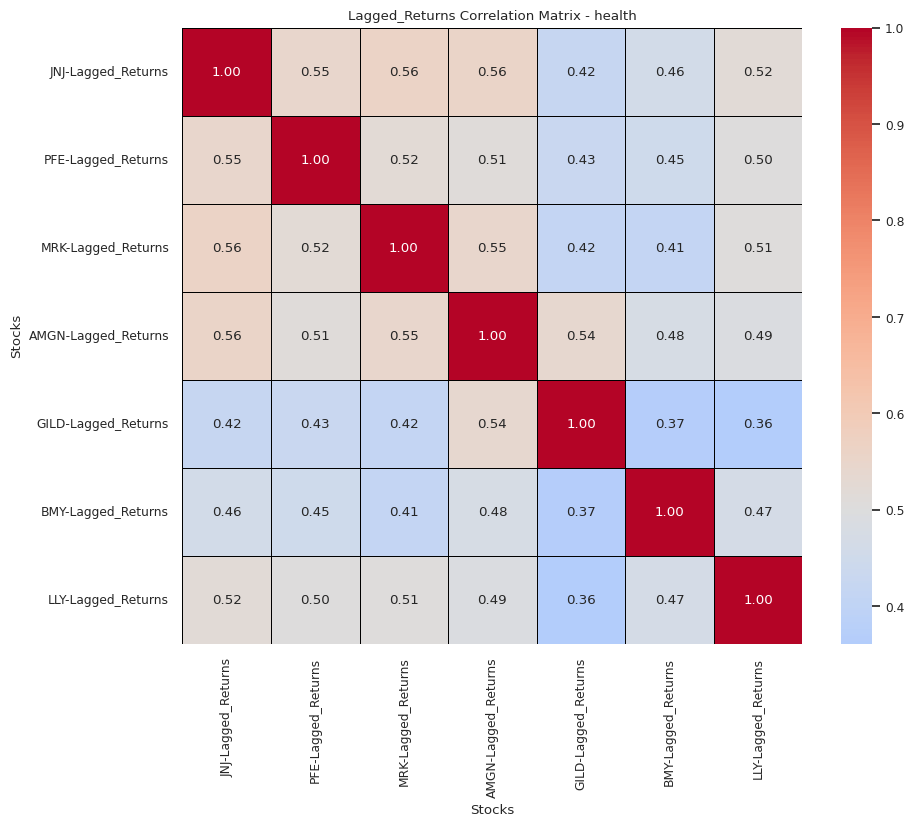

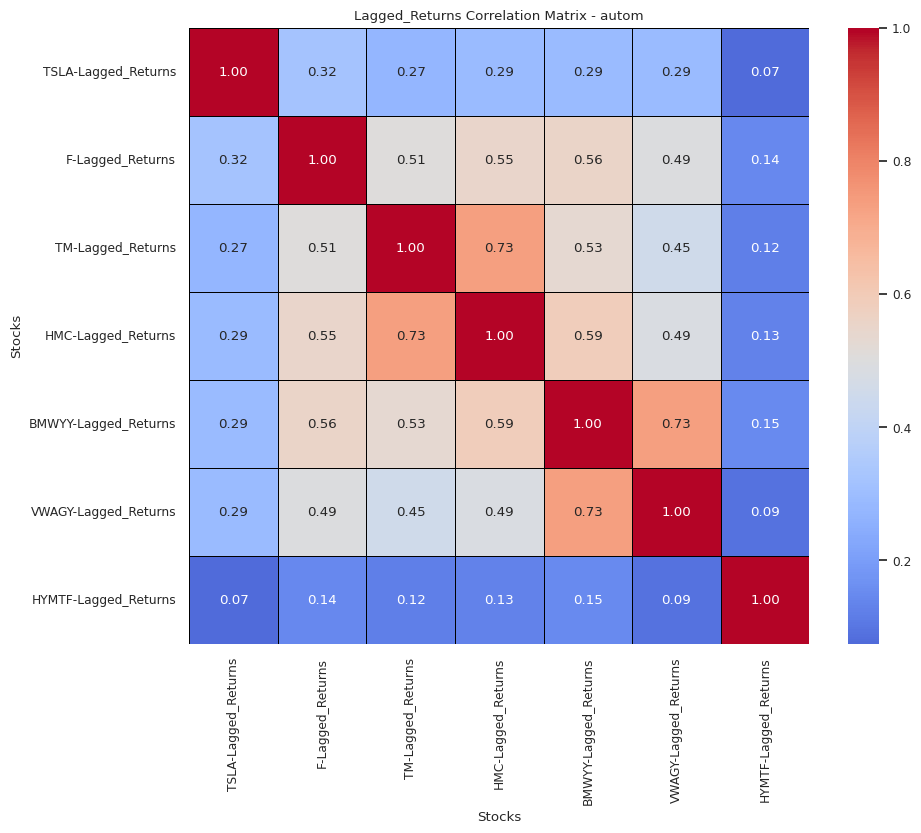

In [25]:
# to store correlation matrices of each sector, we may need them somewhere in the further analysis
lag_correlation_matrices = {}

for sector, df in all_dfs.items():

  lag_close_columns = [(ticker, 'Lagged_Returns') for ticker in df.columns.get_level_values(0).unique()]
  sector_lag_df = df.loc[:, lag_close_columns]

  #correlation matrix
  corr_mat = sector_lag_df.corr()
  lag_correlation_matrices[sector] = corr_mat

  #correlation matrix as a heatmap
  plt.figure(figsize=(10, 8))
  sns.set(font_scale=0.8)
  sns.heatmap(corr_mat,
              annot=True,
              fmt='.2f',
              center=0.5,
              cmap='coolwarm',
              linewidths=0.5,
              linecolor='black')
  plt.title(f'Lagged_Returns Correlation Matrix - {sector}')
  plt.xlabel('Stocks')
  plt.ylabel('Stocks')
  plt.xticks(rotation=90)
  plt.yticks(rotation=0)
  plt.show()


Cool! So, we got the correlation matrices of each sector.

* We could see a high positive correlation between every two stocks of finance sector which implies the over all growth of the finace sector. So, the increase in the stock values of finance sector can been seen as a resultant of overall growth of the sector.

* Both tech and health sectors are having considerble correlation betwee the stocks which implies the sector performance up on which each stock is also having its own roleplay.

* Automobile sector also have a little high positive correlation and this sector is underperforming since past 14 years which is a sole reason for the stock trend realtion with the over all sector performamce. But, we could clearly see a very low correlation between all other stocks, from automobile sector, and TSLA which can be seen as the trend TSLA is having disregarding the performance of the sector. Same is the case with WMT from Retail sector and HYMTF from the same Automobile sector.

Alright! Let's analyse the RSI attribute we have added to the dataframe.

### RSI

Now, let's look at the RSI attrubute that, we have claculated and stored in the dataframe `attribute_df`.

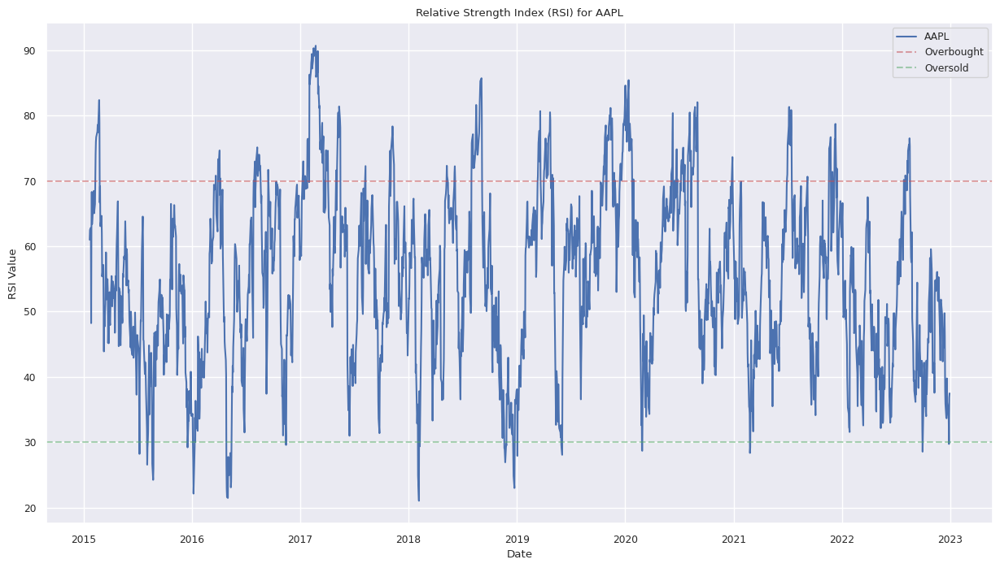

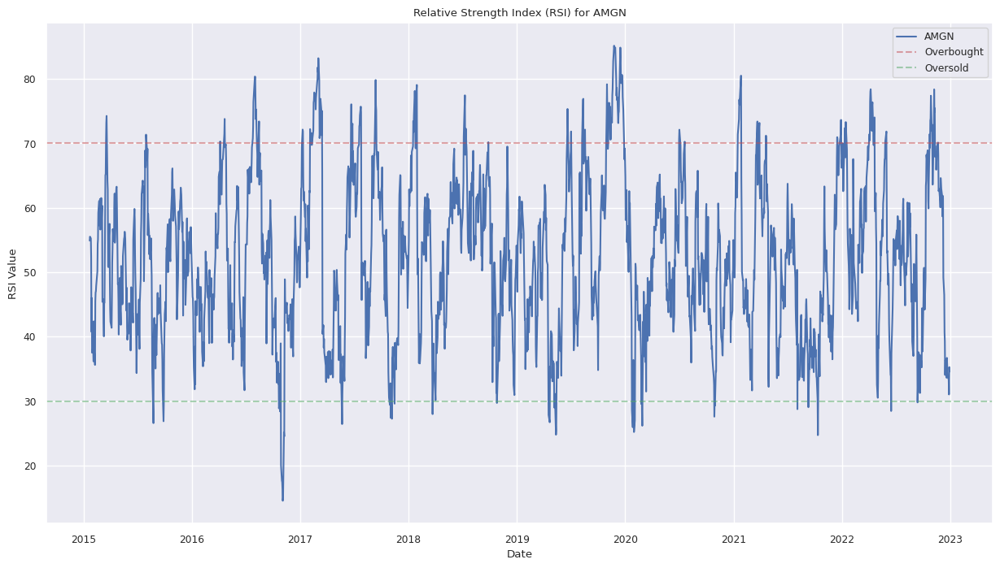

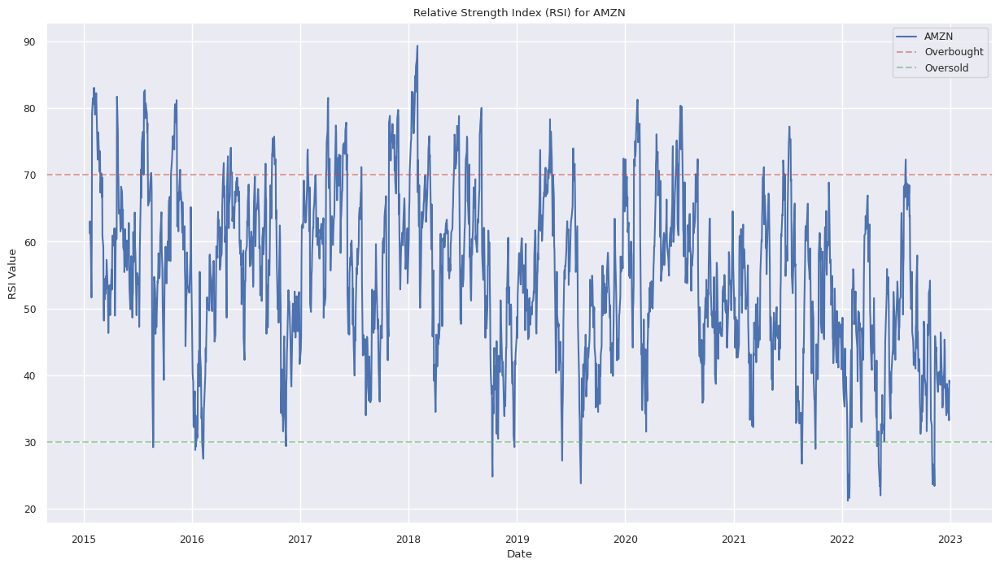

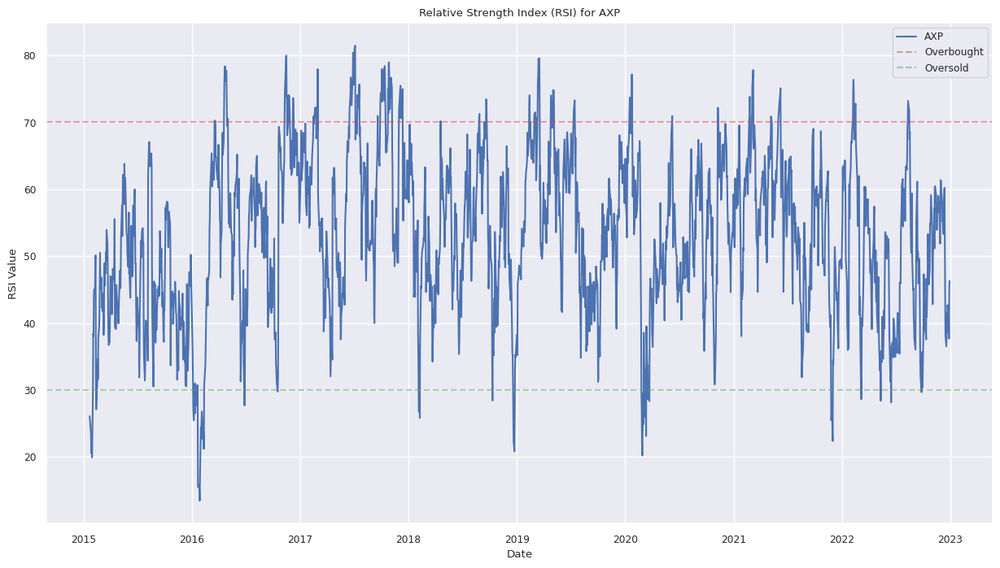

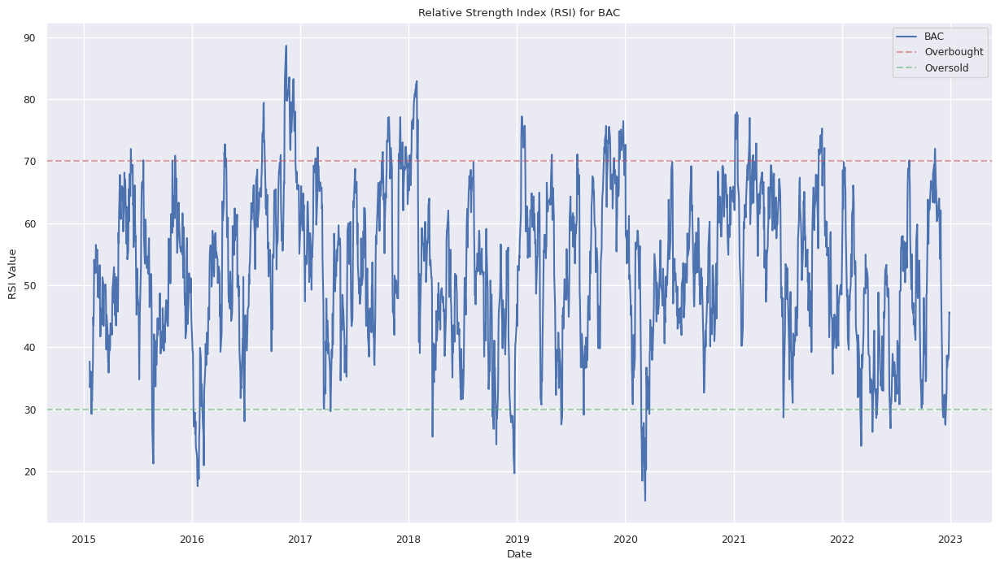

...

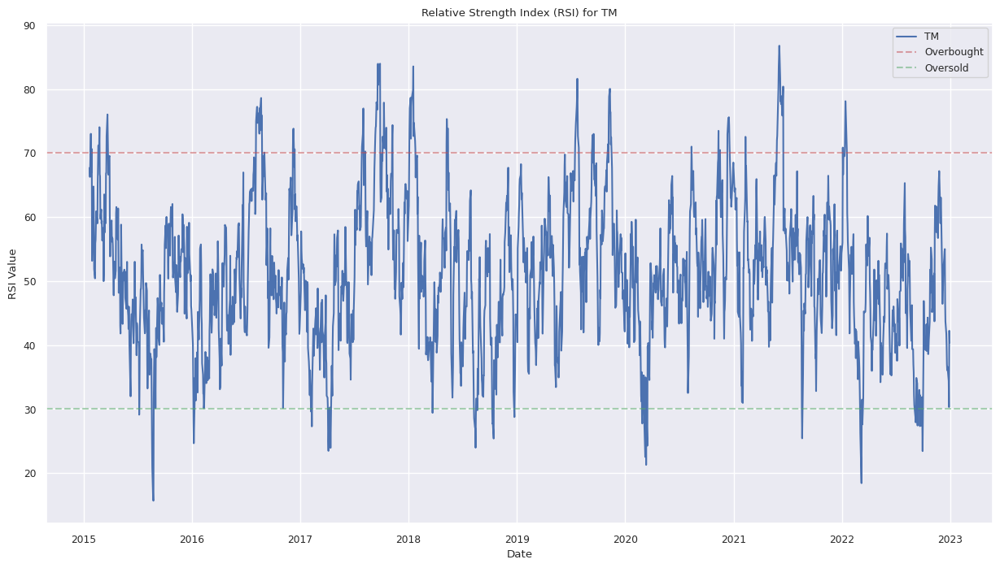

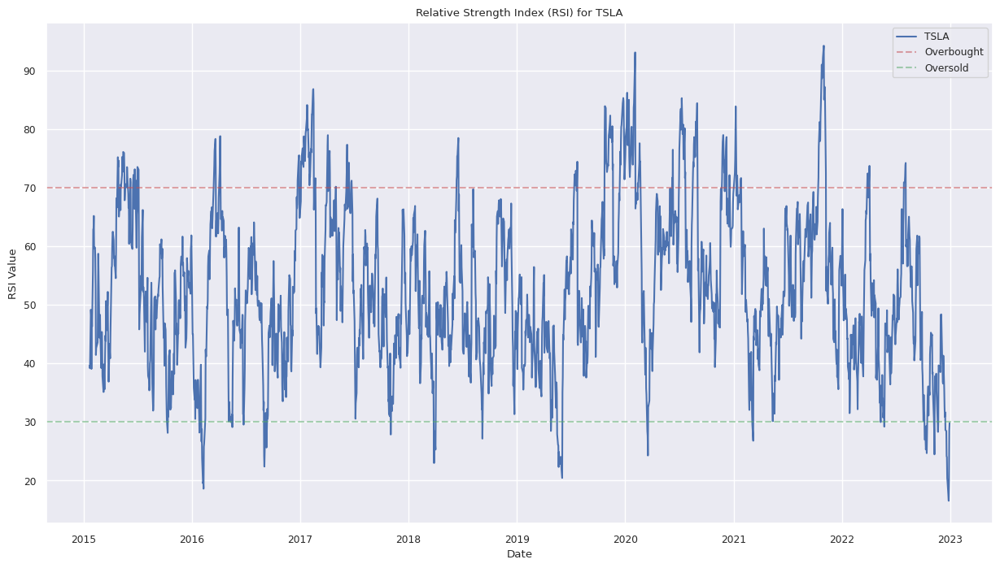

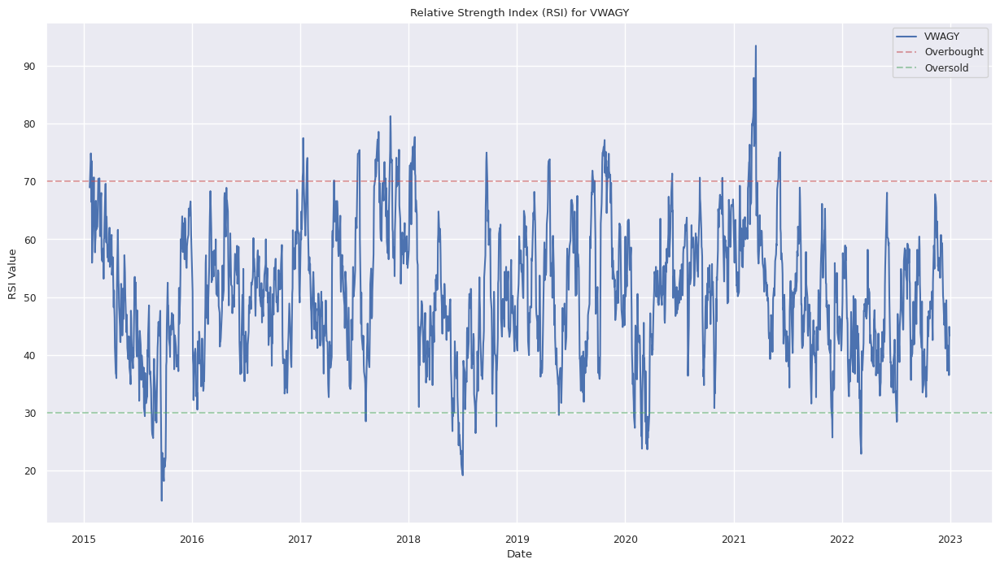

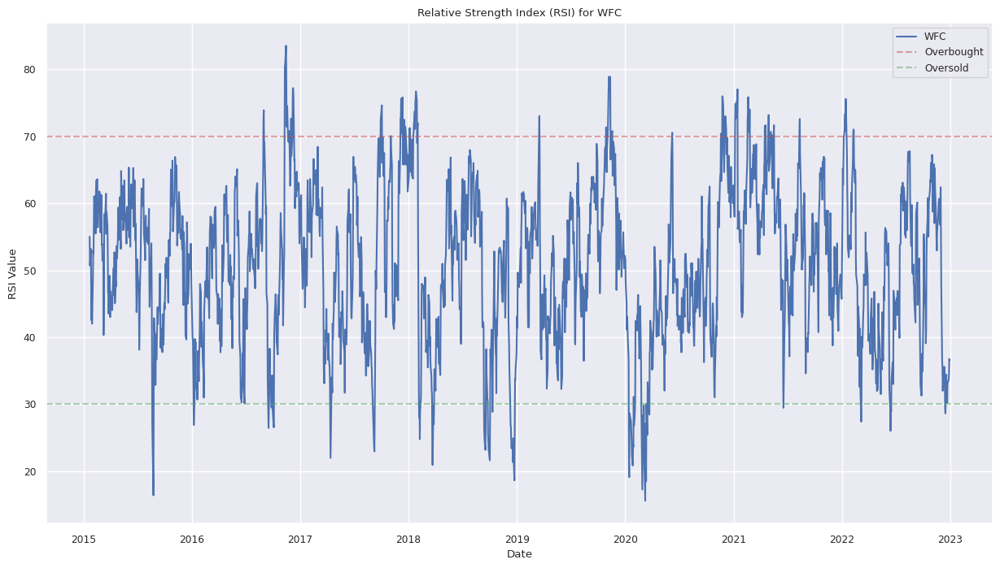

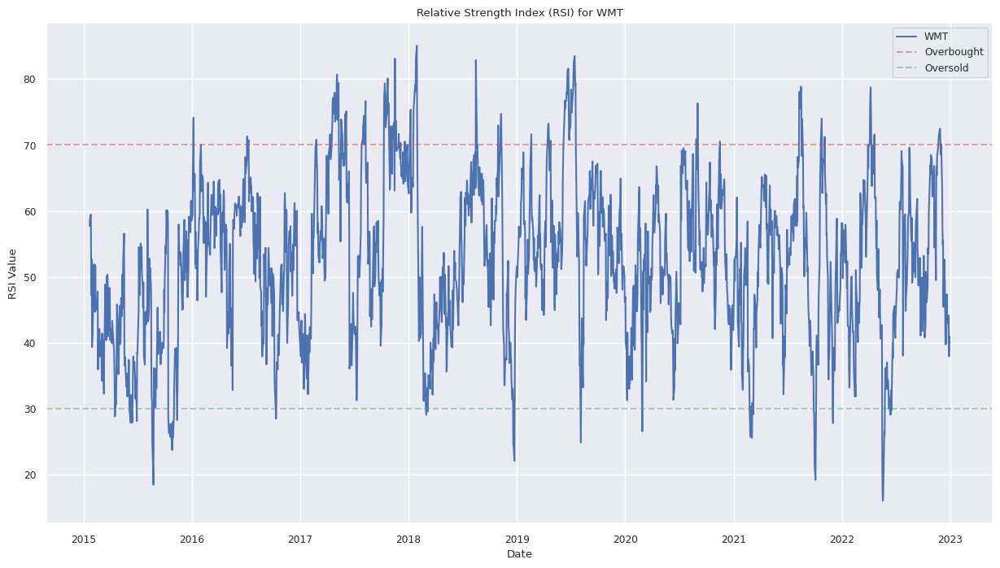

In [26]:
#iterate over the top layer tickers
for ticker in attribute_df.columns.levels[0]:
  # plot for RSI
  plt.figure(figsize=(15, 8))
  plt.plot(attribute_df.index, attribute_df[(ticker, 'RSI')], label=ticker)
  plt.axhline(y=70, color='r', linestyle='--', alpha=0.5, label='Overbought')
  plt.axhline(y=30, color='g', linestyle='--', alpha=0.5, label='Oversold')
  plt.title(f'Relative Strength Index (RSI) for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('RSI Value')
  plt.legend()
  plt.grid(True)
  plt.show()


Here, again, we could have plotted them for few stocks or sectors but to just get a quick overview of ewach sector, We've got to plot the RSI graphs for evry stock.

Analysis:

* The Upper bound and lower bound taken here are 70 and 30 which are taken for identifying the overbought and oversold stocks.

* If the RSi graph moves abov the y=70 line then we can term the stock as overbought and a potential reversal or correction could occur.

* If the RSI graph moves below the y=30 line then we can term the stock as oversold and potential upwards price movement or bounceback could happen.

* We can see a few stocks which consistently remained in the overbought region like,
  - AAPL
  - MSFT
  - AMZN
  - LLY
  - META (but in the recent times we can see, it is being oversold)
  - NFLX (but in the recent times we can see, it is being oversold)
  - MA (its one of the most over bought stock in the 2017-2019 time period)
  - GGOGL (but in the recent times we can see, it is being oversold))

* We can also see a few stocks which consistently remained in the oversold region like,
  - BMY
  - F (but in the recent times we can see, it is being overbought)
  - HYMTF

* Now, let's look at the stocks that are being overbought in the recent times,
  - GILD
  - GS
  - LLY
  - MRK
  - PFE

* Again, as expected, tech scetor out performed over other sectors but we can see the secline in the tech sectors performance in the recent times.

### MACD


Now, let's look at the MACD attrubutes those, we have claculated and stored in the dataframe `attribute_df`.


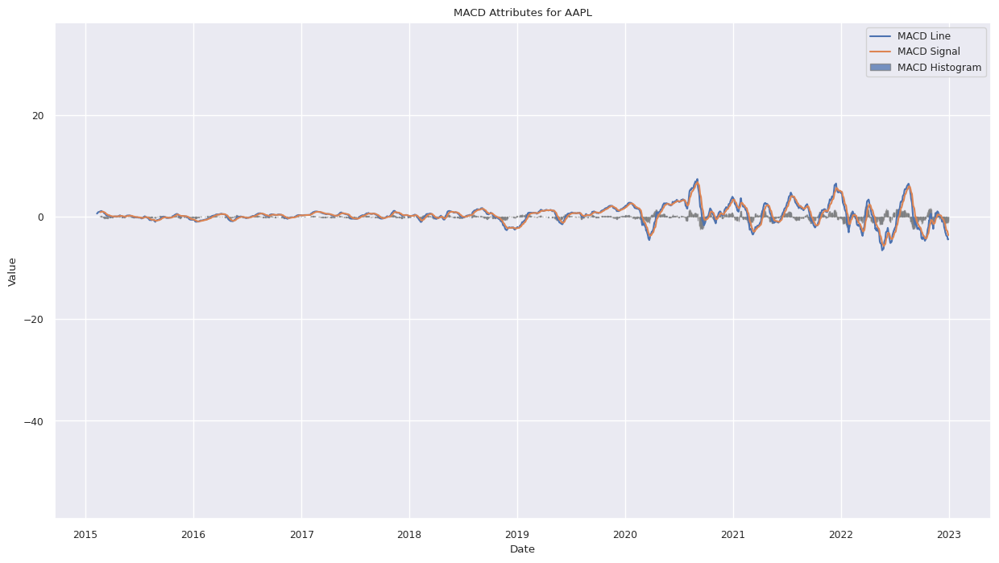

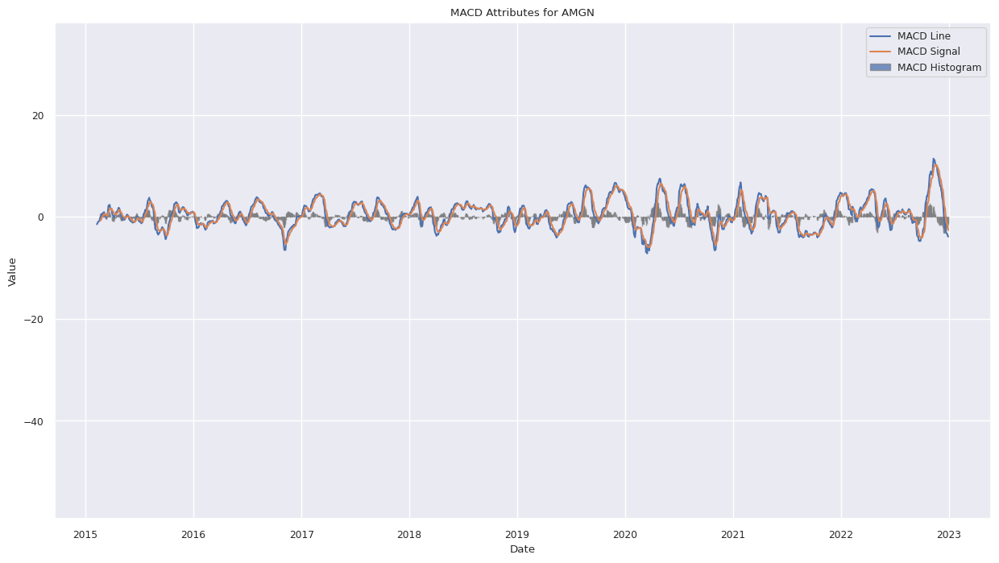

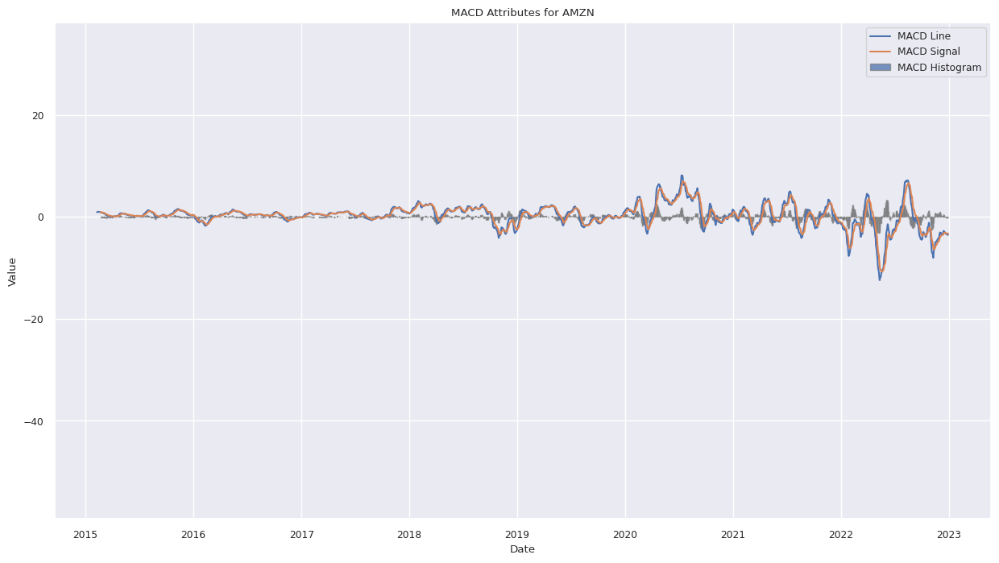

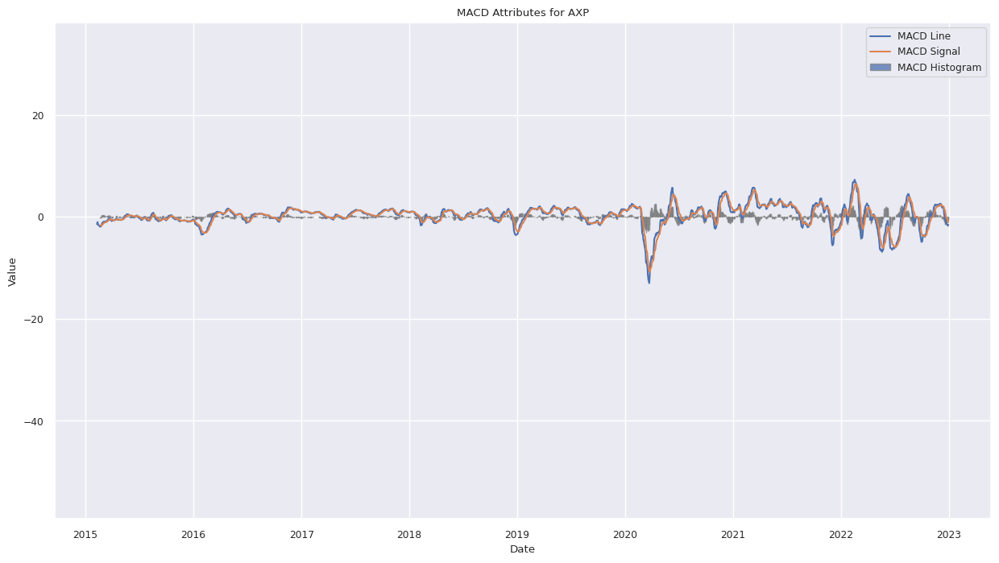

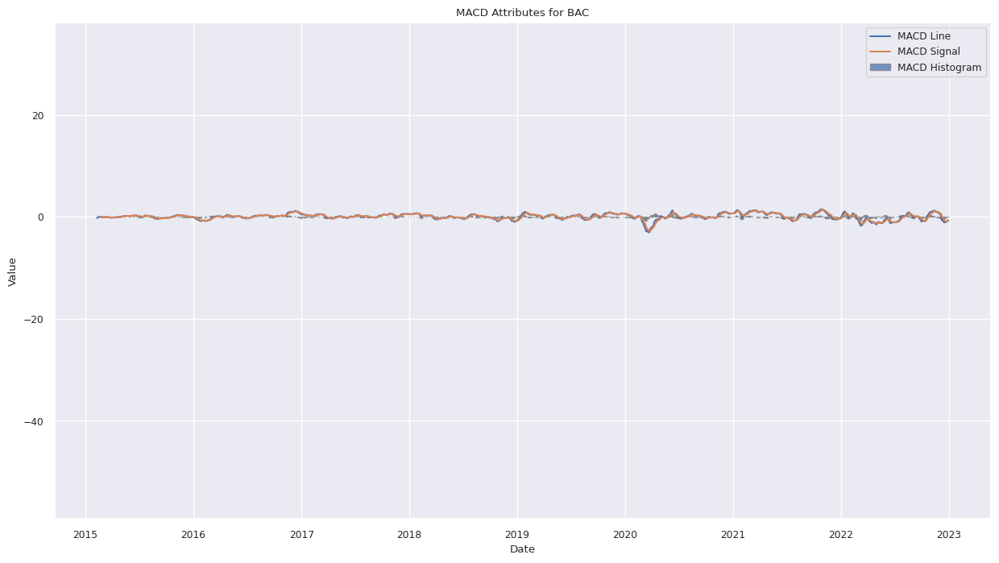

...

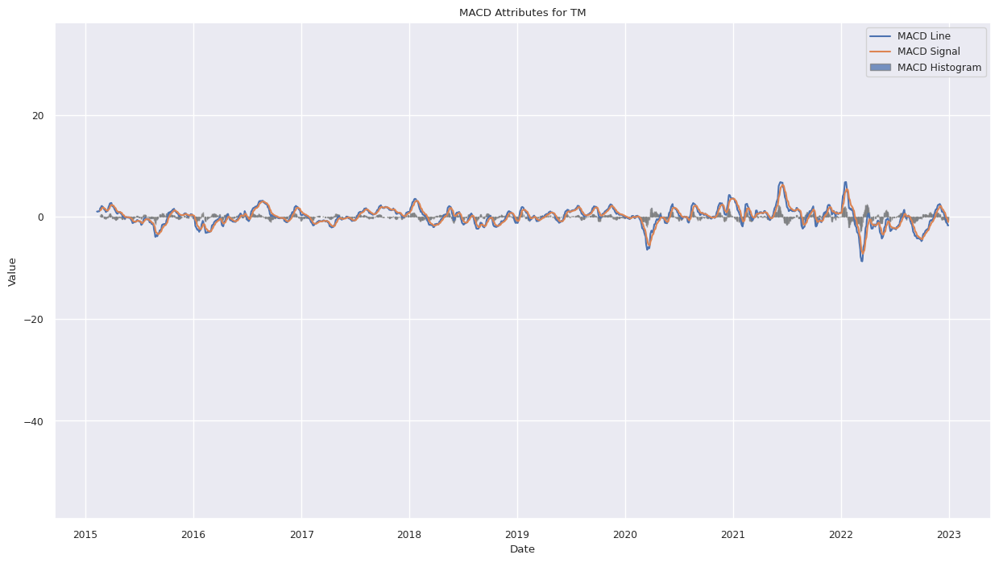

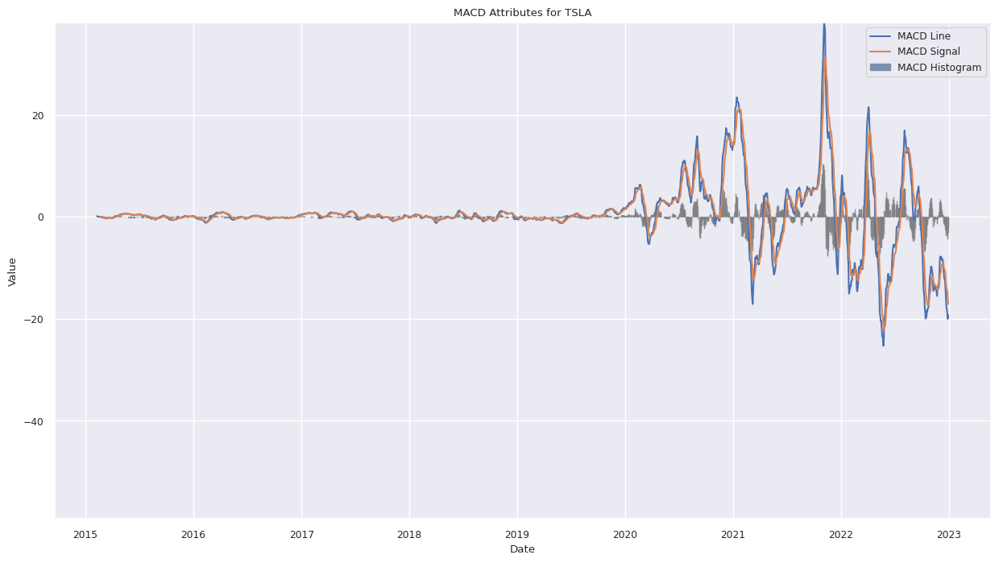

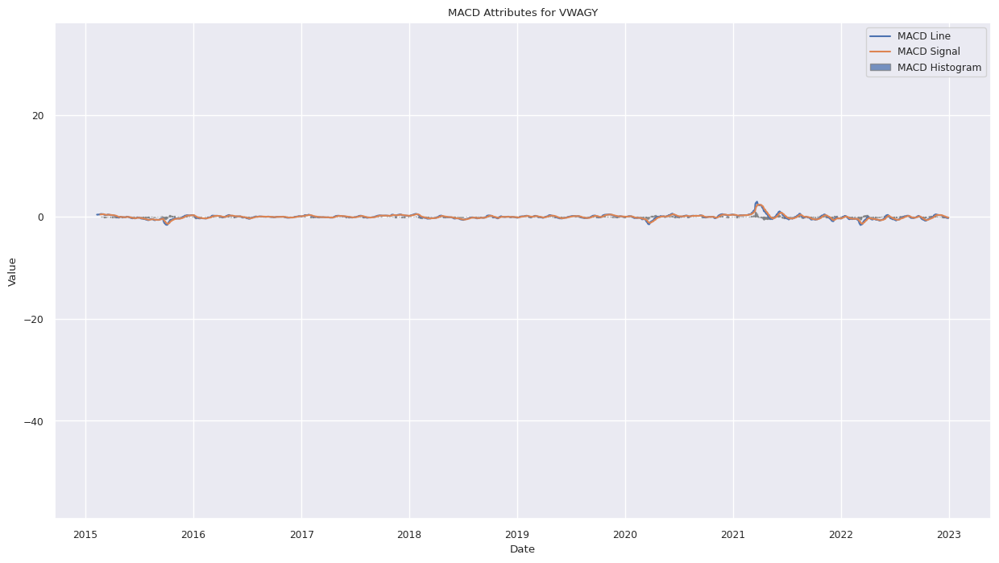

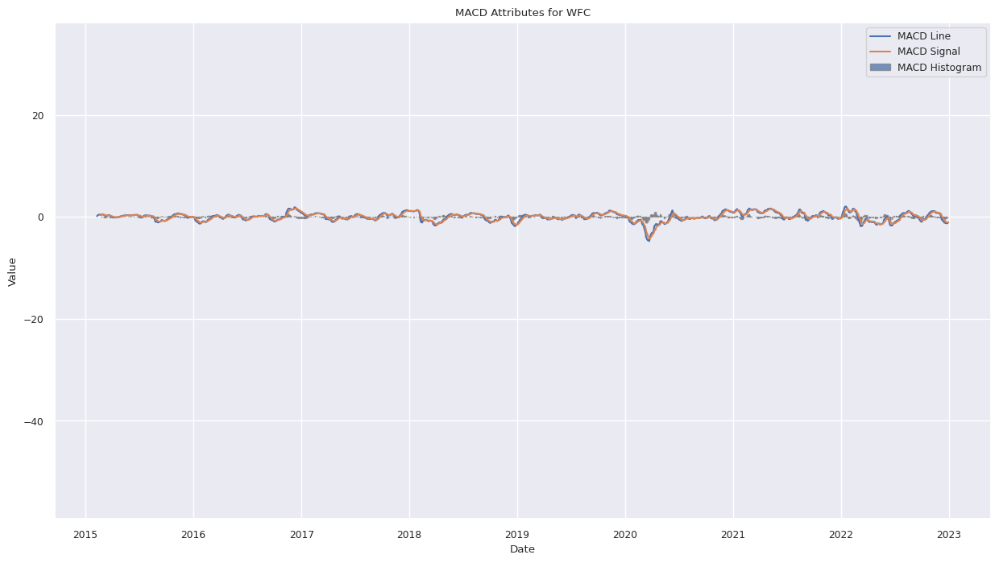

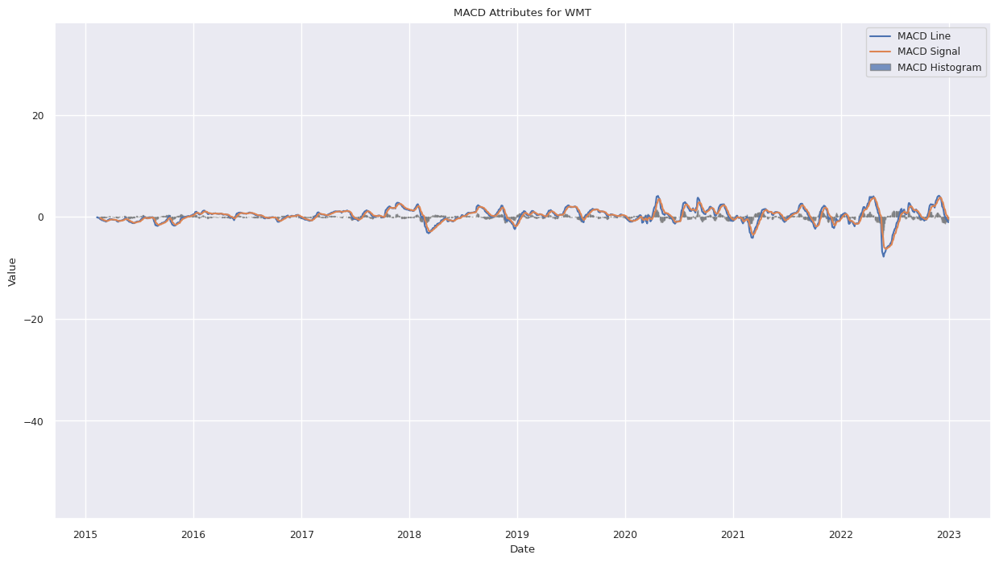

In [27]:
max_value = attribute_df.loc[:, (slice(None), ['MACD_Line', 'MACD_Signal', 'MACD_Histogram'])].max().max()
min_value = attribute_df.loc[:, (slice(None), ['MACD_Line', 'MACD_Signal', 'MACD_Histogram'])].min().min()

#iterate over the top layer tickers
for ticker in attribute_df.columns.levels[0]:
  #plot for MCAD
  plt.figure(figsize=(15, 8))
  plt.plot(attribute_df.index, attribute_df[(ticker, 'MACD_Line')], label='MACD Line')
  plt.plot(attribute_df.index, attribute_df[(ticker, 'MACD_Signal')], label='MACD Signal')
  plt.bar(attribute_df.index, attribute_df[(ticker, 'MACD_Histogram')], edgecolor='gray', alpha=0.75, width=0.5, label='MACD Histogram')
  plt.title(f'MACD Attributes for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Value')
  plt.ylim(min_value, max_value)
  plt.legend()
  plt.show()

>These plots are not clear becuse the yrange has been set fixed for easy anlysis. We can plot directly without putting any ylim to observe the stock wise plots. Code is as follows:


```
#iterate over the top layer tickers
for ticker in attribute_df.columns.levels[0]:
  #plot for MCAD
  plt.figure(figsize=(15, 8))
  plt.plot(attribute_df.index, attribute_df[(ticker, 'MACD_Line')], label='MACD Line')
  plt.plot(attribute_df.index, attribute_df[(ticker, 'MACD_Signal')], label='MACD Signal')
  plt.bar(attribute_df.index, attribute_df[(ticker, 'MACD_Histogram')], edgecolor='gray', alpha=0.75, width=0.5, label='MACD Histogram')
  plt.title(f'MACD Attributes for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Value')
  plt.legend()
  plt.show()
```



These graphs may look complex but we can anlyse about them in most simpple way as follows,

* MACD Line in the plot represents the difference between Exponential Moving Averages, EMA, that of 12-day and 26-day.

* MACD Signal in the plot represents the 9-day EMA of MACD line.


The terms may look overwhelming but the only thing which we are concerned about is the use of MACD Line and MACD Signal in our Analysis.

* When the MACD Line crosses above the MACD Signal, it generates a bullish signal, indicating a potential **buying opportunity.**

* Conversely, when the MACD Line crosses below the MACD Signal, it generates a bearish signal, indicating a potential **selling opportunity.**

* MACD Histogram in the plot represents the difference between the MACD Line and the MACD Signal. Basically, positive histogram bars indicate bullish momentum, while negative bars indicate bearish momentum.

* So most of the times we look for the histograms for the analysis we need.


Let's go through the plots and look for the performances of various stocks in the recent years,

* We can see stocks like TSLA, NVDA, NFLX, META were having a good amount of buying oppurtunities in the recent years but the RSI plots represented that they have been oversold.

* We can also that the automobile sector had liitle to no opputunities comparing to the other sectors. They alsomst looked like a flat line.

* Again, from the satrt we are seeing this immediate high selling and buying opputunities in the post covide timeframe.

* TSLA was been in the set of stocks which haven't seen a great buying or selling oppurtunities before 2018. But from then we could clearly seea tremendous change in its selling and buying oppurtunities. We are going to study this impact in a more efficient way in the further analysis.

* By comparing the sectors we can see a similar trend from the start tech sector which outperforms while the automobile sector which underperforms.


### Bollinger Bands

Now, let's look at the Bollinger Bands attrubutes those, we have claculated and stored in the dataframe `attribute_df`.

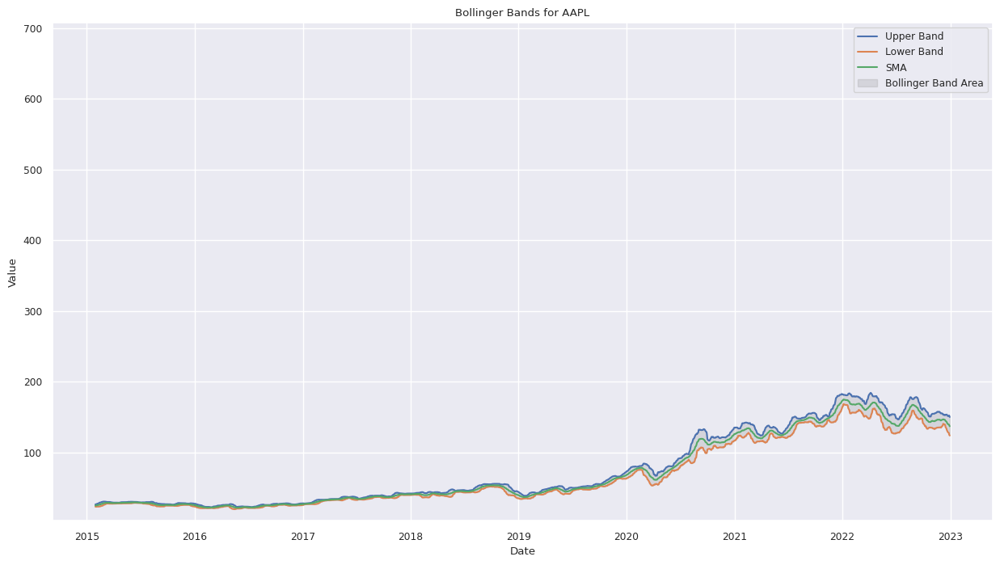

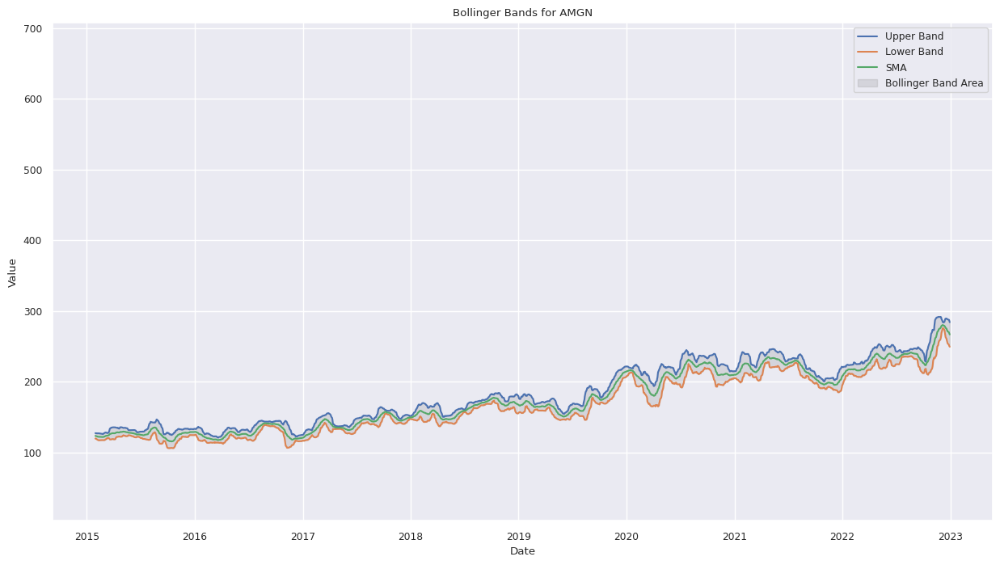

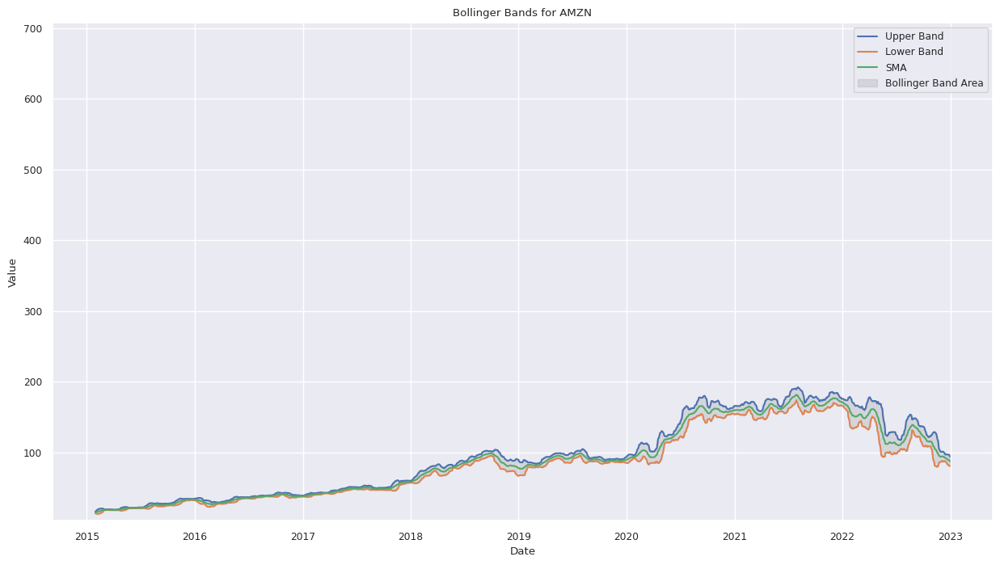

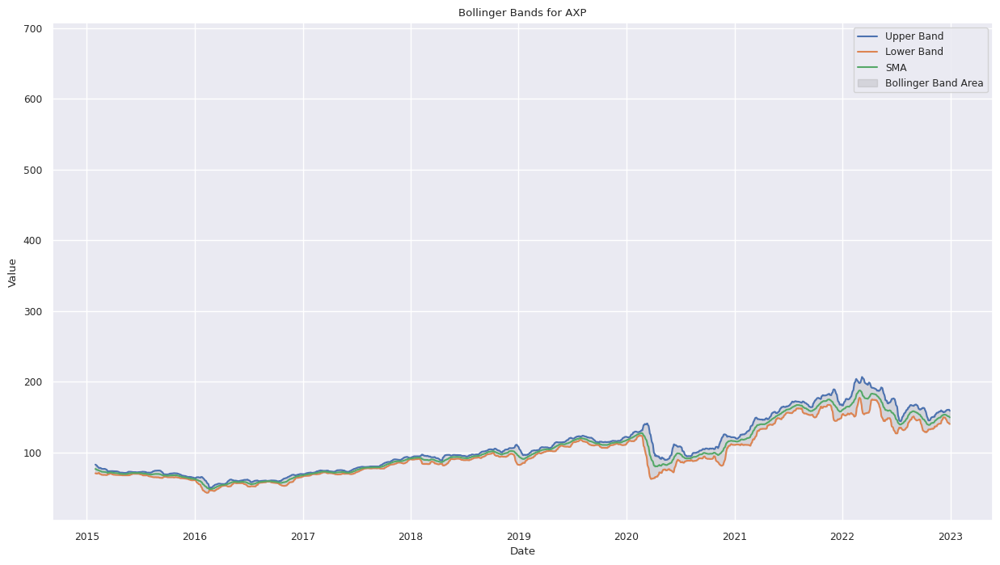

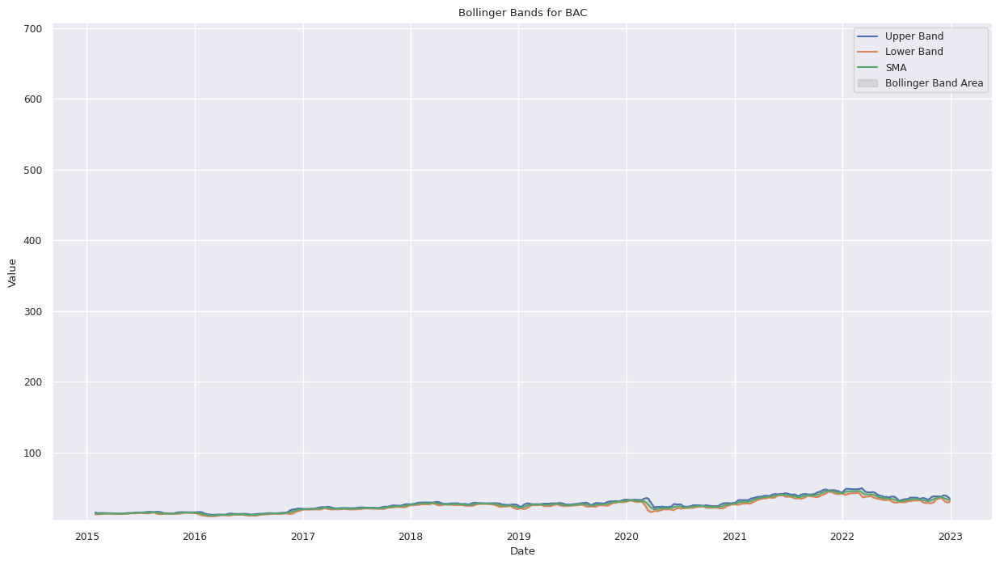

...

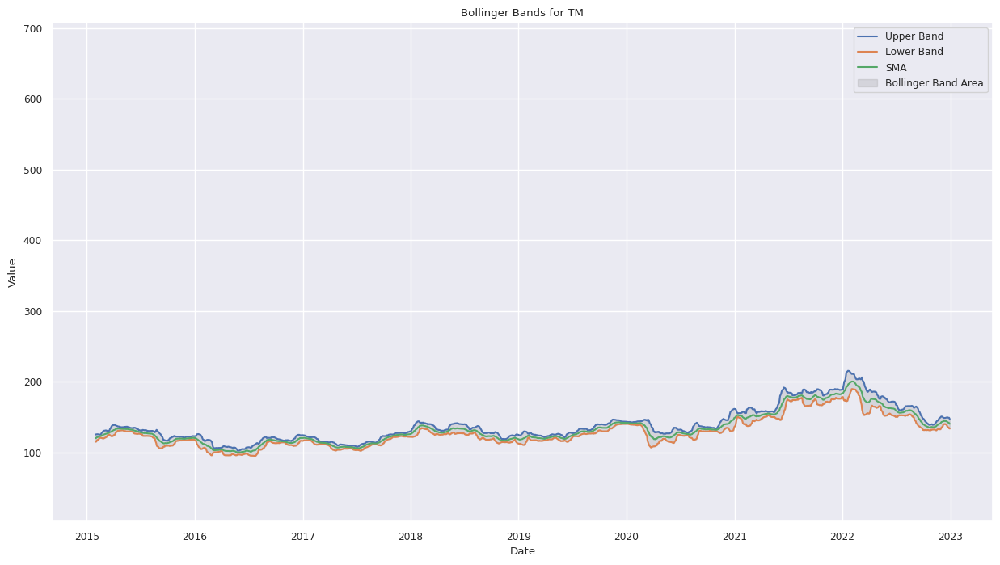

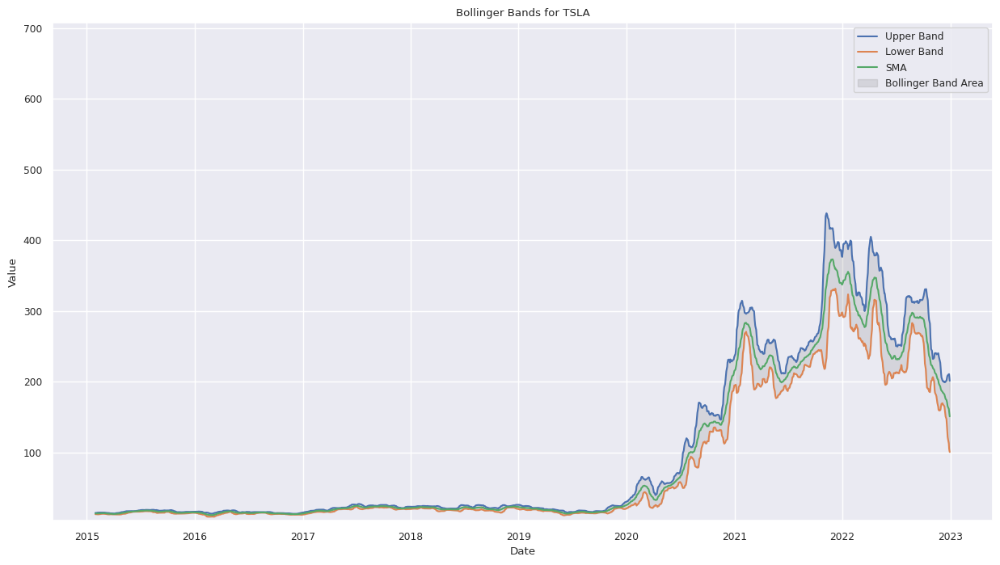

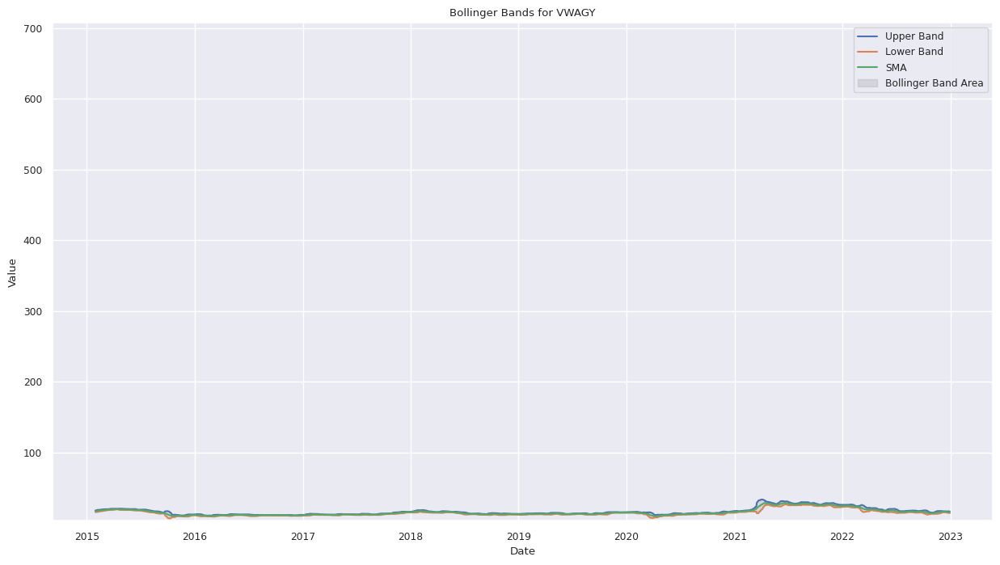

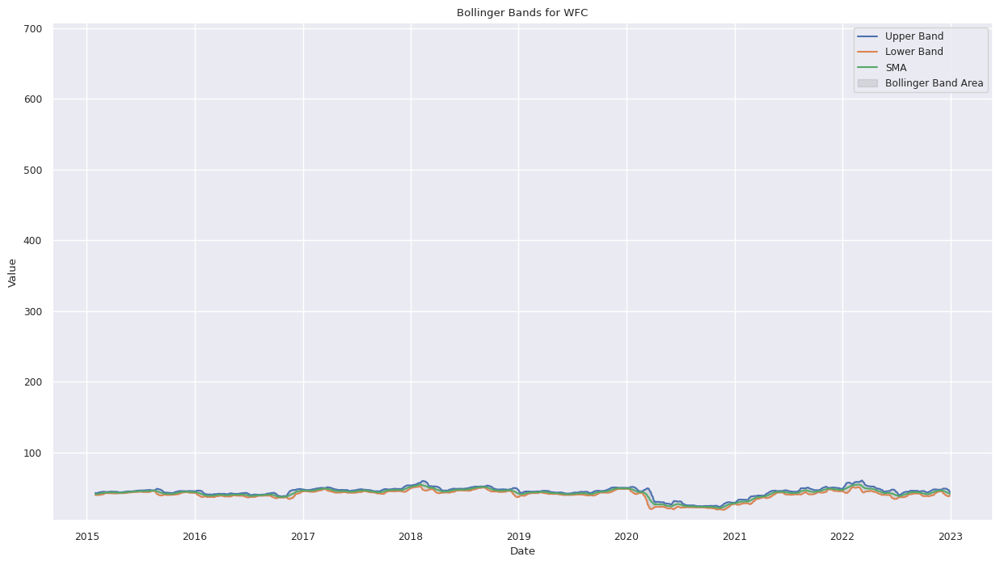

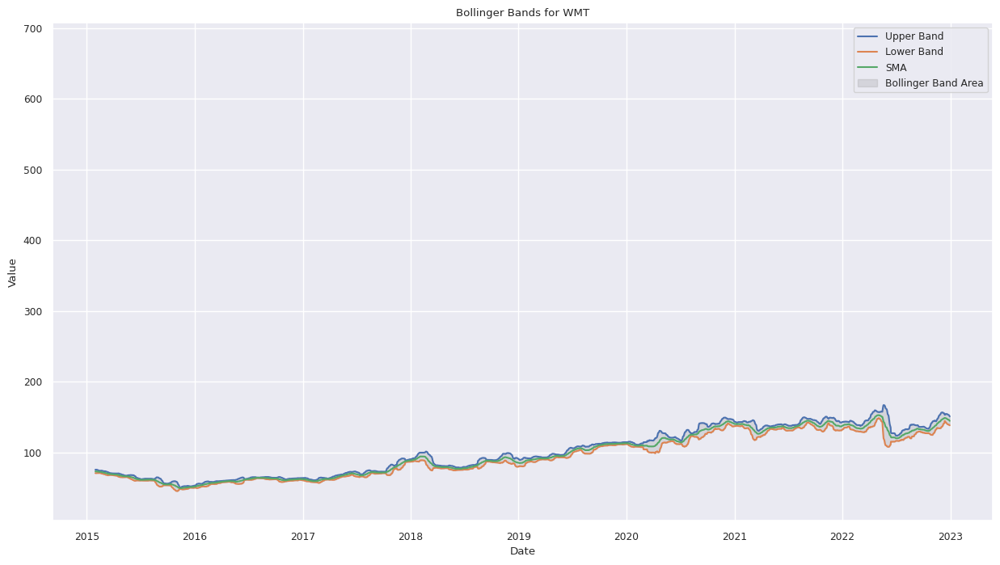

In [28]:
max_value = attribute_df.loc[:, (slice(None), ['Upper_Band', 'Lower_Band', 'SMA'])].max().max()
min_value = attribute_df.loc[:, (slice(None), ['Upper_Band', 'Lower_Band', 'SMA'])].min().min()


# Iterate over the top layer tickers
for ticker in attribute_df.columns.levels[0]:
  #plot for Bollinger Bands
  plt.figure(figsize=(15, 8))
  plt.plot(attribute_df.index, attribute_df[(ticker, 'Upper_Band')], label='Upper Band')
  plt.plot(attribute_df.index, attribute_df[(ticker, 'Lower_Band')], label='Lower Band')
  plt.plot(attribute_df.index, attribute_df[(ticker, 'SMA')], label='SMA')
  plt.fill_between(attribute_df.index, attribute_df[(ticker, 'Lower_Band')], attribute_df[(ticker, 'Upper_Band')],
                    alpha=0.2,
                    color='gray',
                    label='Bollinger Band Area')
  plt.title(f'Bollinger Bands for {ticker}')
  plt.xlabel('Date')
  plt.ylabel('Value')
  plt.ylim(min_value, max_value)
  plt.legend()
  plt.grid(True)
  plt.show()

Alright! Each graph is having the following plots in it,
* Simple Moving Average, SMA, line is the indicator to smooth out price data over a specified time period. It is, basically, the average of stock prices over a specific number of periods.

SMA line represents the general direction of the trend.

* Upper and Lower bands represents the upper boundary and lower boundary of price movement respectively they are calculated from the standard deviations of Moving avergae line.

So, as deviations represnts the change in prices in regular intervals, the shaded area between the bands represents the amount of volatility of a stock price in theat particular time period.

* When the bands are wide, it suggests higher volatility, while narrow bands indicate lower volatility. In the sense, stocks with wider bands may experience larger price swings compared to those with narrower bands.

* At the same time the higher value of SMA or bands represents the higher stock price.

Okay! by looking at the plots,

*  We can see the stocks like TSLA, NVDA, NFLX, META, GS and MA are having large avergae prices but the same time they are extremely volatile.
* Where as the stocks like AMGN, GOOGL, LLY, LOW, MCD and MSFT are having considerably good stock prices and at the same time not so volatile.
* So this is the first time where we are able to differentiate between stocks of tech sectors. All of them are having good stock prices but the difference is some of them are ectremely volatile.
* Coming to other stocks from other sectors they are having no good stock prices and at the same time not too volatile too.


### Moving Averages.

We have laready seen the plots of Simple Moving Average. But the following plots are the collection of moving averages at different periods like 20, 50, 100 and 200. It also includeed the price plot. Which can give us an insight about some other stock dependencies.

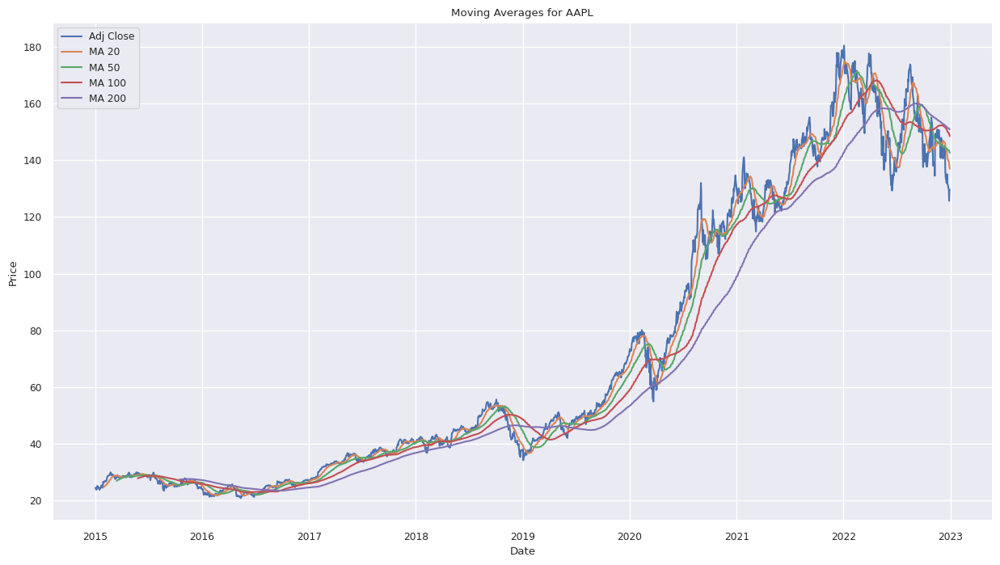

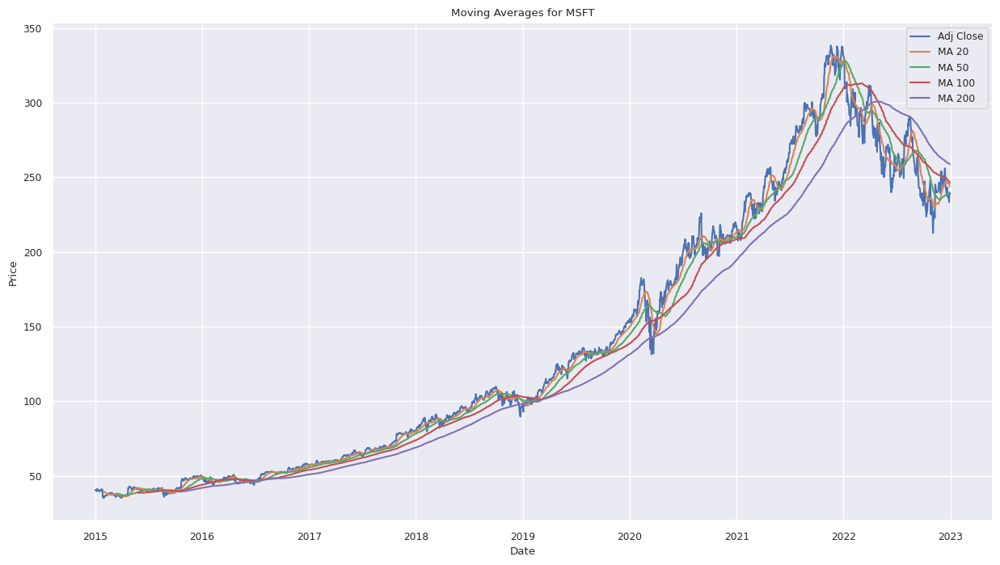

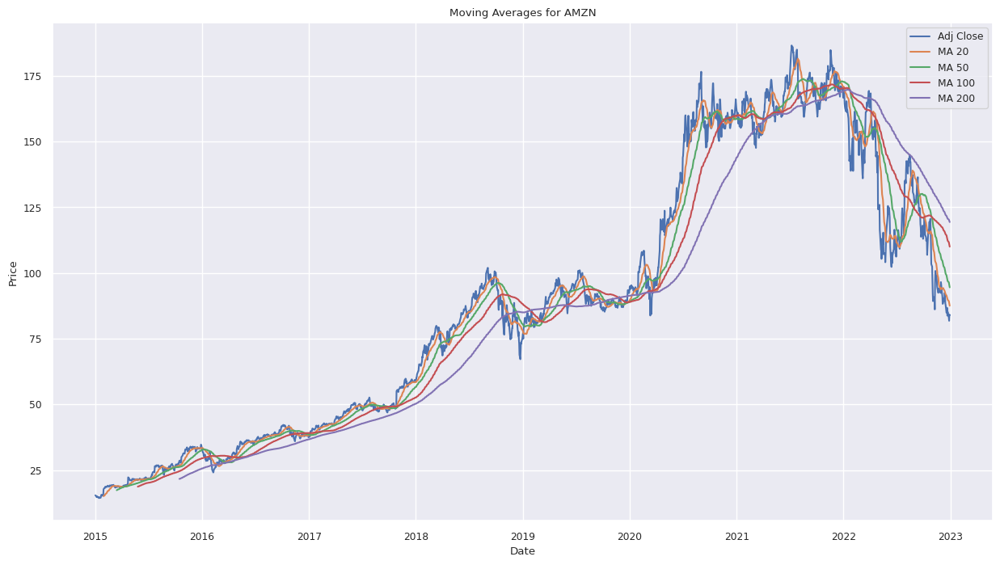

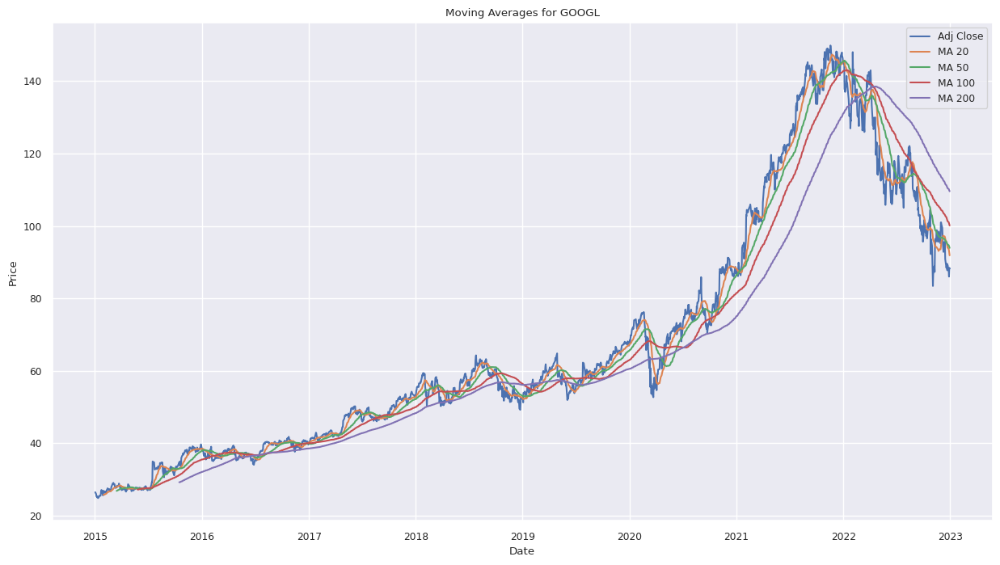

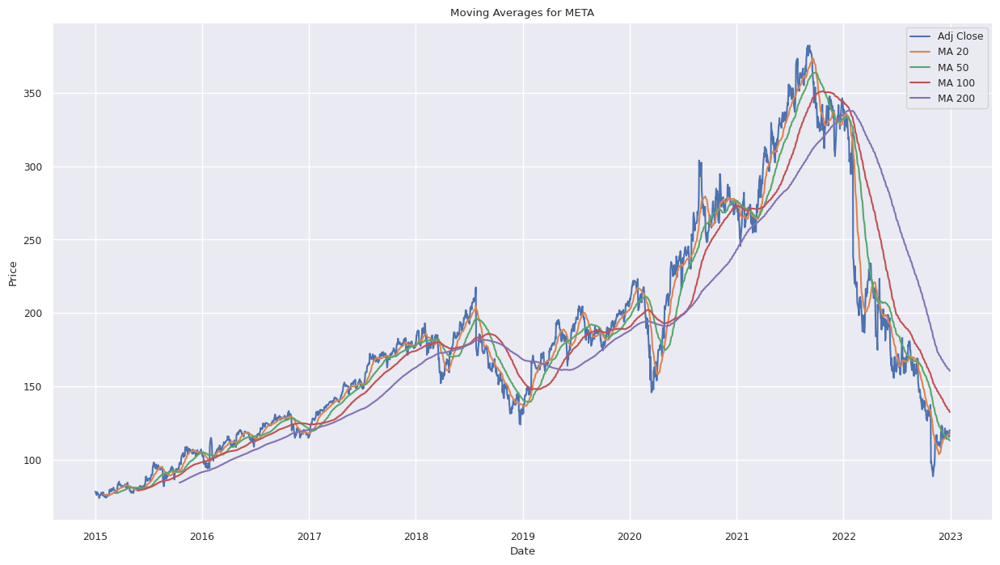

...

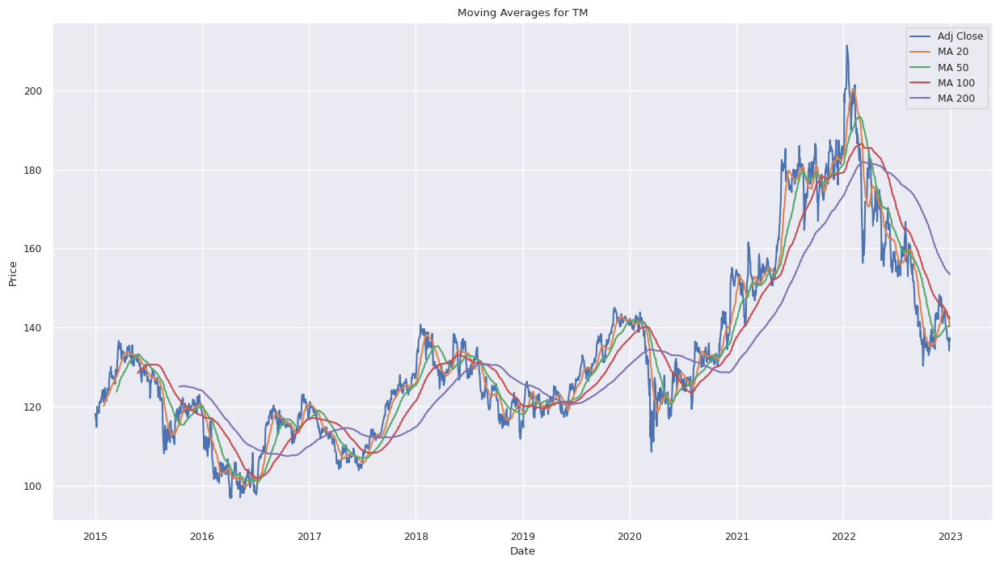

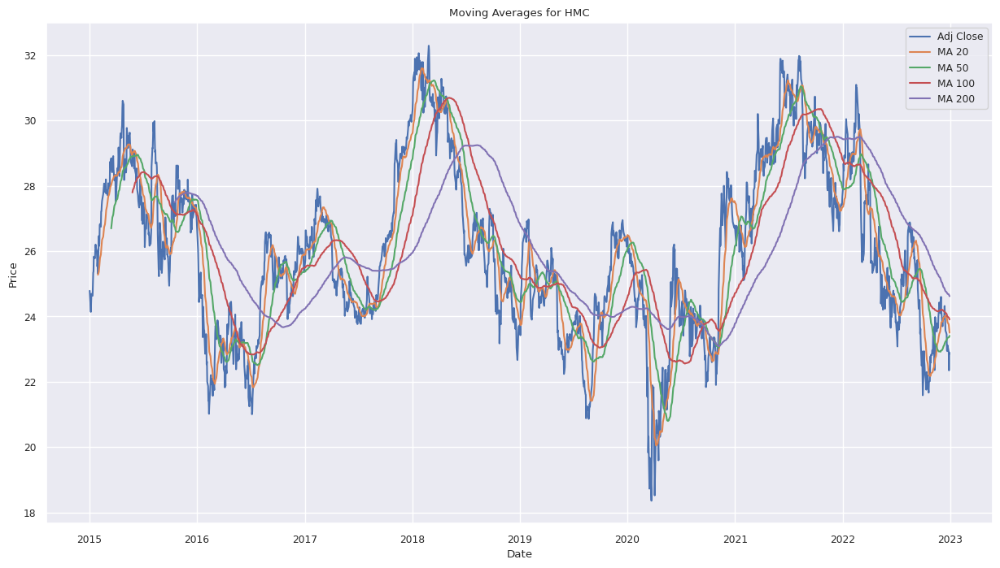

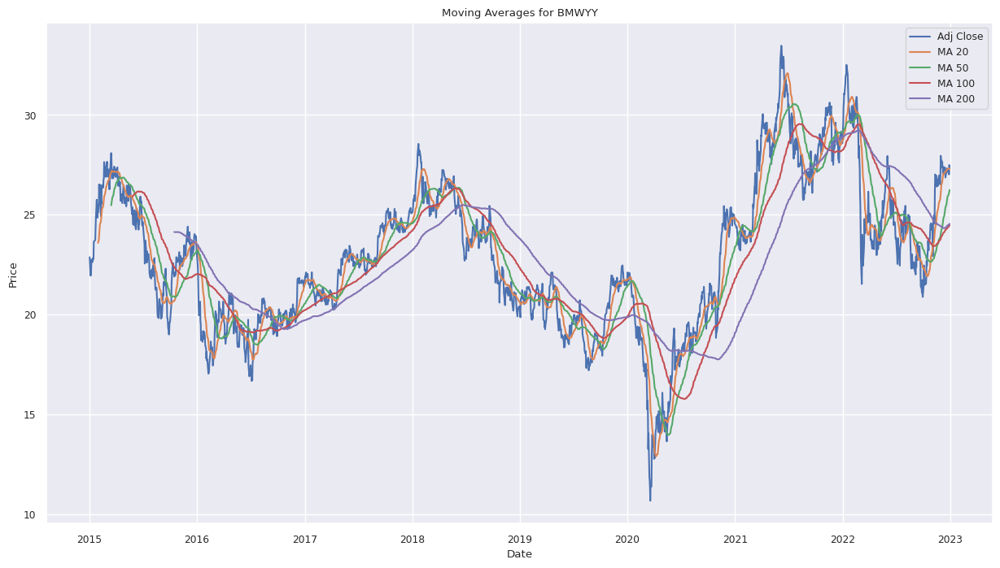

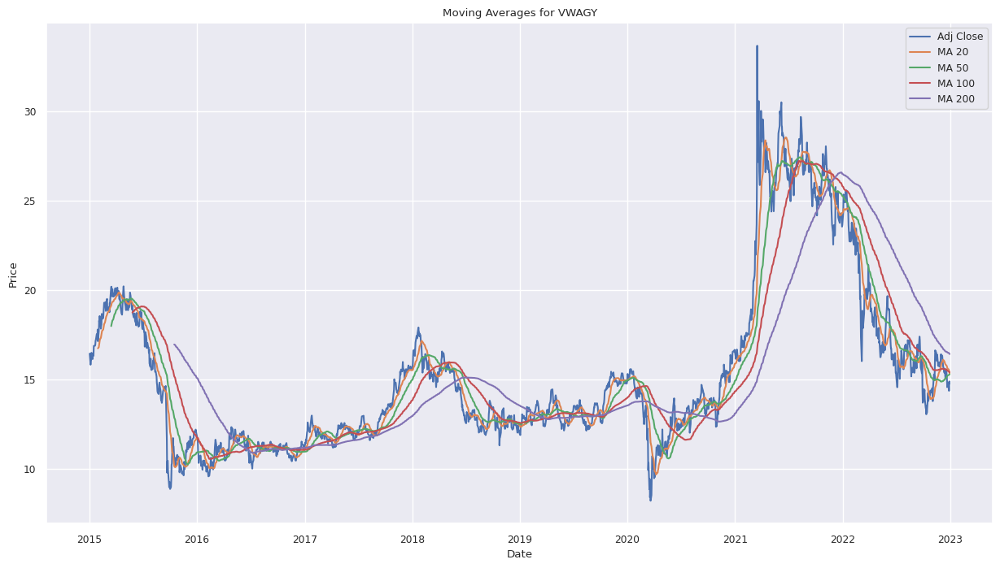

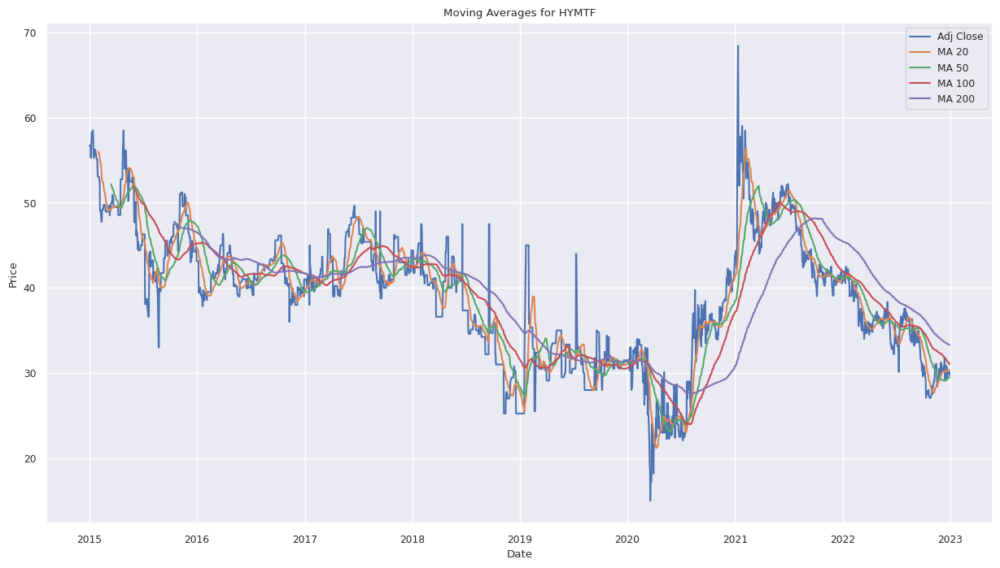

In [29]:
for sector, df in all_dfs.items():
  for ticker in df.columns.get_level_values(0).unique():
    # Adj Close value of ecah ticker
    adj_close = df[(ticker, 'Adj Close')]

    #moving averages at periods of 20, 50, 100 and 200
    ma_20 = adj_close.rolling(window=20).mean()
    ma_50 = adj_close.rolling(window=50).mean()
    ma_100 = adj_close.rolling(window=100).mean()
    ma_200 = adj_close.rolling(window=200).mean()


    # Plot for moving averages
    plt.figure(figsize=(15, 8))
    plt.plot(df.index, adj_close, label='Adj Close')
    plt.plot(df.index, ma_20, label='MA 20')
    plt.plot(df.index, ma_50, label='MA 50')
    plt.plot(df.index, ma_100, label='MA 100')
    plt.plot(df.index, ma_200, label='MA 200')
    plt.title(f'Moving Averages for {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    plt.show()

>The plots look almost the same because the yrange has not been fixed this time. We can fix it if we need but I wanted keep it clear becaus the previous plots are kind of consized. This part can be considered as the one to look for individula stocks performnace. One can do that if they are conc erned about any particular stock.

The anlysis for this part is nothing different than the one with SMA, so, we can quickly go through this part.

* When the Adj Close prices are consistently above the moving averages, it indicates an uptrend. Whereas, when the Adj Close prices are consistently below the moving averages, it suggests a downtrend.

* When the shorter-term moving average crosses above the longer-term moving average, it may indicate a bullish signal, i.e. start of an uptrend. Whereas, when the shorter-term moving average crosses below the longer-term moving average, it may suggest a bearish signal, i.e. start of a downtrend.

* Again the space between the moving averages provides us the insight about volatility.

This analysis is more or less similar to the previous anlysis we've made. But we can look for more insights regarding the trends if needed.

### Volatility Analysis

Okay! Now let's dive deep into the volatility analysis.

In [30]:
vol_data = {}

for sector, df in all_dfs.items():
  vol_data[sector] = {}
  for ticker in df.columns.get_level_values(0).unique():
    adj_close_col= (ticker, 'Adj Close')
    lagged_returns_col = (ticker, 'Lagged_Returns')

    if adj_close_col not in df.columns:
      print(f"Missing column for ticker '{ticker}': {adj_close_col}")
      continue
    if lagged_returns_col not in df.columns:
      print(f"Missing column for ticker '{ticker}': {lagged_returns_col}")
      continue

    # Calculating volatility from lagged_returns
    returns = df[lagged_returns_col].dropna()
    volatility = returns.rolling(window = 20).std()
    vol_data[sector][ticker] = volatility

In [31]:
vol_summary = {}

for sector, data in vol_data.items():
  vol_summary[sector] = {}

  for ticker, volatility in data.items():
    vol_summary[sector][ticker] = volatility.mean()

for sector, summary in vol_summary.items():
  print(f"Volatility for Sector: {sector}")
  for ticker, volatility in summary.items():
    print(f"{ticker}: {volatility}")
  print()


Volatility for Sector: tech
AAPL: 0.01701809058301394
MSFT: 0.015800427862774673
AMZN: 0.018862293392697935
GOOGL: 0.01620277380936437
META: 0.02058469276467128
NVDA: 0.027664732886320383
NFLX: 0.025989964933566798

Volatility for Sector: finance
JPM: 0.015388074090860362
BAC: 0.017964974155000975
WFC: 0.017389286490904543
GS: 0.016605708516919098
MS: 0.018128879467507002
AXP: 0.016540029145583203
MA: 0.015844771441843302

Volatility for Sector: retail
WMT: 0.012293134435001308
LOW: 0.016295906147283733
NKE: 0.0167231143248636
MCD: 0.011312054589281095
SBUX: 0.01497352341411294

Volatility for Sector: health
JNJ: 0.010296835192324117
PFE: 0.012998404182187295
MRK: 0.01264085096172528
AMGN: 0.014475429999255034
GILD: 0.015420288508510264
BMY: 0.01434740118595096
LLY: 0.015558305541384564

Volatility for Sector: autom
TSLA: 0.0324092803550959
F: 0.019931802431571662
TM: 0.012596788427211049
HMC: 0.014267570619267306
BMWYY: 0.017349246627071522
VWAGY: 0.021413855245779104
HYMTF: 0.0348554

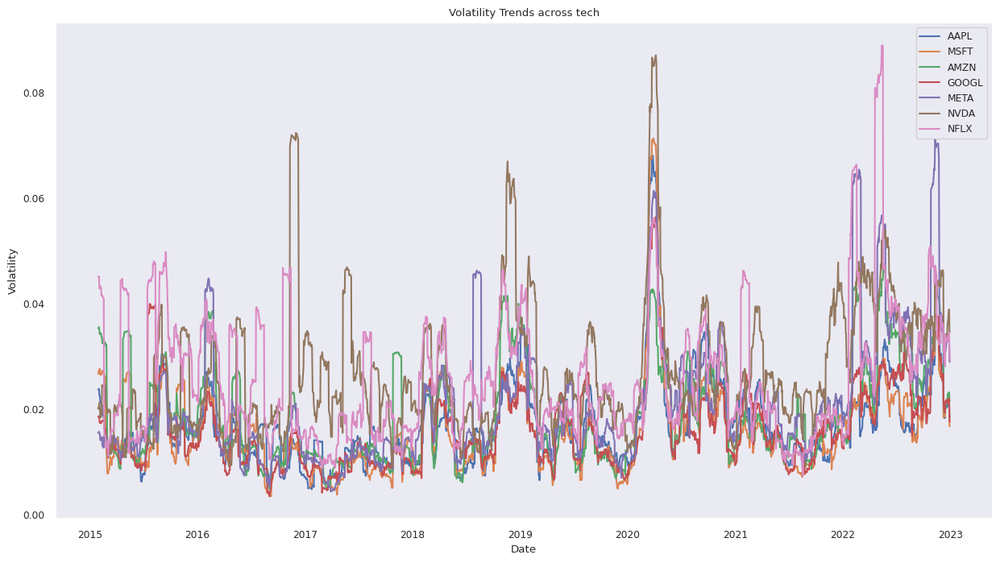

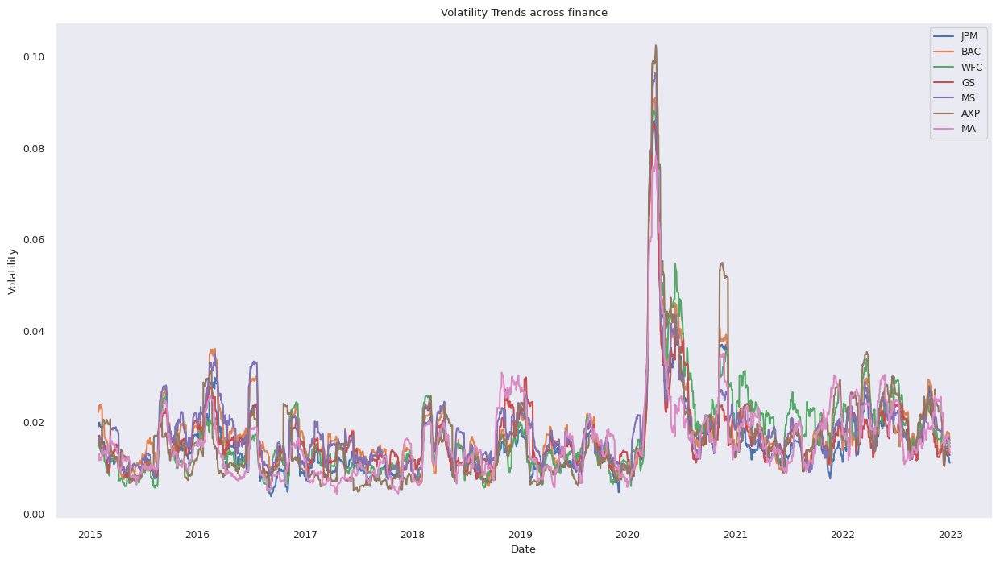

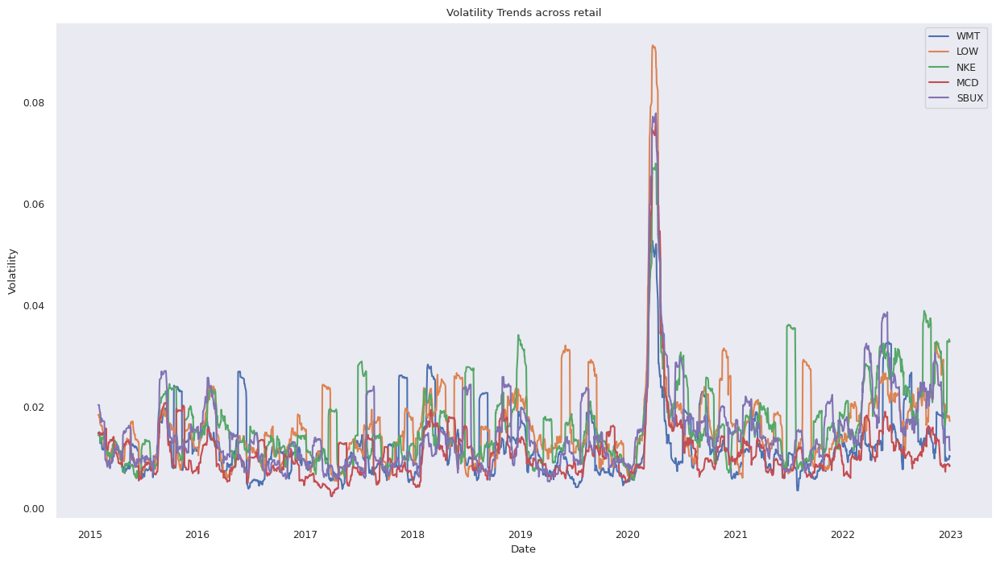

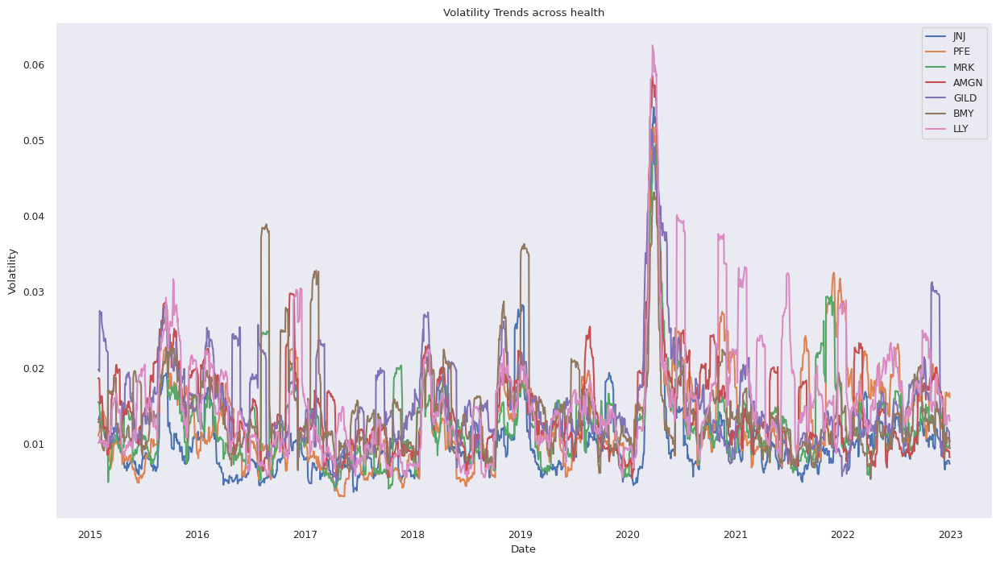

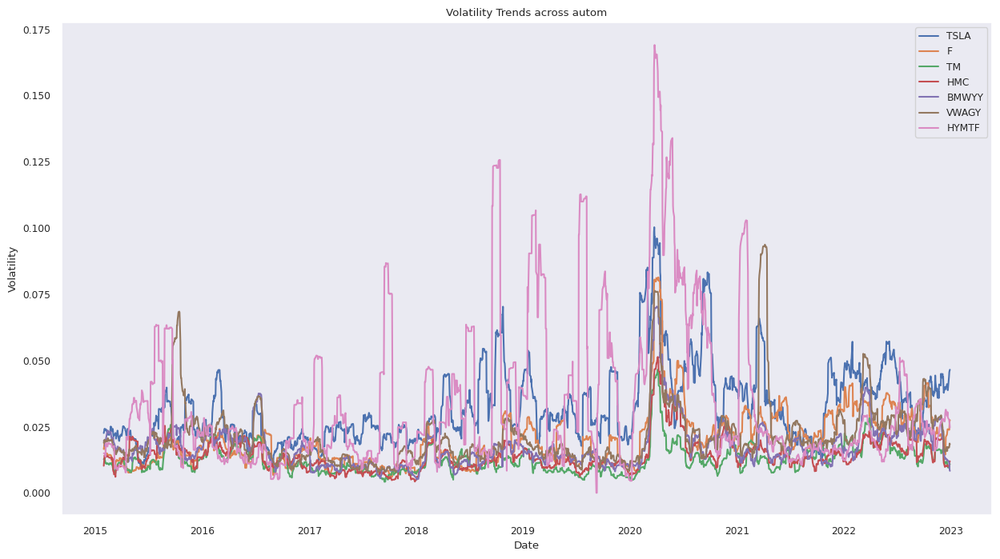

In [32]:
for sector, data in vol_data.items():
  plt.figure(figsize=(15, 8))

  for ticker, volatility in data.items():
    plt.plot(attribute_df.index, volatility, label=ticker)

  plt.title(f'Volatility Trends across {sector}')
  plt.xlabel('Date')
  plt.ylabel('Volatility')
  plt.legend()
  plt.grid()
  plt.show()


Oh Yeah! Extremely complicated!

Nah! we are gonna look for only the most volatile stocks in each sector in a periodical way.

These plots have been plotted sectro wise. So let's look for the outliers, i.e. the stocks with extreme volatility.

* From the tech sector we can see NFLX, NVDA, META being the most volatile. The same stocks were also having the wider band areas in Bollinger bands section.
* Coming to Finance sector, there are not many outliers almost all th stocks are less volatile. But, MS and BAC are having a litle high volatility but we could not see them in the bollinger bands analysis which is may be due to the low average price which tricked us in not considering them as volatile.

* Next, the Retail sector, all of them are not so volatile escept in a few time periods. But NKE and LOW are outliers when compared to the stocks of the same sector

* Same withe the health sector most of them are not so volatile but if we look for outliers, GILD and LLY are two stocks having high volatility compared to the other stocks of the health sector.

* Finally, the automobile sector, here, is the classic example where the bollinger bands may not reresent the high volatility of a stock, it's HYMTF being the most volatile stock out of every stock of all the sectors. It's extremely volatile which can be seen in the last graph where the pink plot is being oulying from all other stocks. Another stock TSLA is also having a high volatility but was been able to see that in the bollinger bands analysis. This is beacuse the TSLA is also having a good avergae price in the recent years.

### Seasonality Analysis.

#### Montly Average Returns.

Now, Let's analyse over seasons.

First, let's look at the sector-wise mothly average returns.


In [33]:
monthly_avg_returns = pd.DataFrame(index=range(1, 13))
for sector, df in all_dfs.items():
  adj_close = df.xs('Adj Close', level=1, axis=1)
  monthly_returns = df.groupby(adj_close.index.month).mean()
  monthly_avg_returns[sector] = monthly_returns.mean(axis=1)
monthly_avg_returns.index.name = 'Month'

In [34]:
monthly_avg_returns

,tech,finance,retail,health,autom
Month,,,,,
1,61.634655,52.428916,50.800063,43.618497,24.729057
2,61.950906,53.052858,50.350080,43.121683,24.135569
3,61.278486,51.726229,49.325728,43.733384,23.333356
4,62.484237,51.624369,50.639274,44.677359,23.649139
5,61.387161,52.037407,50.300194,44.583610,22.604612
6,63.326631,52.606630,50.641760,45.396557,22.989596
7,66.936309,53.519135,52.301569,46.821969,23.208687
8,67.993405,54.796155,53.655545,47.034874,24.067389
9,67.919765,54.194515,54.300881,46.545565,24.318014


Alright! let's visualize the monthly average returns.

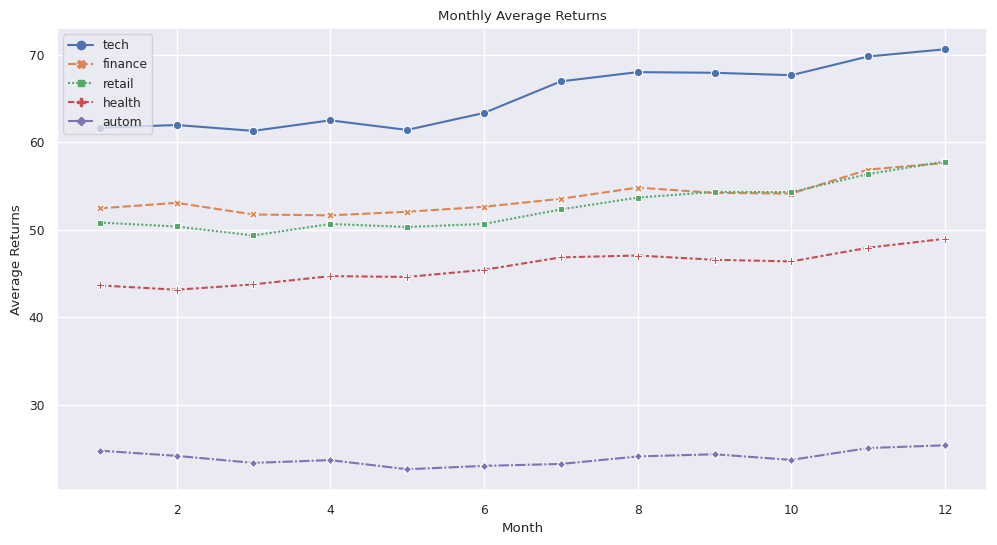

In [35]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=monthly_avg_returns, markers=True)
plt.xlabel('Month')
plt.ylabel('Average Returns')
plt.title('Monthly Average Returns')
plt.legend(loc='upper left')
plt.show()

Okay! So, here is the plot for average retiurns in a month in years 2015 to 2022. Following are the insights we can obtain from the plot above:

* 12th month or the month of Decemember is when every sector is having it's highest average returns out of all other months. Again, the price values is as we have seen in the plot of average retruns over years.

* Automobile sector being the most underperformed sector, is not having a significant increse or decrese in its returns in different months.

* The trend we can see in here is that the returns of every sector start with low returns in the early months of the year and end up getting higher returns at the end of the year.

* We can also see how stronly the finace and retail sectors are correlated.

#### Seasonal Decomposition

Now, let' look at the seasonal deconposition which includes 4 plots

<Figure size 1500x800 with 0 Axes>

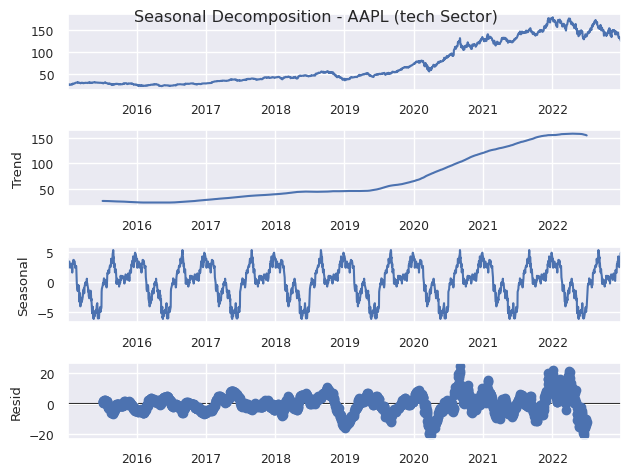

<Figure size 1500x800 with 0 Axes>

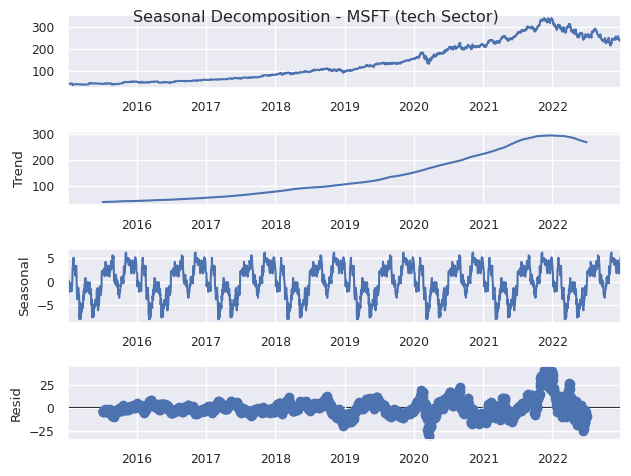

<Figure size 1500x800 with 0 Axes>

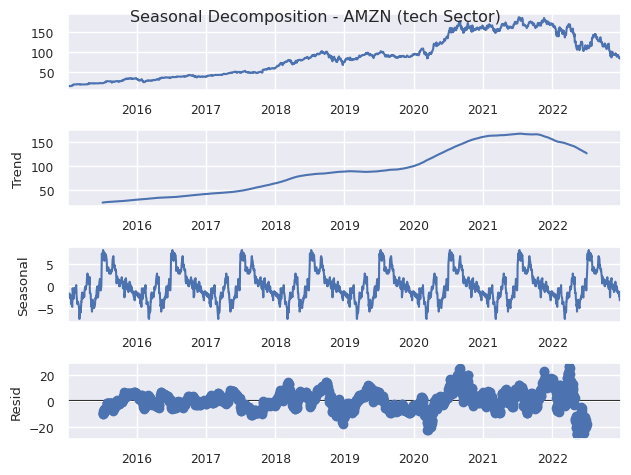

<Figure size 1500x800 with 0 Axes>

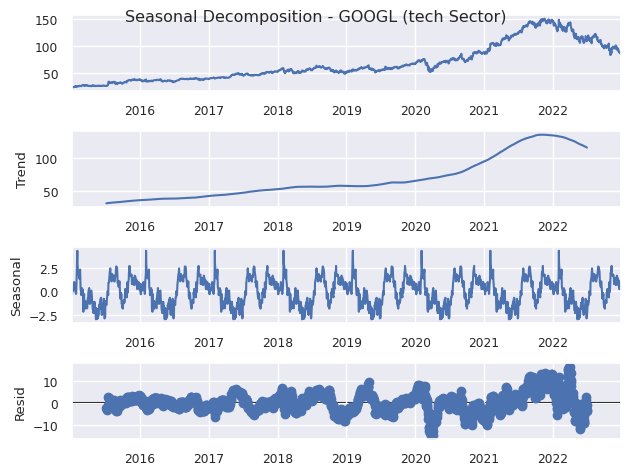

<Figure size 1500x800 with 0 Axes>

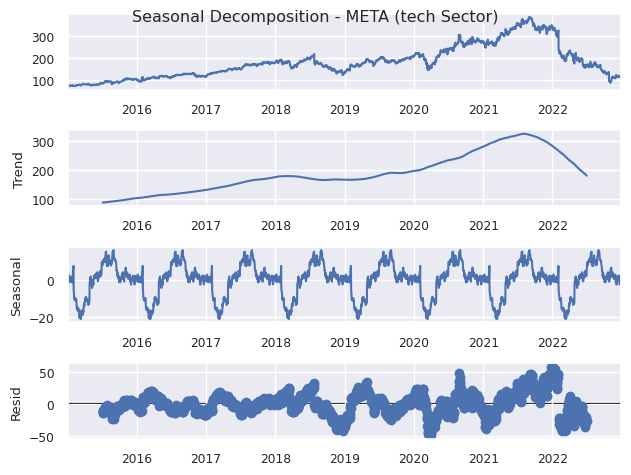

<Figure size 1500x800 with 0 Axes>

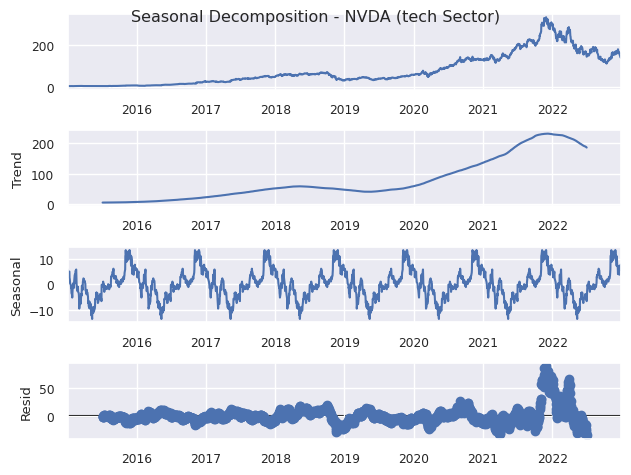

<Figure size 1500x800 with 0 Axes>

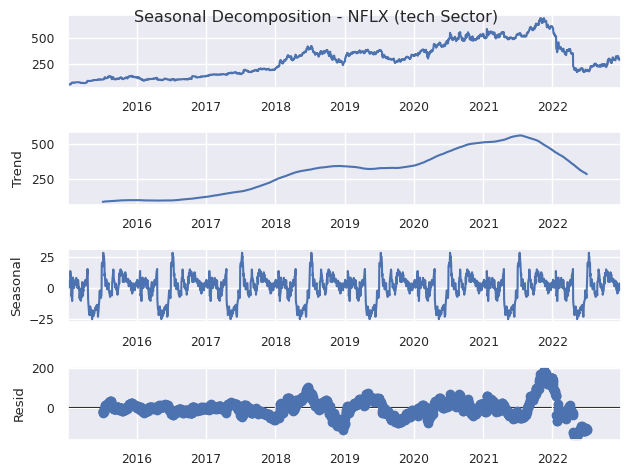

<Figure size 1500x800 with 0 Axes>

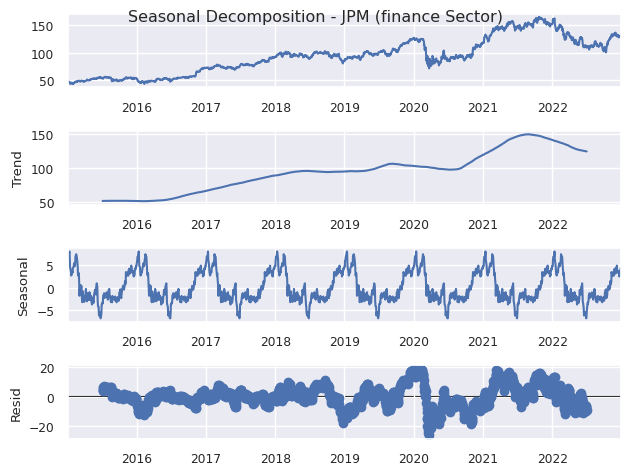

<Figure size 1500x800 with 0 Axes>

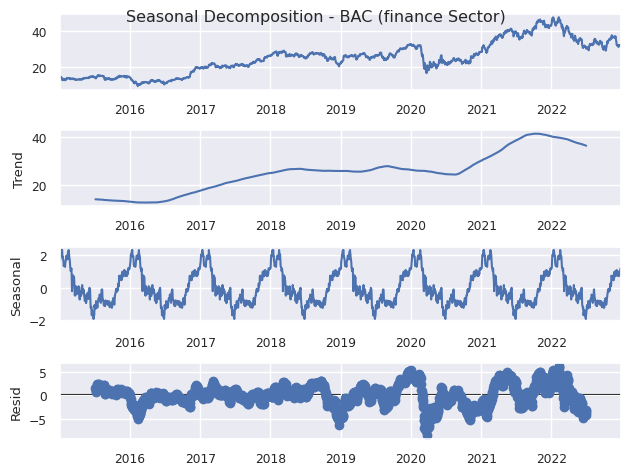

<Figure size 1500x800 with 0 Axes>

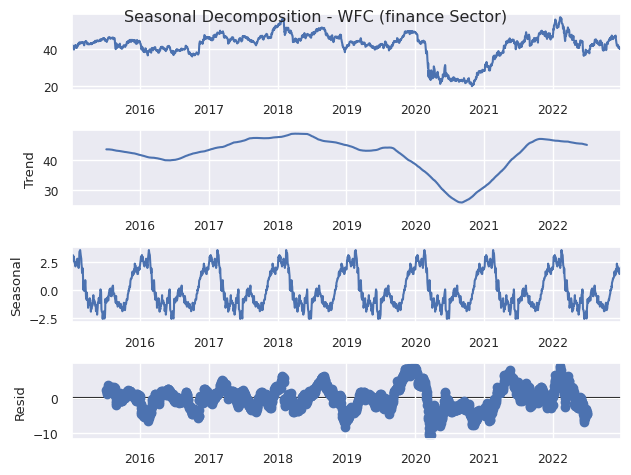

<Figure size 1500x800 with 0 Axes>

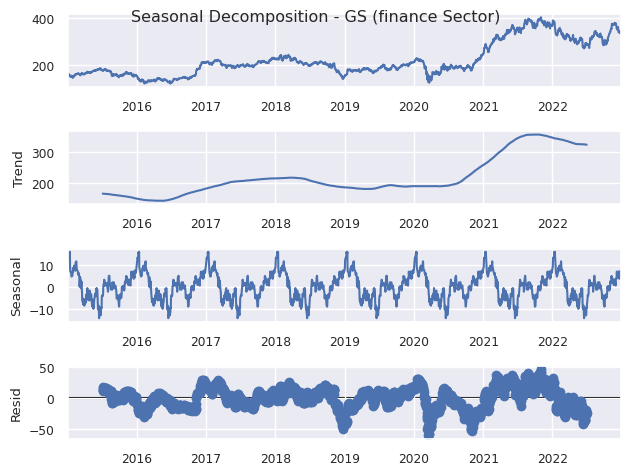

<Figure size 1500x800 with 0 Axes>

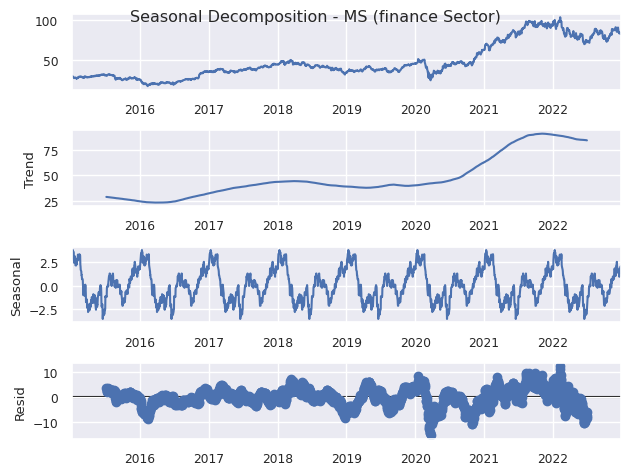

<Figure size 1500x800 with 0 Axes>

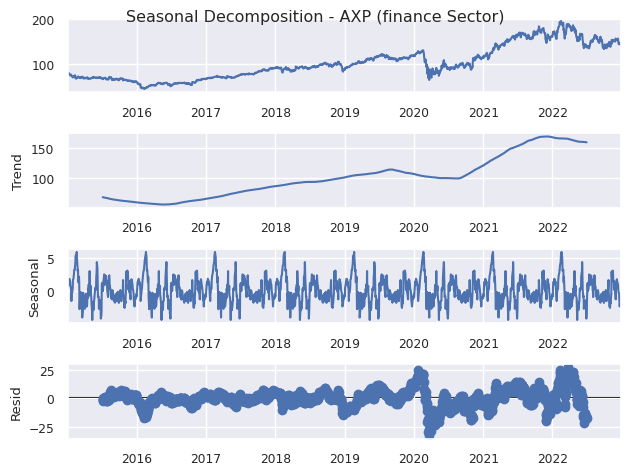

<Figure size 1500x800 with 0 Axes>

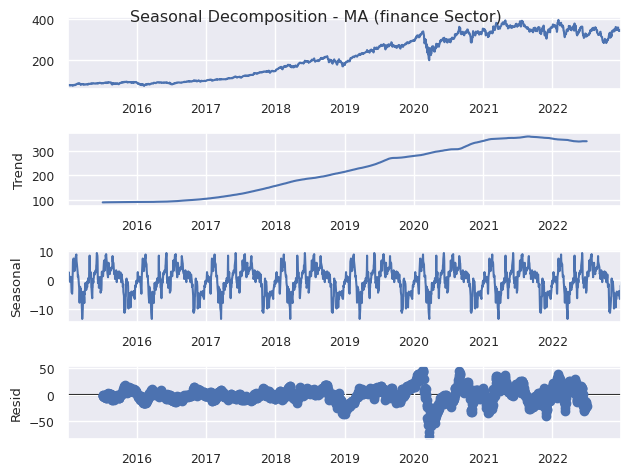

<Figure size 1500x800 with 0 Axes>

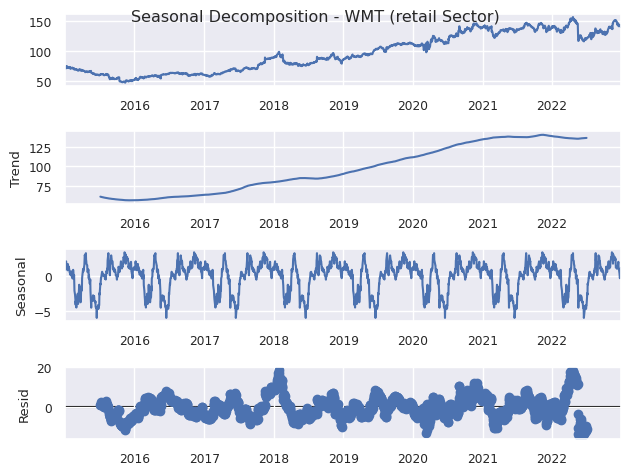

<Figure size 1500x800 with 0 Axes>

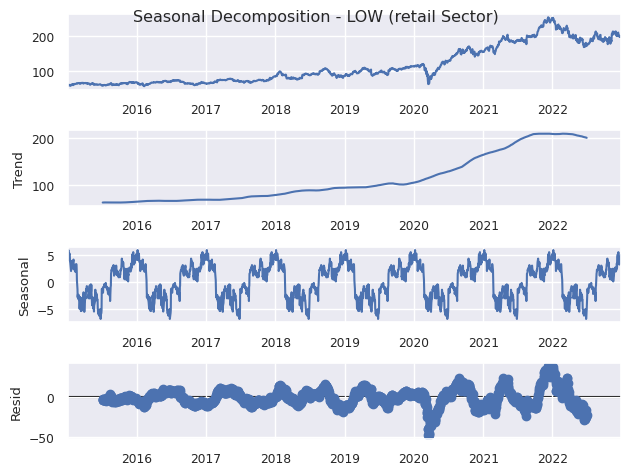

<Figure size 1500x800 with 0 Axes>

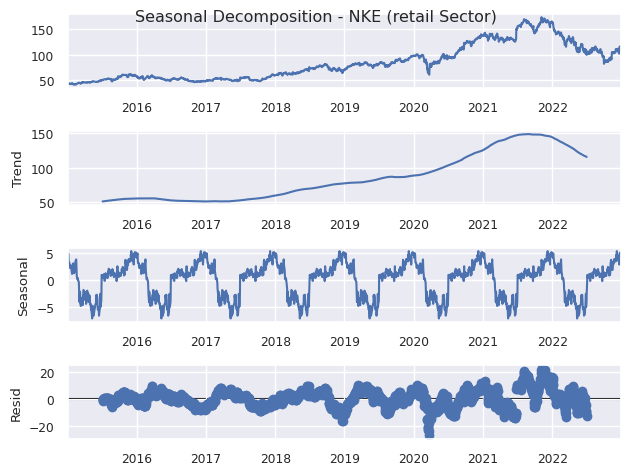

<Figure size 1500x800 with 0 Axes>

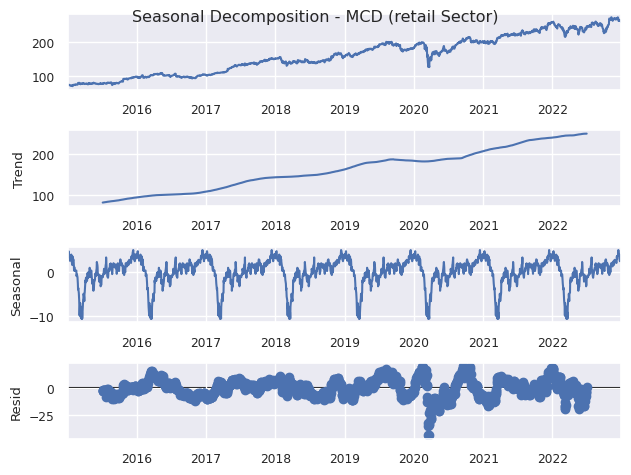

<Figure size 1500x800 with 0 Axes>

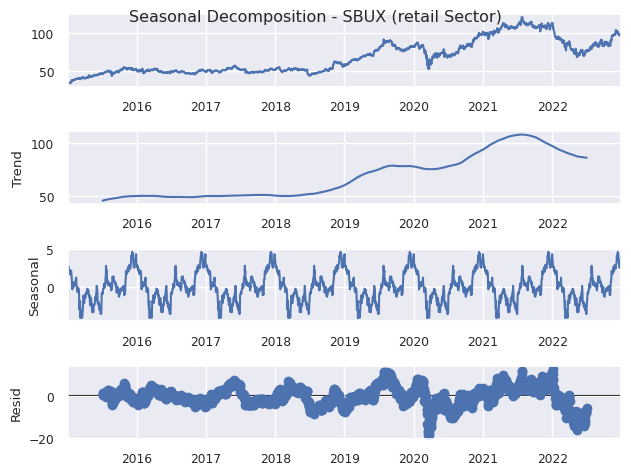

<Figure size 1500x800 with 0 Axes>

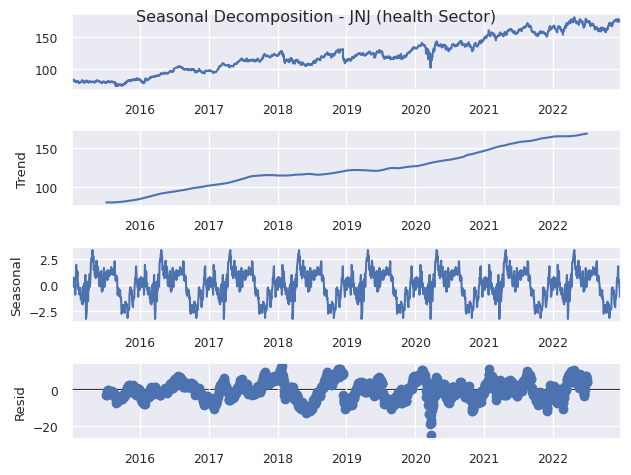

<Figure size 1500x800 with 0 Axes>

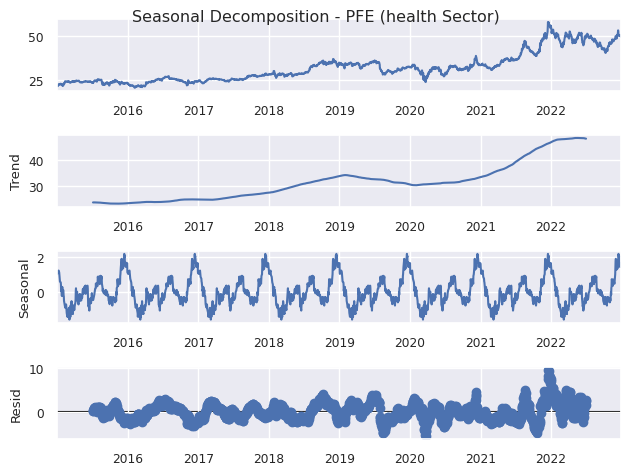

<Figure size 1500x800 with 0 Axes>

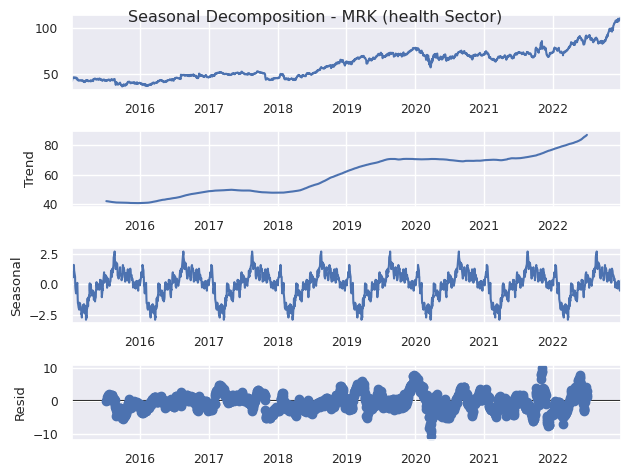

<Figure size 1500x800 with 0 Axes>

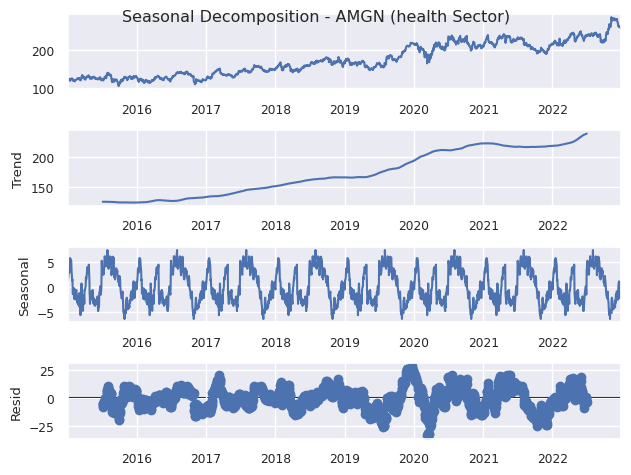

<Figure size 1500x800 with 0 Axes>

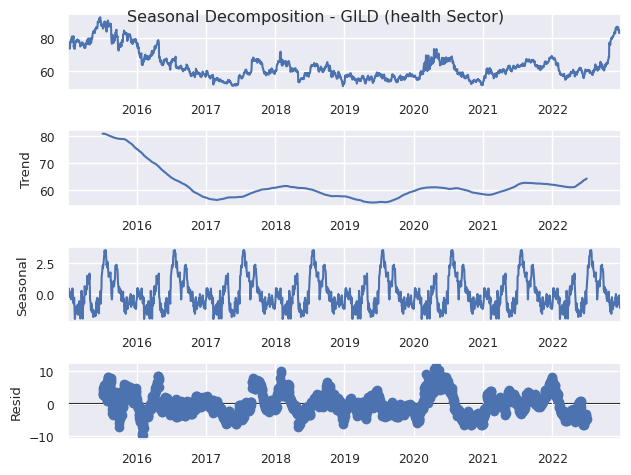

<Figure size 1500x800 with 0 Axes>

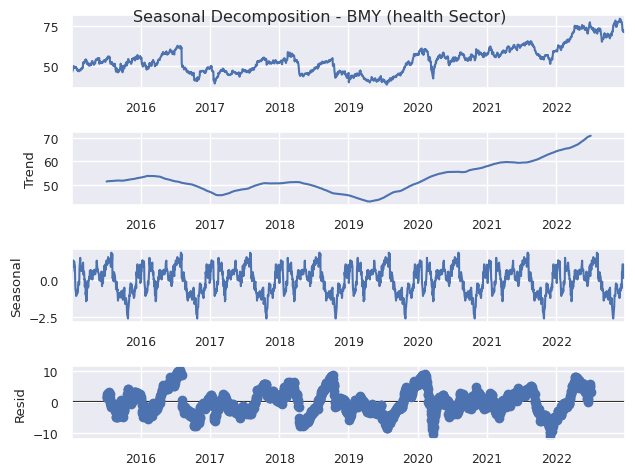

<Figure size 1500x800 with 0 Axes>

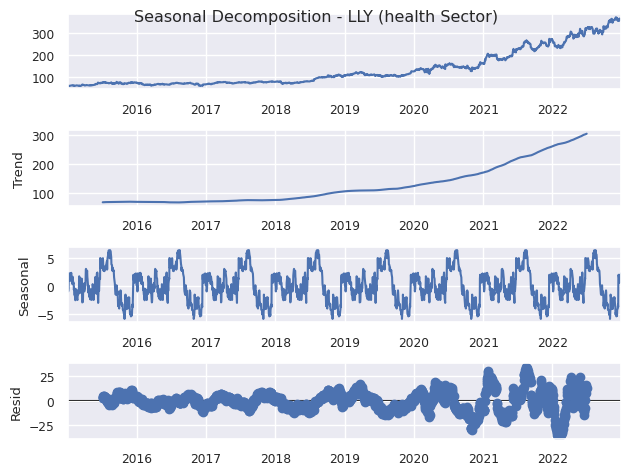

<Figure size 1500x800 with 0 Axes>

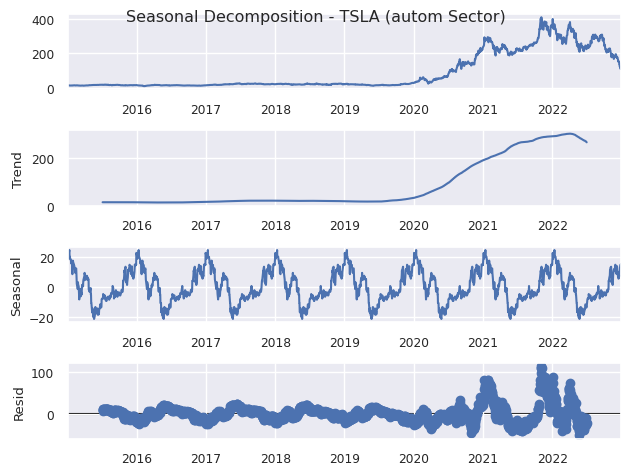

<Figure size 1500x800 with 0 Axes>

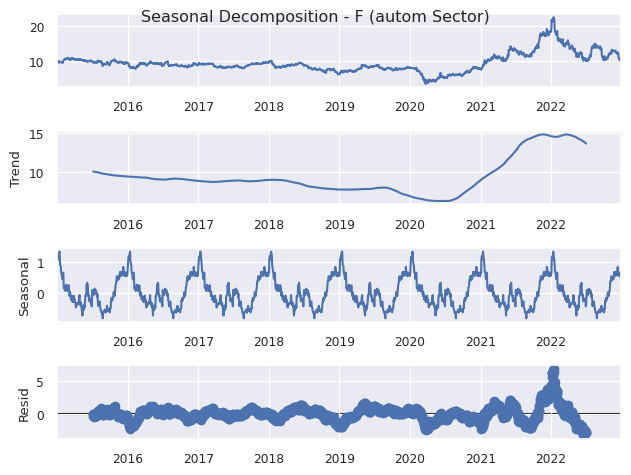

<Figure size 1500x800 with 0 Axes>

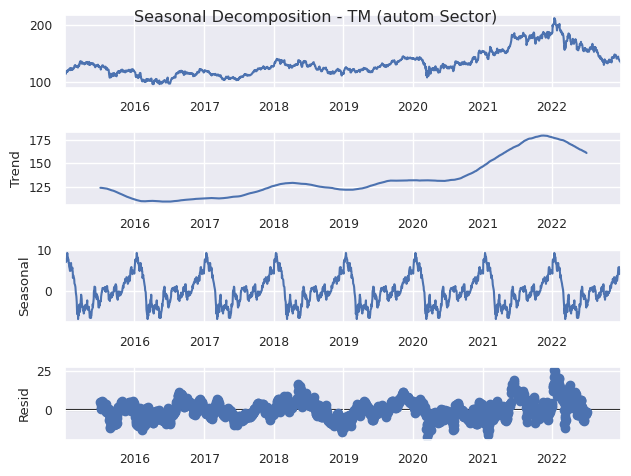

<Figure size 1500x800 with 0 Axes>

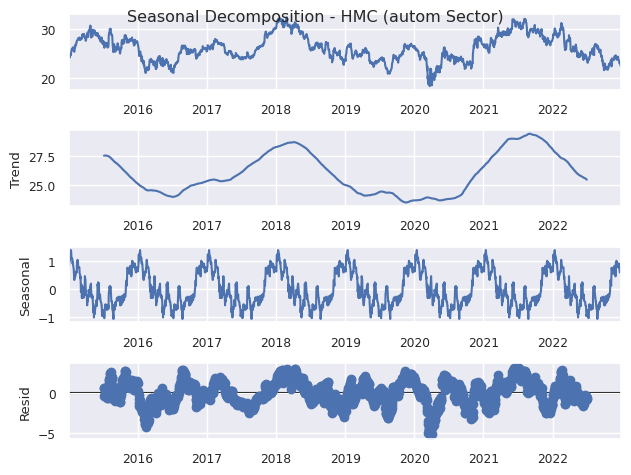

<Figure size 1500x800 with 0 Axes>

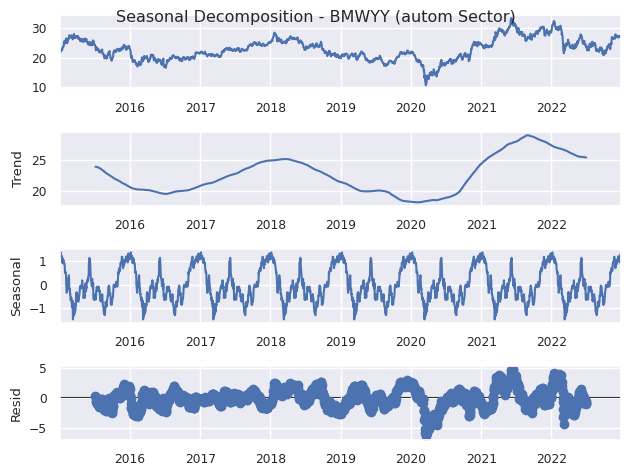

<Figure size 1500x800 with 0 Axes>

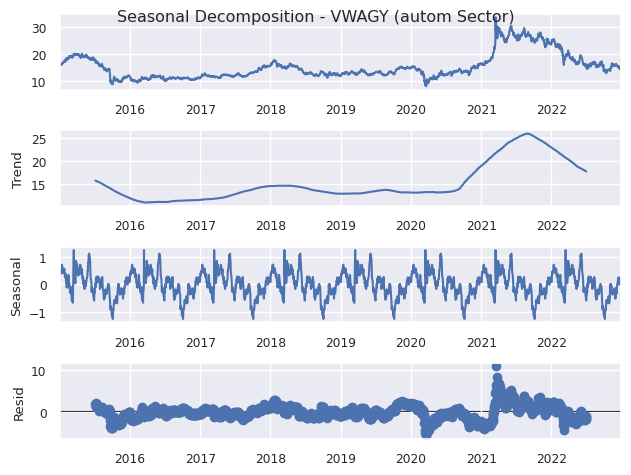

<Figure size 1500x800 with 0 Axes>

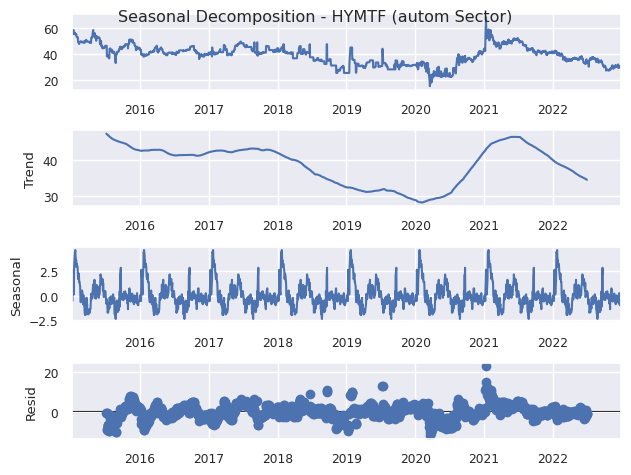

In [36]:
for sector, df in all_dfs.items():
  plotted_tickers = []  #to store the tickers which git plotted already

  for ticker in df.columns.get_level_values(0):
    if ticker not in plotted_tickers:
      adj_close = df.xs(('Adj Close'), axis=1, level=1, drop_level=False)[ticker]
      decomposition = seasonal_decompose(adj_close, model='additive', period=252)
      plt.figure(figsize=(15,8))
      decomposition.plot()
      plt.suptitle(f'Seasonal Decomposition - {ticker} ({sector} Sector)')
      plt.show()
      plotted_tickers.append(ticker)

There are lot of plots. Let's try to get a basic overview of the plots.

* Trend plot of the decomposition represents the long-term behavior of the time series. We can get to know whether teh stock price is increasing, decreasing or exhibiting any significant patterns over time.
  - We can see almost all plots have a similar trend of getting incresed by time from 2015 to 2023.
  - Few stocks which are a liitle differnet in their trend are WFC, HYMTF, F which have seen a fall in tge period of 2019-2021 and stocks like BMYY, HMC, GILD are having up and downs, in their trends, quite a few times in this period of time.

* Seasonal plot represents recurring patterns within a fixed period. We can identify regular seasonal fluctuations in stock prices like cyclic patterns at regular intervals of time.
  - We can see the repeated pattern in every stocks seasonal plot. We can look for the time period of each cycle to get more insights.

* Residual plot of decomposition represnts the random or unexplained variation in the time series data after removing the trend and seasonal components. Basically, we check if the patterns in residual compomnents plot gets captured in the trend and sesonal plots. If not captured then it suggests the presence of additional factors influencing the time series.
  - HYMTF, GILD, JNJ, WMT can be seen having different patterns in residula components plot which are not captured in the other two plots in some period of time like during COVID time period. But more or less we can see the smae patterns in all three plots

#### Sector-year-wise seasonal line plot

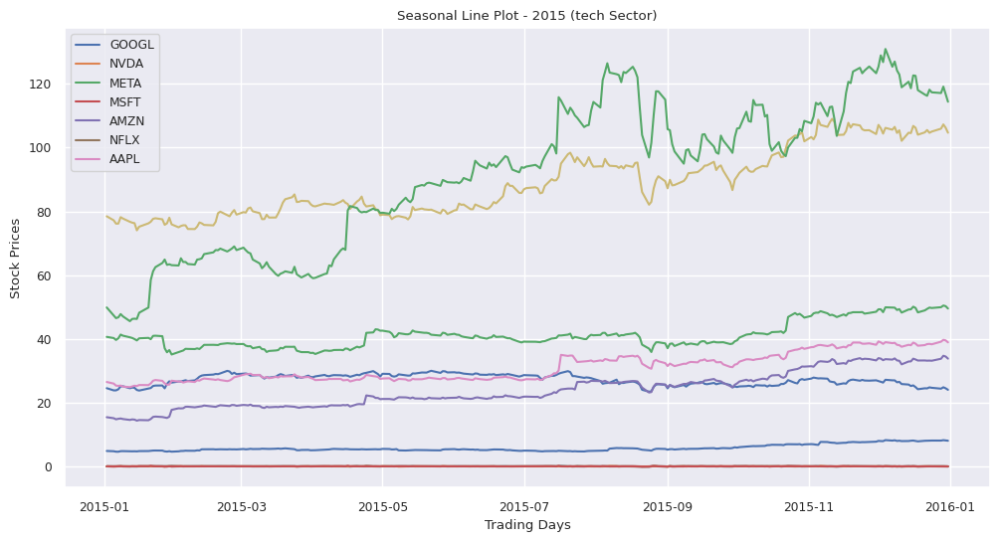

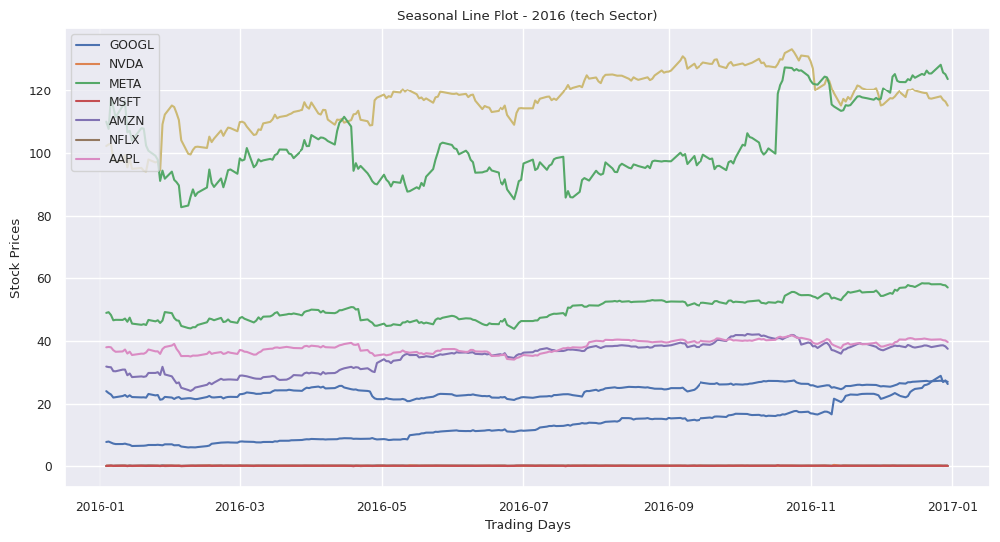

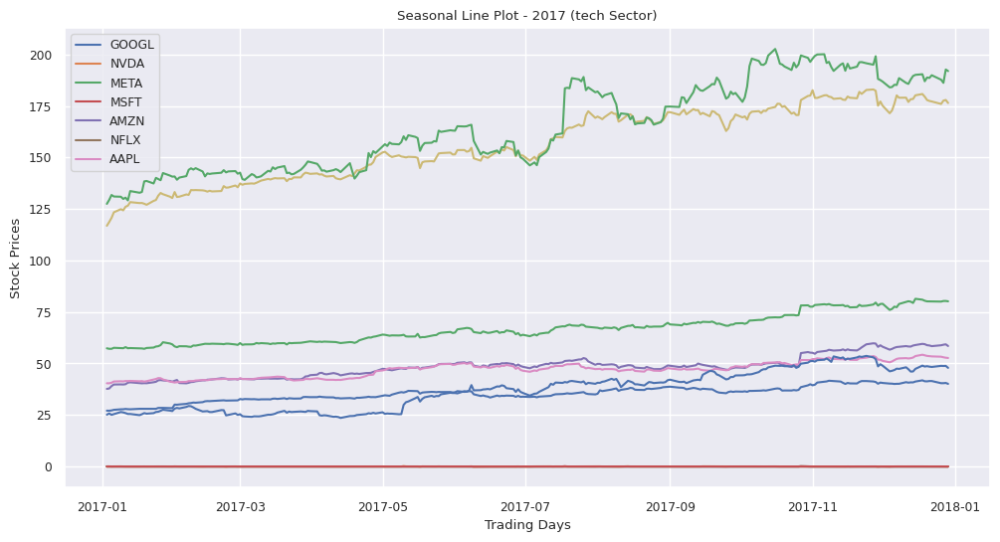

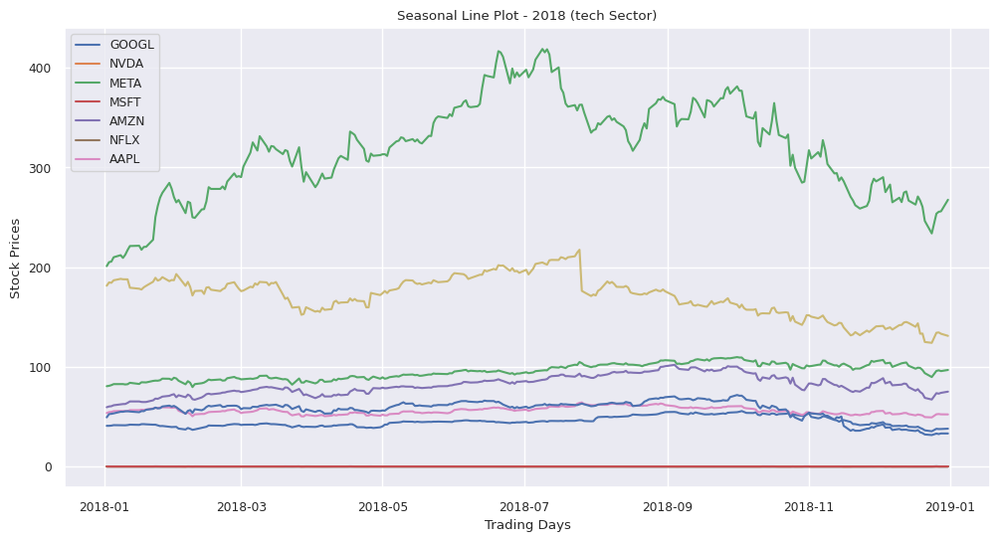

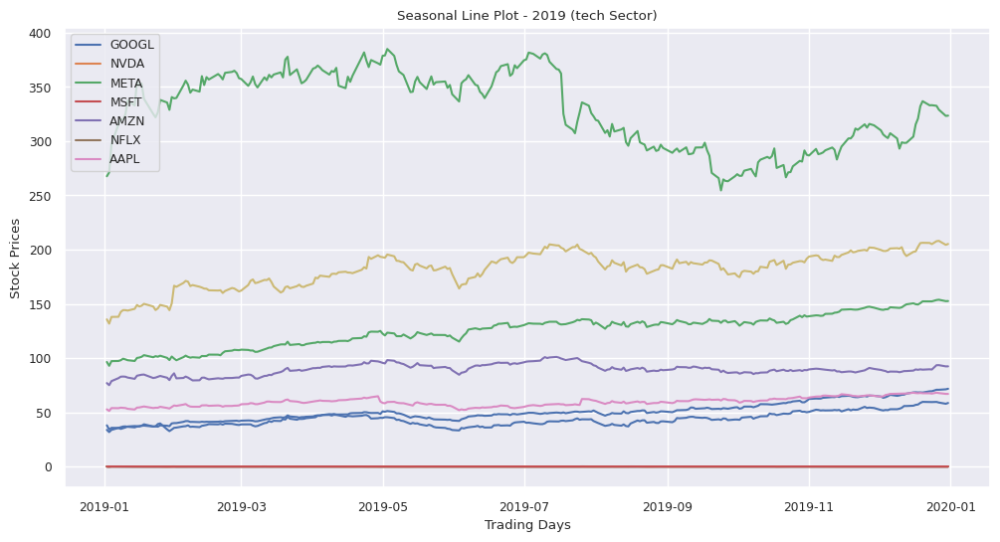

...

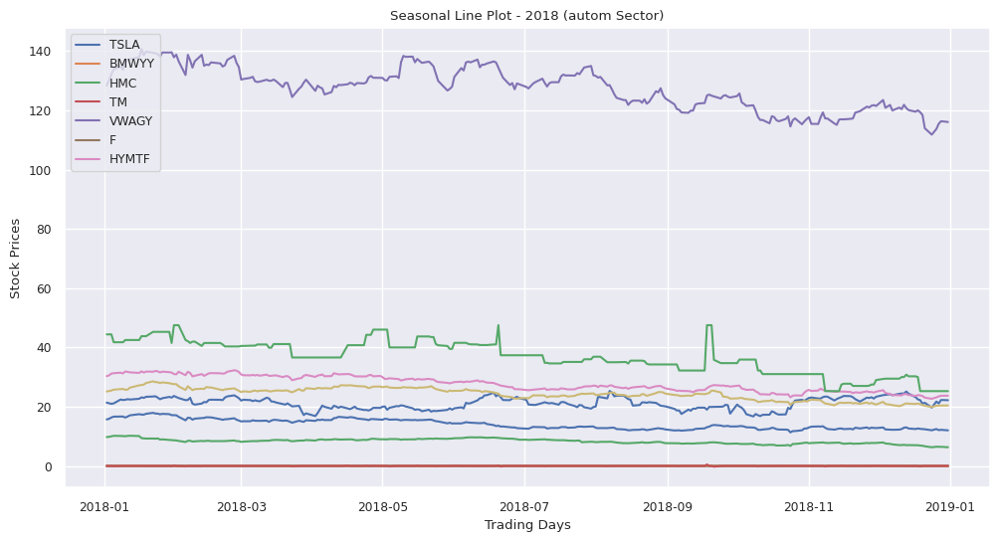

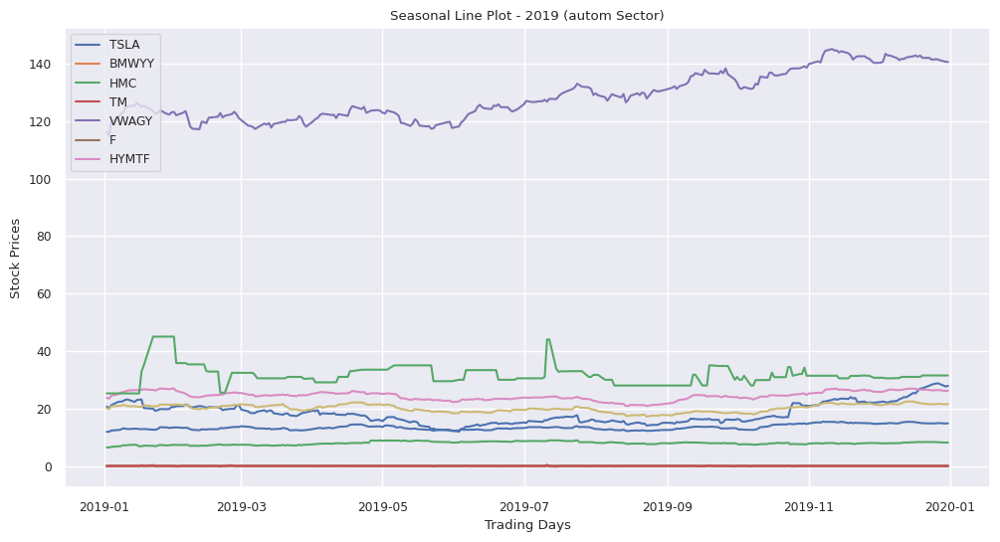

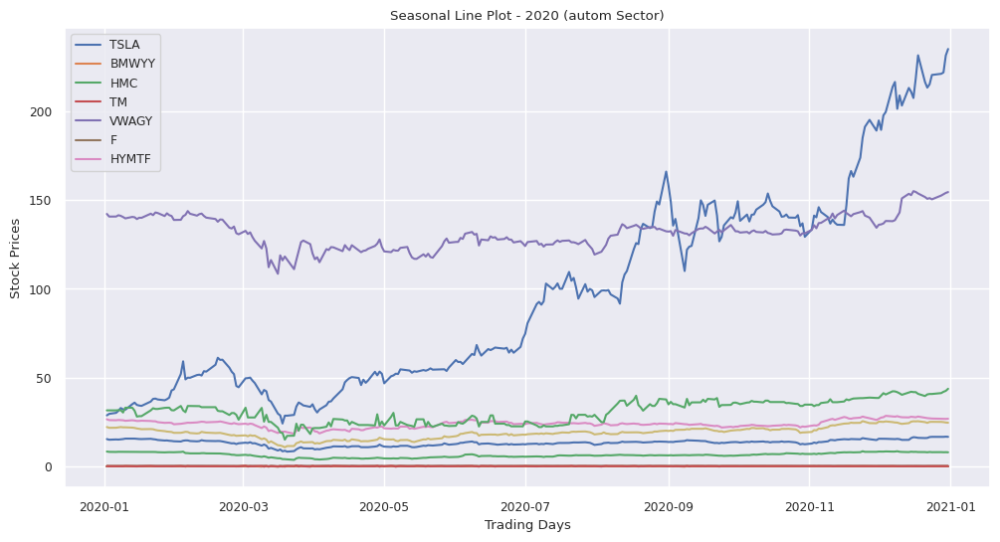

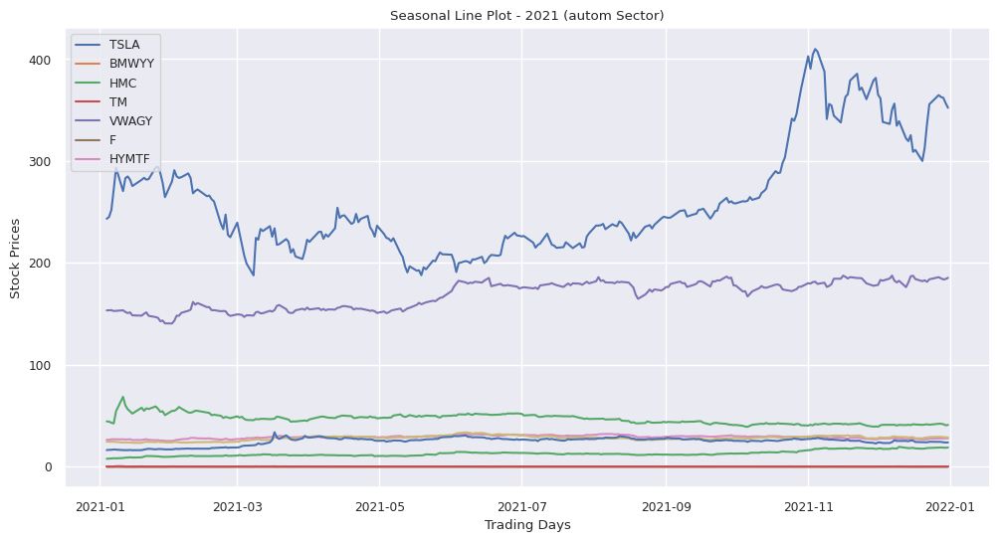

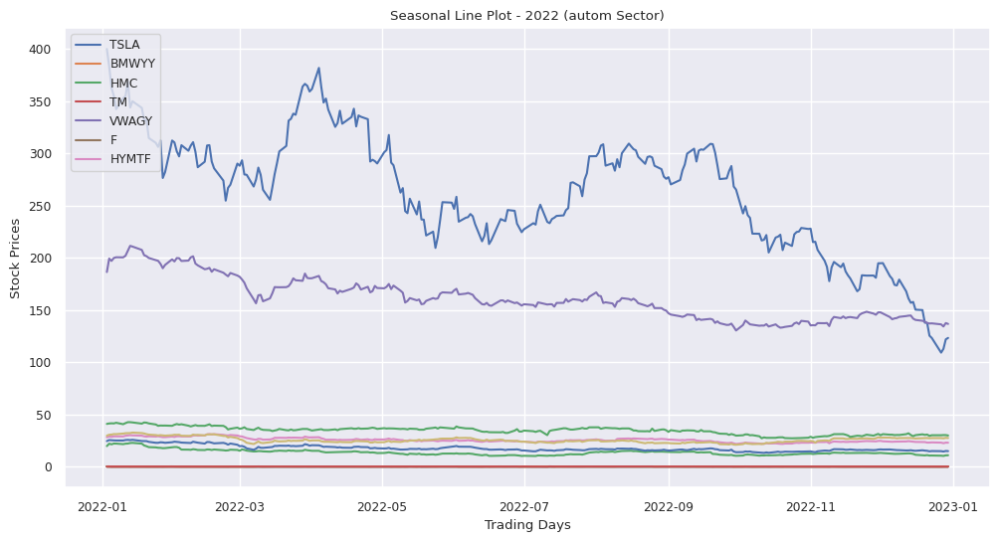

In [37]:
for sector, df in all_dfs.items():
  for year in range(2015, 2023):
    year_data = df[df.index.year == year]
    plt.figure(figsize=(12, 6))
    plotted_tickers = []  #to store the tickers which git plotted already

    for ticker in year_data.columns.get_level_values(0):
      if ticker not in plotted_tickers:
        plt.plot(year_data.index, year_data[ticker], label=ticker)
        plotted_tickers.append(ticker)

    plt.xlabel('Trading Days')
    plt.ylabel('Stock Prices')
    plt.title(f'Seasonal Line Plot - {year} ({sector} Sector)')

    handles, labels = plt.gca().get_legend_handles_labels()
    unique_labels = list(set(labels))  # Remove duplicate labels

    plt.legend(handles, unique_labels, loc='upper left')
    plt.show()

Okay! let's analyse these year-wise sector-wise plots.

* Tech sector
  - In 2015, we can see the rise of AMZN which outperformed NVDA and all other stocks were of a bit low price compared to NVDA and AMZN.
  - In the year 2016, we can see that the NVDA again took the highest price among tech stocks. But AMZN was also being on par with NVDA.In 2017 also both NVDA and AMZN outperformed the other stocks being on par with each other.
  - In the next few years from 2018 to 2021 AMZN outperformed every other stock and NVDA performed in the mediocre range. Rest of the stocks also started performing better.
  - IN the year 2022, every stock has seen drastic fall including AMZN and all performed equally in this year.

* Finance sector
  - In 2015, 2016 and 2017 we can see the stock values of BAC was higher compared to all other sectors and next comes MS which performed well compared to rest of teh stocks from the finance sector.
  - In 2018 BAC started seeing decline its stock vlaue and MS outperformed all the finance stocks from then.

* Retail sector
  - NKE is the stock which has been javing the higher stock value right from 2015 to 2022 and rest all of teh stocks were performing in simila way but LOW has seen significant rise across years.

* Helath sector
  - We can see the same trends in the stocks of health sector from 2015 to 2020. JNJ was having higher stock value compared to others.
  - But in mid 2021 BMY started out performing JNJ and in 2022 also it remained as the highest stock value in health sector.

* Automobile sector
  - In initial years, F has been the stock with the highest value. But in the year 2020 TSLA started outperforming it and has been the one with the highest stock value ever since in the automobile sector.

#### Seasonal Returns Heat Map.

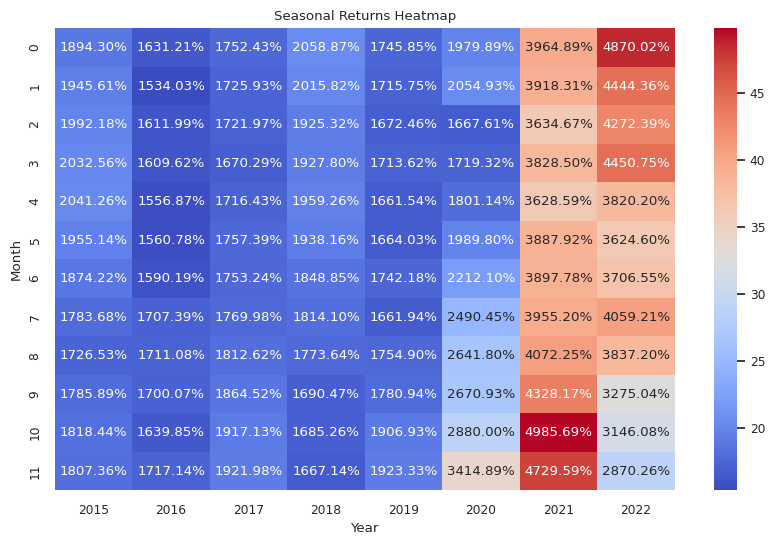

In [38]:
returns_heatmap = pd.DataFrame(index=range(1, 13), columns=range(2015, 2023))

for sector, df in all_dfs.items():
  monthly_returns = df.groupby([df.index.year, df.index.month]).mean()
  for month in range(1, 13):
    for year in range(2015, 2023):
      if (year, month) in monthly_returns.index:
        returns_heatmap.loc[month, year] = monthly_returns.loc[(year, month)].mean()

returns_heatmap = returns_heatmap.astype(float)  #typecast to float

plt.figure(figsize=(10, 6))
sns.heatmap(data=returns_heatmap.values, cmap='coolwarm', annot=True, fmt=".2%")
plt.xlabel('Year')
plt.ylabel('Month')

years = range(2015, 2023)
plt.xticks(np.arange(len(years)) + 0.5, years, rotation=0)

plt.title('Seasonal Returns Heatmap')
plt.show()

This heat map is na overall analysis of all sectors combined.

* We can see a slow increse in the returns from 2017 but which got changed in the late 2018 followed by a few fluctuations and finally getting incresed in year 2020 and had this significant incresing trend till the early months of 2022 from where the returns satrted decresing gradually. We have seen this decreseing trend in our previous anlysis as well.
* Sudden fall in the year starting of 2020 can be seen because of the COVID discrepency.

#### Seasonal Returns comaprision

<Figure size 1200x600 with 0 Axes>

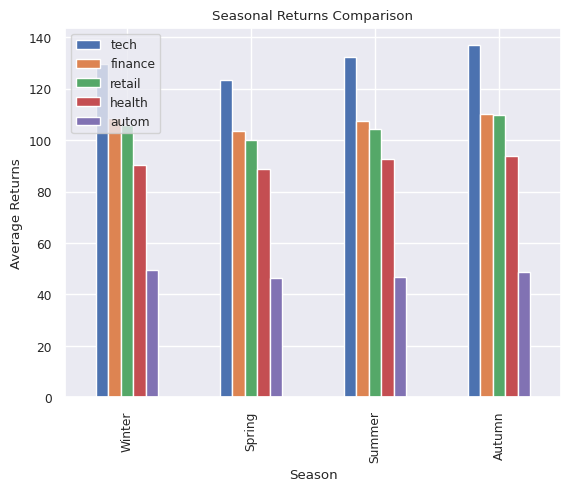

In [39]:
seasons = {
  1: 'Winter',
  2: 'Winter',
  3: 'Spring',
  4: 'Spring',
  5: 'Spring',
  6: 'Summer',
  7: 'Summer',
  8: 'Summer',
  9: 'Autumn',
  10: 'Autumn',
  11: 'Autumn',
  12: 'Winter'
}

seasonal_returns_comparison = pd.DataFrame(index=['Winter', 'Spring', 'Summer', 'Autumn'])

for sector, df in all_dfs.items():
  tickers = df.columns.get_level_values(0).unique()
  sector_returns = []

  for ticker in tickers:
    col_returns = [(ticker, 'Adj Close')]
    seasonal_returns = df.groupby(df.index.month)[col_returns].mean()
    seasonal_returns['Month'] = df.index.month.unique()
    seasonal_returns['Season'] = seasonal_returns['Month'].map(seasons)


    seasonal_returns = seasonal_returns.groupby('Season').mean()[col_returns]
    sector_returns.append(seasonal_returns)

  sector_returns_df = pd.concat(sector_returns, axis=1)
  seasonal_returns_comparison[sector] = sector_returns_df.mean(axis=1)

plt.figure(figsize=(12, 6))
seasonal_returns_comparison.plot(kind='bar')
plt.xlabel('Season')
plt.ylabel('Average Returns')
plt.title('Seasonal Returns Comparison')
plt.legend(loc='upper left')
plt.show()

More or less we can see the same amount of returns in all the seasons.
* In autumn we can see the highest amount of returns in every sector.
* This can expected before itself during the monthly average returns analysis where we have seen almost the same amount of returns in all months. bUth the starting and ending months had a significant diffrence. Buft, in here, the starting and ending months are mapped to winter which made the avergae return values normalized.

#### Sector-wise monthly Average Volatility

<Figure size 1200x600 with 0 Axes>

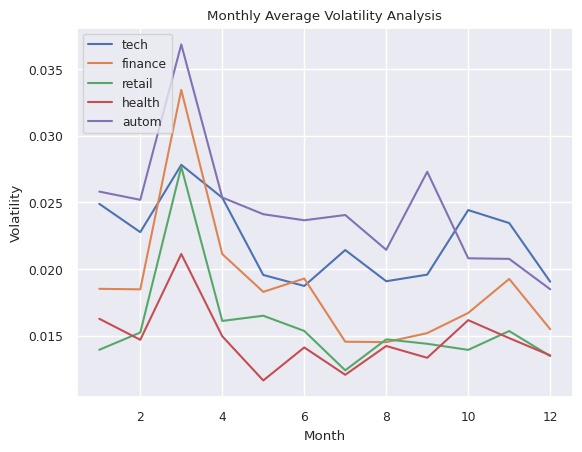

In [40]:
#empty DataFrame to store monthly average volatility
monthly_avg_volatility = pd.DataFrame(index=range(1, 13))

for sector, df in all_dfs.items():
  adj_close_cols = [(ticker, 'Adj Close') for ticker in df.columns.get_level_values(0)]
  returns = df[adj_close_cols].pct_change()
  monthly_volatility = returns.groupby(df.index.month).var() ** 0.5

  #mean of monthly volatilities for each sector
  sector_avg_volatility = monthly_volatility.mean(axis=1)

  # Adding to the empty dataframe
  monthly_avg_volatility[sector] = sector_avg_volatility

monthly_avg_volatility.index.name = 'Month'


plt.figure(figsize=(12, 6))
monthly_avg_volatility.plot()
plt.xlabel('Month')
plt.ylabel('Volatility')
plt.title('Monthly Average Volatility Analysis')
plt.legend(loc='upper left')
plt.show()

We have seen volatility plots over years. now, let's analyse the monthly volatilities.

* March or the 3rd month of the year is where we can see teh highest volatility among all te sectors.

* Automobile sector being the most volatile sector followed by the tech and finace sectors. The same has been concludeed in the volatility anlyssis over years also.

* Health sector is the least volatile of all the sectors.


Alright We are done with the anlysis but one stock is more interesting than any other stock we've seen and it's TSLA. It has underperformed compared to the stocks from others sectors in the initial years just like the stocks from the same automobile sector. But, later, from Mid-2018 onwards it has outperformed many other stocks form different sectors and it was one of the extremely high valued stocks.

So, what made it to perform so good from 2018. There are a few popular opinions on this topic. Let's consider one such incident which had an impact on the stock value of TSLA. Let's look for the impact and try to measure it using Causal Impact Analysis.

## Causal Impact Analysis.

We have seen an impecable growth in the stock value of TSLA in recent yers.

Now, let's analyse and measure the amount of impact of a tweet by Elon Musk had on the stock value of TSLA.

**Incident:**
Elon Musk's tweet on August 7, 2018, where he stated that he was considering taking Tesla private and had secured funding. This tweet caused a surge in Tesla's stock price and created a lot of market volatility.

First, the date on which he tweeted was `2018-08-07`. So, let's choose the start and end dates of both training and treatment periods.

In [41]:
train_start = "2016-12-30"
train_end = "2018-08-06"
treatment_start = "2018-08-08"
treatment_end = "2018-09-06"
end_stock = "2018-10-07"

We are having the stock data downloaded and made into a dataframe.

Control groups can be first chosen as all the stocks other than the automible sector.
> It's better not to consider the stocks from the same sector even if we get a high correlation.

We are also having the stock data ready of the control groups.

The dataframe we can consider in here is the `combined_df. But we have to drop the other autombile stocks from it.

The most important thing is getting the training dataframe out of it.

In [42]:
combined_df.head()

AAPL                      MSFT                     AMZN  \
            Adj Close Lagged_Returns  Adj Close Lagged_Returns Adj Close   
Date                                                                       
2015-01-02  24.531765       0.000000  40.620659       0.000000   15.4260   
2015-01-05  23.840666      -0.028172  40.247135      -0.009195   15.1095   
2015-01-06  23.842911       0.000094  39.656403      -0.014678   14.7645   
2015-01-07  24.177242       0.014022  40.160248       0.012705   14.9210   
2015-01-08  25.106182       0.038422  41.341702       0.029418   15.0230   

                               GOOGL                      META                 \
           Lagged_Returns  Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date                                                                            
2015-01-02       0.000000  26.477501       0.000000  78.449997       0.000000   
2015-01-05      -0.020517  25.973000      -0.019054  77.190002      -0.016061   
2015-01-06      -0.022833  25.332001      -0.024679  76.150002      -0.013473   
2015-01-07       0.010600  25.257500      -0.002941  76.150002       0.000000   
2015-01-08       0.006836  25.345501       0.003484  78.180000       0.026658   

            ...          TM                       HMC                 \
            ...   Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date        ...                                                        
2015-01-02  ...  118.139427       0.000000  24.785105       0.000000   
2015-01-05  ...  115.977249      -0.018302  24.274157      -0.020615   
2015-01-06  ...  114.783348      -0.010294  24.140139      -0.005521   
2015-01-07  ...  117.669388       0.025143  24.383049       0.010063   
2015-01-08  ...  119.934975       0.019254  24.692963       0.012710   

                BMWYY                     VWAGY                     HYMTF  \
            Adj Close Lagged_Returns  Adj Close Lagged_Returns  Adj Close   
Date                                                                        
2015-01-02  22.876278       0.000000  16.460857       0.000000  56.750000   
2015-01-05  21.949038      -0.040533  15.838782      -0.037791  56.500000   
2015-01-06  21.987944       0.001773  16.012119       0.010944  55.270000   
2015-01-07  22.201923       0.009732  16.096861       0.005292  56.200001   
2015-01-08  22.759562       0.025117  16.505154       0.025365  57.250000   

                           
           Lagged_Returns  
Date                       
2015-01-02       0.000000  
2015-01-05      -0.004405  
2015-01-06      -0.021770  
2015-01-07       0.016826  
2015-01-08       0.018683  

[5 rows x 66 columns]

In [43]:
combined_df_2 = combined_df.drop(columns = ['F','TM', 'HMC', 'BMWYY', 'VWAGY', 'HYMTF'])

<ipython-input-43-78b42e6afd95>:1: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  combined_df_2 = combined_df.drop(columns = ['F','TM', 'HMC', 'BMWYY', 'VWAGY', 'HYMTF'])


In [44]:
df_training2 = combined_df_2[combined_df.index <= train_end]
df_training2.tail()

AAPL                       MSFT                      AMZN  \
            Adj Close Lagged_Returns   Adj Close Lagged_Returns  Adj Close   
Date                                                                         
2018-07-31  45.463871       0.002001  100.330223       0.006738  88.872002   
2018-08-01  48.142147       0.058910  100.519386       0.001885  89.858498   
2018-08-02  49.549374       0.029231  101.739464       0.012138  91.716499   
2018-08-03  49.692726       0.002893  102.183983       0.004369  91.164497   
2018-08-06  49.950768       0.005193  102.269112       0.000833  92.387497   

                               GOOGL                       META  \
           Lagged_Returns  Adj Close Lagged_Returns   Adj Close   
Date                                                              
2018-07-31      -0.001000  61.361000      -0.002293  172.580002   
2018-08-01       0.011100  61.649502       0.004702  171.649994   
2018-08-02       0.020677  62.056499       0.006602  176.369995   
2018-08-03      -0.006019  61.908001      -0.002393  177.779999   
2018-08-06       0.013415  61.883499      -0.000396  185.690002   

                           ...        AMGN                      GILD  \
           Lagged_Returns  ...   Adj Close Lagged_Returns  Adj Close   
Date                       ...                                         
2018-07-31       0.008886  ...  169.053802       0.031055  63.771378   
2018-08-01      -0.005389  ...  168.443054      -0.003613  63.828743   
2018-08-02       0.027498  ...  168.907562       0.002758  63.607506   
2018-08-03       0.007995  ...  170.292328       0.008198  63.853329   
2018-08-06       0.044493  ...  169.965485      -0.001919  63.804157   

                                 BMY                       LLY                 \
           Lagged_Returns  Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date                                                                            
2018-07-31       0.019785  50.644878      -0.003054  90.562653       0.008060   
2018-08-01       0.000900  51.394855       0.014809  90.461823      -0.001113   
2018-08-02      -0.003466  51.093132      -0.005871  91.167564       0.007802   
2018-08-03       0.003865  50.998314      -0.001856  92.184921       0.011159   
2018-08-06      -0.000770  51.196579       0.003888  93.486389       0.014118   

                 TSLA                 
            Adj Close Lagged_Returns  
Date                                  
2018-07-31  19.875999       0.027467  
2018-08-01  20.056000       0.009056  
2018-08-02  23.302668       0.161880  
2018-08-03  23.211332      -0.003920  
2018-08-06  22.799334      -0.017750  

[5 rows x 54 columns]

Now, its time to g othrough the correlations of TSLA with other stocks to cutdown the stocks which are less correlated with TSLA from the control group.

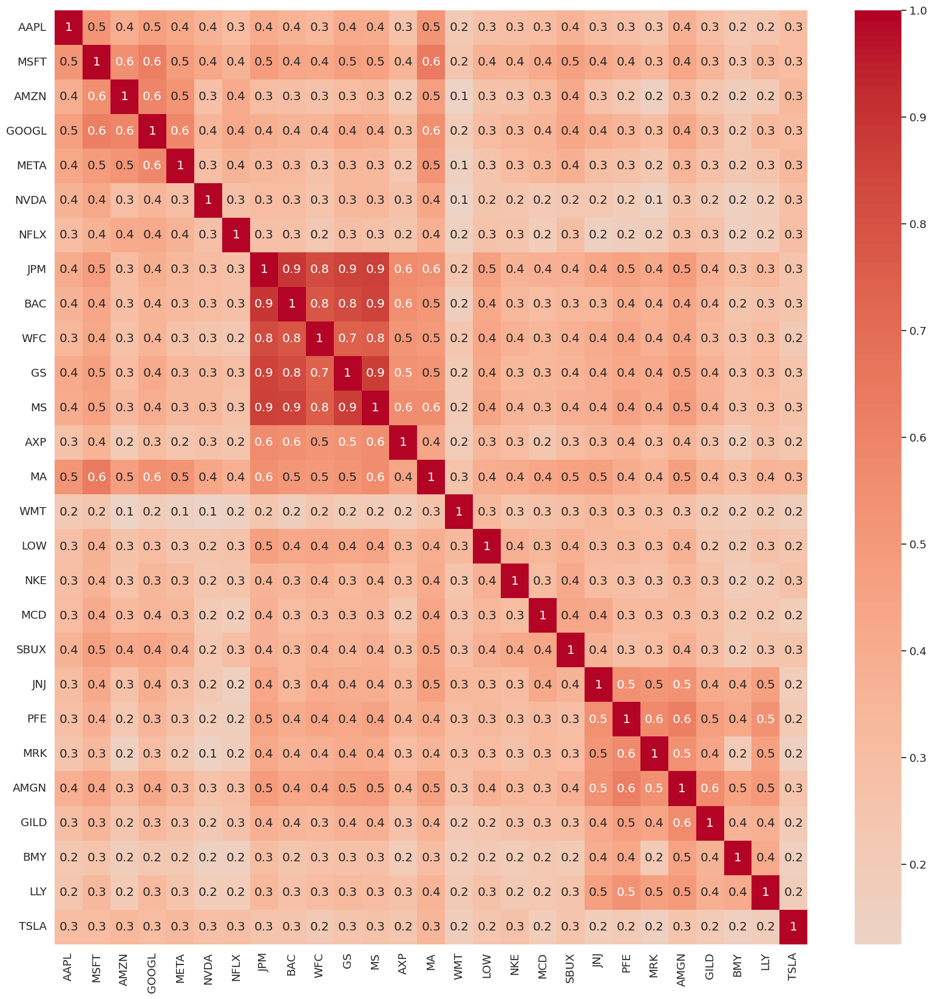

In [45]:
#Heatmap
lagged_returns = df_training2.xs('Lagged_Returns', axis=1, level=1)
correlation_matrix = lagged_returns.dropna().corr()
plt.figure(figsize = (20,20))
sns.set(font_scale = 1.2)
sns.heatmap(data = correlation_matrix,
            annot = True,
            fmt = '.1g',
            cmap = 'coolwarm',
            center = 0);

It may look overwhelming but what we basically need is the last column or the last row because we are only concerned about the correlation of TSLA with other stocks.

We could not see a great correlation but we can now consider only the stocks with correlation greeater than 0.2 as control group.

In [46]:
df_final = combined_df_2.drop(columns = ["WFC", "AXP", "WMT", "LOW", "MCD", "JNJ", "PFE", "MRK", "GILD", "BMY", "LLY"])
df_final.head()

<ipython-input-46-b73d7c3a51e4>:1: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df_final = combined_df_2.drop(columns = ["WFC", "AXP", "WMT", "LOW", "MCD", "JNJ", "PFE", "MRK", "GILD", "BMY", "LLY"])


AAPL                      MSFT                     AMZN  \
            Adj Close Lagged_Returns  Adj Close Lagged_Returns Adj Close   
Date                                                                       
2015-01-02  24.531765       0.000000  40.620659       0.000000   15.4260   
2015-01-05  23.840666      -0.028172  40.247135      -0.009195   15.1095   
2015-01-06  23.842911       0.000094  39.656403      -0.014678   14.7645   
2015-01-07  24.177242       0.014022  40.160248       0.012705   14.9210   
2015-01-08  25.106182       0.038422  41.341702       0.029418   15.0230   

                               GOOGL                      META                 \
           Lagged_Returns  Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date                                                                            
2015-01-02       0.000000  26.477501       0.000000  78.449997       0.000000   
2015-01-05      -0.020517  25.973000      -0.019054  77.190002      -0.016061   
2015-01-06      -0.022833  25.332001      -0.024679  76.150002      -0.013473   
2015-01-07       0.010600  25.257500      -0.002941  76.150002       0.000000   
2015-01-08       0.006836  25.345501       0.003484  78.180000       0.026658   

            ...         MA                       NKE                 \
            ...  Adj Close Lagged_Returns  Adj Close Lagged_Returns   
Date        ...                                                       
2015-01-02  ...  81.266785       0.000000  43.370159       0.000000   
2015-01-05  ...  78.980904      -0.028128  42.671879      -0.016100   
2015-01-06  ...  78.810181      -0.002162  42.420883      -0.005882   
2015-01-07  ...  80.036110       0.015555  43.297138       0.020656   
2015-01-08  ...  81.280991       0.015554  44.296619       0.023084   

                 SBUX                       AMGN                      TSLA  \
            Adj Close Lagged_Returns   Adj Close Lagged_Returns  Adj Close   
Date                                                                         
2015-01-02  34.774391       0.000000  125.844635       0.000000  14.620667   
2015-01-05  34.108280      -0.019155  124.349190      -0.011883  14.006000   
2015-01-06  33.830730      -0.008137  120.342987      -0.032217  14.085333   
2015-01-07  34.663357       0.024612  124.545967       0.034925  14.063333   
2015-01-08  35.222733       0.016137  124.097321      -0.003602  14.041333   

                           
           Lagged_Returns  
Date                       
2015-01-02       0.000000  
2015-01-05      -0.042041  
2015-01-06       0.005664  
2015-01-07      -0.001562  
2015-01-08      -0.001564  

[5 rows x 32 columns]

In [47]:
df_final = df_final.drop("Lagged_Returns", axis=1, level=1)
df_final.head()

,AAPL,MSFT,AMZN,GOOGL,META,NVDA,NFLX,JPM,BAC,GS,MS,MA,NKE,SBUX,AMGN,TSLA
,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close
Date,,,,,,,,,,,,,,,,
2015-01-02,24.531765,40.620659,15.4260,26.477501,78.449997,4.833627,49.848572,49.547649,15.146551,166.146393,31.255281,81.266785,43.370159,34.774391,125.844635,14.620667
2015-01-05,23.840666,40.247135,15.1095,25.973000,77.190002,4.751987,47.311428,48.009445,14.706537,160.958862,30.278303,78.980904,42.671879,34.108280,124.349190,14.006000
2015-01-06,23.842911,39.656403,14.7645,25.332001,76.150002,4.607913,46.501431,46.764610,14.266529,157.702744,29.406288,78.810181,42.420883,33.830730,120.342987,14.085333
2015-01-07,24.177242,40.160248,14.9210,25.257500,76.150002,4.595908,46.742859,46.835968,14.334219,160.052994,29.826149,80.036110,43.297138,34.663357,124.545967,14.063333
2015-01-08,25.106182,41.341702,15.0230,25.345501,78.180000,4.768796,47.779999,47.882591,14.630383,162.608292,30.270220,81.280991,44.296619,35.222733,124.097321,14.041333


Okay! Now, let's measure teh impact! But before that w eahe to dclare the pre, post impact periods.

In [48]:
pre_period = [train_start, train_end]
post_period = [treatment_start, treatment_end]

Yeah! measuring the impact now.

In [49]:
impact = CausalImpact(data = df_final,
                      pre_period = pre_period,
                      post_period = post_period)

Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.while_loop(c, b, vars, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.while_loop(c, b, vars))
Instructions for updating:
Please use `StructuralTimeSeries.joint_distribution(observed_time_series).log_prob`
Instructions for updating:
`Predictive distributions returned by`tfp.sts.one_step_predictive` will soon compute per-timestep probabilities (treating timesteps as part of the batch shape) instead of a single probability for an entire series (the current approach, in which timesteps are treated as event shape). Please update your code to pass `timesteps_are_event_shape=False` (this will soon be the default) and to explicitly sum over the per-timestep log probabilities if this is required.


All ready! It's time to Visualize the impact.

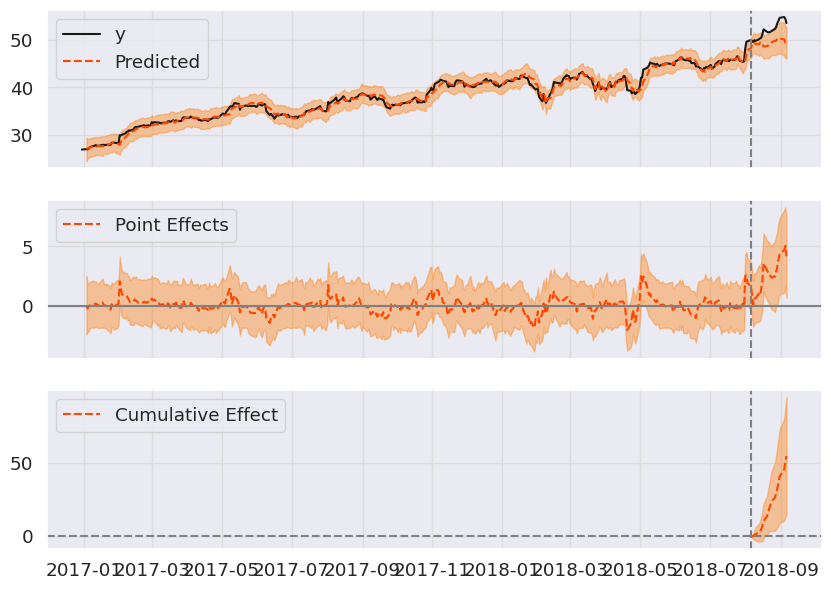

In [50]:
impact.plot()

Out of the three plots,
* `Point effects` graph is the one we are concerned about because it is basically the diffrence between the predicted stocks and the stocks having impact.

* `Cumulative effect` is the sum of cumulative effect on the stocks. But in this particular case stocks are relative so going for cumulative effect is a dumb move!

Oh Yeah! We can clearly see a deflection from the neutral axis in the `Point Effects` graph. This, implies that there was a considerable increase in the stock value of TSLA after th Elon Musk's tweet.

Okay! We have seen that there was an impact on the stock price but the main aim of us was tio measure the impact. Let's do that.

In [51]:
#summary
print(impact.summary())

Posterior Inference {Causal Impact}
                          Average            Cumulative
Actual                    51.96              1091.08
Prediction (s.d.)         49.36 (0.88)       1036.49 (18.41)
95% CI                    [47.57, 51.01]     [999.01, 1071.19]

Absolute effect (s.d.)    2.6 (0.88)         54.58 (18.41)
95% CI                    [0.95, 4.38]       [19.89, 92.06]

Relative effect (s.d.)    5.27% (1.78%)      5.27% (1.78%)
95% CI                    [1.92%, 8.88%]     [1.92%, 8.88%]

Posterior tail-area probability p: 0.0
Posterior prob. of a causal effect: 99.9%

For more details run the command: print(impact.summary('report'))


But, again, we are concerened about the `Average` values only not the `Cumulative` values.

The impact effect is 2.86 with a 95% interval of \[1.14, 4.6].

For the better understanding of the above summary we an refer to the below cell.

In [52]:
print(impact.summary('report'))

Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 51.96. By contrast, in the absence of an
intervention, we would have expected an average response of 49.36.
The 95% interval of this counterfactual prediction is [47.57, 51.01].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is 2.6 with a 95% interval of
[0.95, 4.38]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 1091.08.
By contrast, had the intervention not taken place, we would have expected
a sum of 1036.49. The 95% interval of this prediction is [999.01, 1071.19].


The above results are given in terms of absolute numbers. In relative
terms, the response variabl

Okay! Now, let's move to the most interesting part of the anlysis, `The Forecasting`.

## Forecating the future stocks.

To forecast ar preidct the future stocks we can make use of the models like,
* RandomForestRegressor
* Facebook Prophet

We are goint to use facebook prophet because it can give us more insight about the different seaonality anlysis an also can work on cross validation part.

The data we can use for the forecasting is from the datframes we are having in the dictionary `all_dfs`.

But, let's make this anlysis a bit more productive. By adding a column which reprsents the christmas date can make our anlysis more detailed.

In [53]:
date = '12-25'  #Christmas date

for sector, df in all_dfs.items():
  exist = all(date in df.index.strftime('%m-%d') for year in range(2015, 2023))
  if exist:
    print(f"{date} exists in all years in {sector} sector")
  else:
    print(f"Oops! {date} does not exist in all years in {sector} sector")


Oops! 12-25 does not exist in all years in tech sector
Oops! 12-25 does not exist in all years in finance sector
Oops! 12-25 does not exist in all years in retail sector
Oops! 12-25 does not exist in all years in health sector
Oops! 12-25 does not exist in all years in autom sector


Unfortunately, we are not having data from the christmas dates. So, we cannot have the insight about this particular anlysis.

So, let's continue without any holiday or christmas analysis using facebook prophet

In [54]:
for sector, df in all_dfs.items():
  print(df.info())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2014 entries, 2015-01-02 to 2022-12-30
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   (AAPL, Adj Close)        2014 non-null   float64
 1   (AAPL, Lagged_Returns)   2014 non-null   float64
 2   (MSFT, Adj Close)        2014 non-null   float64
 3   (MSFT, Lagged_Returns)   2014 non-null   float64
 4   (AMZN, Adj Close)        2014 non-null   float64
 5   (AMZN, Lagged_Returns)   2014 non-null   float64
 6   (GOOGL, Adj Close)       2014 non-null   float64
 7   (GOOGL, Lagged_Returns)  2014 non-null   float64
 8   (META, Adj Close)        2014 non-null   float64
 9   (META, Lagged_Returns)   2014 non-null   float64
 10  (NVDA, Adj Close)        2014 non-null   float64
 11  (NVDA, Lagged_Returns)   2014 non-null   float64
 12  (NFLX, Adj Close)        2014 non-null   float64
 13  (NFLX, Lagged_Returns)   2014 non-null   float64
dtypes: flo

let's do one more thing let's remove the lagged_returns column.

In [55]:
for sector, df in all_dfs.items():
    df = df.drop('Lagged_Returns', axis=1, level=1)  # Drop the 'Lagged_Returns' column
    all_dfs[sector] = df


In [56]:
all_dfs["tech"].head()

,AAPL,MSFT,AMZN,GOOGL,META,NVDA,NFLX
,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close,Adj Close
Date,,,,,,,
2015-01-02,24.531765,40.620659,15.4260,26.477501,78.449997,4.833627,49.848572
2015-01-05,23.840666,40.247135,15.1095,25.973000,77.190002,4.751987,47.311428
2015-01-06,23.842911,39.656403,14.7645,25.332001,76.150002,4.607913,46.501431
2015-01-07,24.177242,40.160248,14.9210,25.257500,76.150002,4.595908,46.742859
2015-01-08,25.106182,41.341702,15.0230,25.345501,78.180000,4.768796,47.779999


Lets first check for one of the stock and finetune the parmeters.

In [57]:
df_temp = all_dfs['tech'][['AAPL']]
df_temp.columns = df_temp.columns.droplevel(1)

In [58]:
df_temp.head()

,AAPL
Date,
2015-01-02,24.531765
2015-01-05,23.840666
2015-01-06,23.842911
2015-01-07,24.177242
2015-01-08,25.106182


Rename columns as `ds` and `y`

In [59]:
df_temp = df_temp.rename_axis('ds').reset_index()
df_temp = df_temp.rename(columns={'AAPL': 'y'})
df_temp.head()

,ds,y
0,2015-01-02,24.531765
1,2015-01-05,23.840666
2,2015-01-06,23.842911
3,2015-01-07,24.177242
4,2015-01-08,25.106182


splitting the train test data

In [60]:
#Training and Test Split
test_days = 31
training = df_temp.iloc[:-test_days, : ]
test = df_temp.iloc[-test_days:, : ]
print(test.head(1))
print(training.tail(1))

             ds           y
1983 2022-11-16  148.357956
             ds           y
1982 2022-11-15  149.604324


In [61]:
#Prophet Model
m = Prophet(growth = 'linear',
            yearly_seasonality = True,
            weekly_seasonality = True,
            daily_seasonality = False,
            seasonality_mode = 'additive',
            seasonality_prior_scale = 10,
            changepoint_prior_scale= 0.05)
m.fit(training)

DEBUG:cmdstanpy:input tempfile: /tmp/tmpstszbeip/j01u5n4g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpstszbeip/7fva0kfd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60484', 'data', 'file=/tmp/tmpstszbeip/j01u5n4g.json', 'init=/tmp/tmpstszbeip/7fva0kfd.json', 'output', 'file=/tmp/tmpstszbeip/prophet_modelciux0qb4/prophet_model-20230630184236.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:42:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:42:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [62]:
#create future dataframe
future = m.make_future_dataframe(periods = test_days,
                                 freq = 'D')

future

,ds
0,2015-01-02
1,2015-01-05
2,2015-01-06
3,2015-01-07
4,2015-01-08
...,...
2009,2022-12-12
2010,2022-12-13
2011,2022-12-14
2012,2022-12-15


In [63]:
#forecasting
forecast = m.predict(future)
print(forecast.columns)
forecast.head()

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'weekly', 'weekly_lower', 'weekly_upper', 'yearly', 'yearly_lower',
       'yearly_upper', 'multiplicative_terms', 'multiplicative_terms_lower',
       'multiplicative_terms_upper', 'yhat'],
      dtype='object')


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2015-01-02,28.226237,24.424830,41.474812,28.226237,28.226237,4.676480,4.676480,4.676480,0.616745,0.616745,0.616745,4.059735,4.059735,4.059735,0.0,0.0,0.0,32.902717
1,2015-01-05,28.188202,24.397245,41.555161,28.188202,28.188202,4.496302,4.496302,4.496302,0.817158,0.817158,0.817158,3.679144,3.679144,3.679144,0.0,0.0,0.0,32.684503
2,2015-01-06,28.175523,23.802468,41.494500,28.175523,28.175523,4.362536,4.362536,4.362536,0.832150,0.832150,0.832150,3.530386,3.530386,3.530386,0.0,0.0,0.0,32.538059
3,2015-01-07,28.162845,23.240747,41.628778,28.162845,28.162845,4.256025,4.256025,4.256025,0.882236,0.882236,0.882236,3.373789,3.373789,3.373789,0.0,0.0,0.0,32.418870
4,2015-01-08,28.150166,23.474924,40.973236,28.150166,28.150166,3.949933,3.949933,3.949933,0.738337,0.738337,0.738337,3.211596,3.211596,3.211596,0.0,0.0,0.0,32.100099


In [64]:
#Retrieve the predictions
predictions = forecast.yhat[-test_days:]

In [65]:
#Accuracy assessment
print(mean_absolute_error(test.y, predictions))
print(np.sqrt(mean_squared_error(test.y, predictions)))

23.062141961415364
24.854617429995237


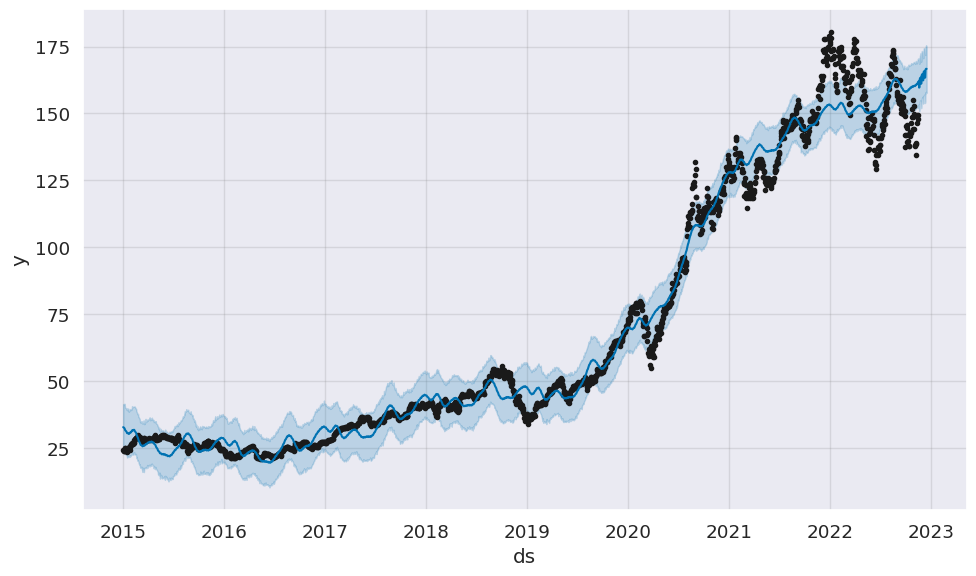

In [66]:
#Visualize the forecast
m.plot(forecast);

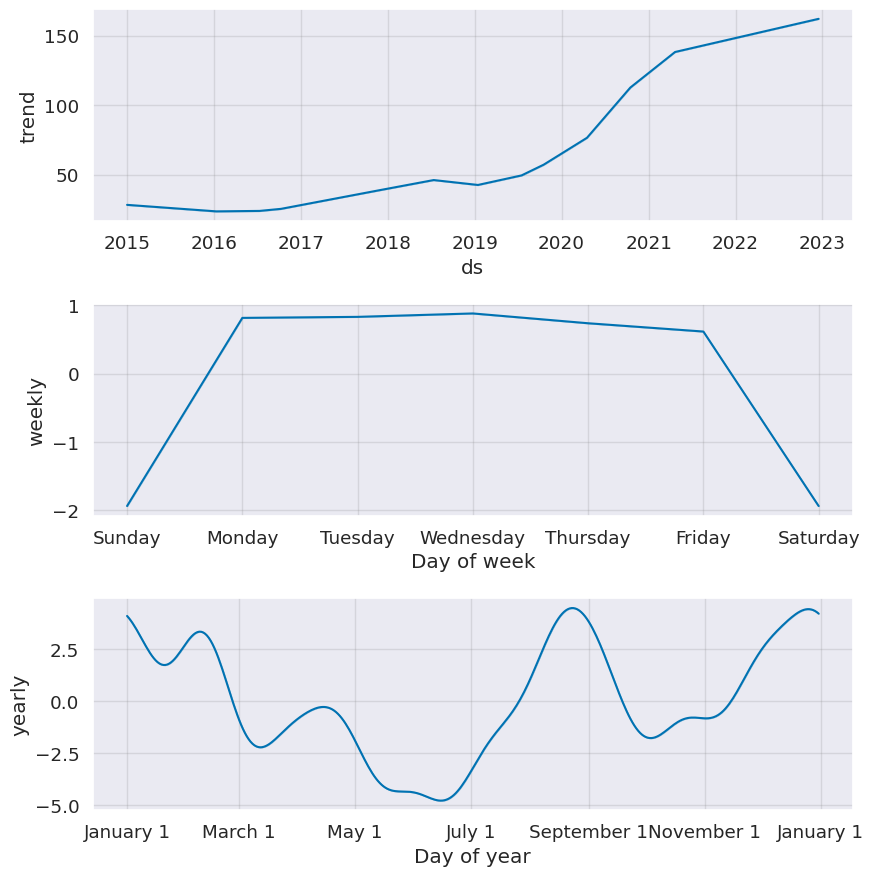

In [67]:
#plot components -> Structural Time Series decomposition
m.plot_components(forecast);

We are not having the data from saturday an sunday. So, the resutant plot is of that structure.

By considering the yearly plot it looks like the parametrs are not perfect for this anlaysis. We have to fine tune them.

In [ ]:
#CV
df_cv = cross_validation(m,
                         horizon = '31 days',
                         initial = '1450 days',
                         parallel = 'processes')

In [69]:
#Output of the CV
df_cv.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2019-01-07,45.839911,43.023716,48.333128,35.590973,2019-01-04 12:00:00
1,2019-01-08,46.122780,43.331372,48.876706,36.269440,2019-01-04 12:00:00
2,2019-01-09,46.228393,43.386417,49.116018,36.885357,2019-01-04 12:00:00
3,2019-01-10,46.312031,43.367363,49.168469,37.003242,2019-01-04 12:00:00
4,2019-01-11,46.362199,43.641666,49.084338,36.639957,2019-01-04 12:00:00


In [70]:
#Error assessment
print(mean_absolute_error(df_cv['y'], df_cv['yhat']))
print(np.sqrt(mean_squared_error(df_cv['y'], df_cv['yhat'])))

9.597689588004792
12.278773495995729


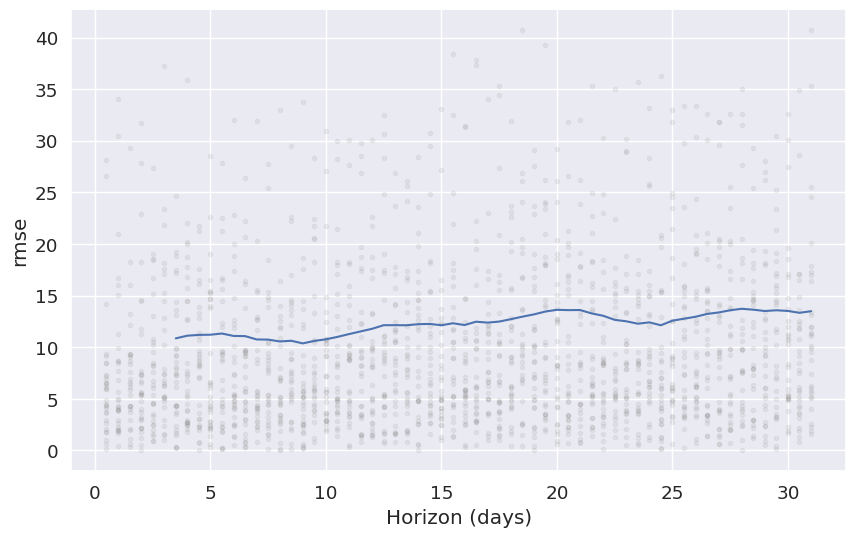

In [71]:
#CV Visualization
plot_cross_validation_metric(df_cv,
                             metric = 'rmse');

In [72]:
#Parameter Grid
param_grid = {'seasonality_mode': ['additive', 'multiplicative'],
              'seasonality_prior_scale': [5, 10, 20],
              'changepoint_prior_scale': [0.01, 0.05, 0.1]}
grid = ParameterGrid(param_grid)
len(list(grid))

18

In [ ]:
#Empty list to store results
rmse = []
#start the loop
for params in grid:
  #build the model
  m = Prophet(growth = 'linear',
            yearly_seasonality = True,
            weekly_seasonality = True,
            daily_seasonality = False,
            seasonality_mode = params['seasonality_mode'],
            seasonality_prior_scale = params['seasonality_prior_scale'],
            changepoint_prior_scale= params['changepoint_prior_scale'])
  m.fit(training)

  #Cross-Validation
  df_cv = cross_validation(m,
                           horizon = '31 days',
                           initial = '1450 days',
                           parallel = 'processes')

  #Measure and store results
  error = np.sqrt(mean_squared_error(df_cv['y'], df_cv['yhat']))
  rmse.append(error)

In [74]:
#Get the best parameters
tuning_results = pd.DataFrame(grid)
tuning_results['rmse'] = rmse
tuning_results

,changepoint_prior_scale,seasonality_mode,seasonality_prior_scale,rmse
0,0.01,additive,5,13.618499
1,0.01,additive,10,13.641209
2,0.01,additive,20,13.628778
3,0.01,multiplicative,5,12.990169
4,0.01,multiplicative,10,12.998016
5,0.01,multiplicative,20,12.873079
6,0.05,additive,5,12.254259
7,0.05,additive,10,12.278773
8,0.05,additive,20,12.255392
9,0.05,multiplicative,5,12.612741


In [75]:
best_params = grid[np.argmin(rmse)]
print(best_params)

{'seasonality_prior_scale': 10, 'seasonality_mode': 'additive', 'changepoint_prior_scale': 0.1}


So, these are teh best parameters for forecating teh stocks values.

Now, let's forecast the stock values of each stock after 2023.

In [ ]:
# Dictionary to store forecast results
forecast_results = {}

for sector, df in all_dfs.items():
    # Iterate over each ticker
    for ticker in df.columns:
        if ticker != 'Date':
            temp_df = all_dfs[sector][[ticker]].reset_index()  # Select the ticker column and reset the index
            temp_df.columns = ['ds', 'y']  # Rename the columns to 'ds' and 'y'

            ticker_train = temp_df


            test_days = 365

            model = Prophet(growth='linear',
                            yearly_seasonality=True,
                            weekly_seasonality=True,
                            daily_seasonality=False,
                            seasonality_mode='additive',
                            seasonality_prior_scale=10,
                            changepoint_prior_scale=0.1)
            model.fit(ticker_train)

            future = model.make_future_dataframe(periods=test_days, freq='D')
            forecast = model.predict(future)

            # Retrieve the predictions
            predictions = forecast.yhat[-test_days:]

            # Store the forecast results in the dictionary
            forecast_results[(sector, ticker)] = forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


In [77]:
# Print the forecast results
for (sector, ticker), results in forecast_results.items():
    print(f"Forecast for {sector} - Ticker: {ticker}")
    print("--------------------------------------------------")
    print("Date         Forecast   Lower Bound   Upper Bound")
    print("--------------------------------------------------")
    for _, row in results.iterrows():
        date = row['ds'].strftime('%Y-%m-%d')
        forecast_value = round(row['yhat'], 2)
        lower_bound = round(row['yhat_lower'], 2)
        upper_bound = round(row['yhat_upper'], 2)
        print(f"{date}   {forecast_value}    {lower_bound}       {upper_bound}")
    print()


Forecast for tech - Ticker: ('AAPL', 'Adj Close')
--------------------------------------------------
Date         Forecast   Lower Bound   Upper Bound
--------------------------------------------------
2023-12-26   165.0    145.65       185.8
2023-12-27   165.18    144.9       186.46
2023-12-28   165.21    145.45       186.51
2023-12-29   165.23    144.75       185.33
2023-12-30   164.79    145.08       185.23

Forecast for tech - Ticker: ('MSFT', 'Adj Close')
--------------------------------------------------
Date         Forecast   Lower Bound   Upper Bound
--------------------------------------------------
2023-12-26   234.18    186.96       286.14
2023-12-27   234.37    183.68       284.61
2023-12-28   234.22    184.93       286.16
2023-12-29   234.12    179.96       286.84
2023-12-30   235.92    184.93       286.96

Forecast for tech - Ticker: ('AMZN', 'Adj Close')
--------------------------------------------------
Date         Forecast   Lower Bound   Upper Bound
----------------

Forecast values are the actual predicted prices of each stock. Lowerbound and Upperbound represnts the the difference the actual price can have from the forcasted price.

So, this is the Data Analysis of the Stocks from different sectors. We have seen quite a lot insights from the various attributes and anlysis.